# World Data League 2021
## Notebook Template

This notebook is one of the mandatory deliverables when you submit your solution (alongside the video pitch). Its structure follows the WDL evaluation criteria and it has dedicated cells where you can add descriptions. Make sure your code is readable as it will be the only technical support the jury will have to evaluate your work.

The notebook must:

*   💻 have all the code that you want the jury to evaluate
*   🧱 follow the predefined structure
*   📄 have markdown descriptions where you find necessary
*   👀 be saved with all the output that you want the jury to see
*   🏃‍♂️ be runnable


## **Introduction**

For Stage 2, Data Chics chose the challenge "Predicting traffic flow in a city using induction loop sensors". 

As a first step we do an exploratory analysis of the data, plotting the sensors in order to see its distributions. After, we explore in depth the data and remove outliers. 

In order to forecast traffic intensity we make a clustering process to get group of sensors with a similar behaviour regarding traffic intensity. Subsequently, a forecast for the intensity is done using the time series but other variables that we think might affect the predictin as well (temperature, precipitaction, covid incidence...). 

Finally, we look for relations between points of interest (POI) and traffic intensity.


**Note**: For computational restrictions wee have saved intermidiate steps in csv or pickle files to be able to read them at later points without having to execute the whole notebook.

Files with extra information used throughout the notebook and also intermediate steps that have been saved in files (so we don't have to execute the whole notebook each time) can be found in the following repository: 
https://github.com/MariaJavierre/WDL

Some files haven't been included because they were too big to upload to Github.


## Development
Start coding here! 🐱‍🏍

Don't hesitate to create markdown cells to include descriptions of your work where you see fit, as well as commenting your code.

We know that you know exactly where to start when it comes to crunching data and building models, but don't forget that WDL is all about social impact...so take that into consideration as well.

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **Imports**


In [ ]:
import pandas as pd
import numpy as np
import plotly.express as px
import plotly.express as px
from sklearn.preprocessing import MinMaxScaler
import matplotlib.pyplot as plt
import tensorflow as tf
import os
import pickle

#Forecasting
from statsmodels.tsa.vector_ar.var_model import VAR
from statsmodels.tsa.statespace.sarimax import SARIMAX
import statsmodels.api as sm

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



Some parts of our analysis rely on R-based packages. We will import R capabilities via the following functions:

In [ ]:
#To be able to use R inside Jupyter
!pip3 install rpy2
%load_ext rpy2.ipython
# Use %%R in each cell to run R code

# **Reading files**

We have been provided with multiple sources of information. Our first step is to make them accessible by reading the files. We have included a COVID evolution dataset for Porto region and one administrative level above.


We have been provided with multiple sources of information. Our first step is to make them accessible by reading the files. We have included a COVID evolution dataset for Porto region and one administrative level above.

In [ ]:
#Trafic flow intensities data
traffic_2018 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2018.csv", encoding='latin-1')
traffic_2019 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2019.csv", encoding='latin-1')
traffic_2020 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2020.csv", encoding='latin-1')
traffic_2021 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2021.csv", encoding='latin-1')

In [ ]:
#Weather data
weather_2018 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/weather_observed/weather_observed_2018.csv', encoding='latin-1')
weather_2019 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/weather_observed/weather_observed_2019.csv', encoding='latin-1')
weather_2020 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/weather_observed/weather_observed_2020.csv', encoding='latin-1')
weather_2021 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/weather_observed/weather_observed_2021.csv', encoding='latin-1')

In [ ]:
#Point of interest data
POI =pd.read_json('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/POIs.json')

In [ ]:
#Sensor location data
data_entities = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/data_entities.csv', encoding='latin-1')

In [ ]:
#Covid evolution data
covid = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/covid_data/covid_arsnorte_hourly_dot.csv', encoding='latin-1', error_bad_lines=False, delimiter = ";")


# **Pre-processing: Initial field formating and data augmentation**

The goal of this section is to transform the data to facilitate analysis. We have focused on the following areas:



*   Split dates/timestamps into its components: year, month, day, weekday, hour for each year and sensor. Key element for further aggregation and analysis
*   Transform weather data and merge with traffic flow datasets

*   Transform covid data and merge with traffic flow
*   Initial exploration of sensor location and flow intensities by sensor

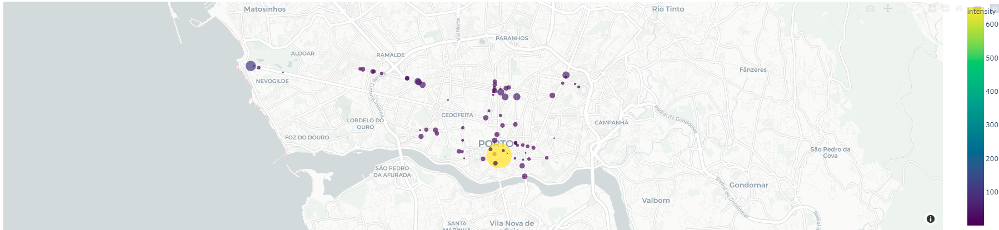






### **2021**

#### **2021 - DB formation**

As a first step, we have done some processing in order to show the location of the sensors in Porto so we could have an idea of its distribuion while also preparing a final dataframe that combines some of the available data : traffic and weather conditions over time. For simplicity, maps are shown only for the year 2021 while afterwards the pre-processing steps are done for the other available years.

In [ ]:
data_entities[data_entities == 'TrafficFlowObserved']
data_entities = data_entities.reset_index()
data_entities.head()

,level_0,index,entity_id,name,latitude,longitude,entity_type,street,start_date,end_date
0,0,0,testsixsq,Rua dos Campeões Europeus,41.162590,-8.585198,TrafficFlowObserved,Rua dos Campeões Europeus,NaN,NaN
1,1,1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,41.148406,-8.599094,TrafficFlowObserved,Rua de Fernandes Tomás,NaN,NaN
2,2,2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Camões - N-S,41.154960,-8.610091,TrafficFlowObserved,Rua de Camões,NaN,NaN
3,3,3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Boavista - Casa da Música - E-O,41.158701,-8.633546,TrafficFlowObserved,Avenida da Boavista,NaN,NaN
4,4,4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Via Panorâmica - Faixa BUS,41.151096,-8.633818,TrafficFlowObserved,Rua de Entre Campos,NaN,NaN


In [ ]:
#Transform dataframe elements to align with date format
traffic_2021['dateobservedfrom'] = pd.to_datetime(traffic_2021['dateobservedfrom'])
traffic_2021['hour'] = traffic_2021.dateobservedfrom.dt.hour
traffic_2021['day'] = traffic_2021.dateobservedfrom.dt.day
traffic_2021['month'] = traffic_2021.dateobservedfrom.dt.month
traffic_2021['year'] = traffic_2021.dateobservedfrom.dt.year
traffic_2021

,entity_id,entity_type,dateobservedfrom,dateobservedto,dataprovider,intensity,source,laneid,lanedirection,date_from,time_from,name,hour,day,month,year
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-02-15 22:20:00,2021-02-15 22:25:00,NaN,6,NaN,1,NaN,2021-02-15,22:20:00.0000000,R. Alegria,22,15,2,2021
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-02-15 22:20:00,2021-02-15 22:25:00,NaN,10,NaN,1,NaN,2021-02-15,22:20:00.0000000,R. Santa Catarina - S-N,22,15,2,2021
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-02-15 22:15:00,2021-02-15 22:20:00,NaN,9,NaN,1,NaN,2021-02-15,22:15:00.0000000,Av.Sidónio Pais O-E - Rotunda,22,15,2,2021
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-01-28 13:15:00,2021-01-28 13:20:00,NaN,12,NaN,1,NaN,2021-01-28,13:15:00.0000000,Av. Fernão Magalhães N-S - Túnel,13,28,1,2021
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-01-28 13:15:00,2021-01-28 13:20:00,NaN,14,NaN,1,NaN,2021-01-28,13:15:00.0000000,Av. Fernão de Magalhães - Francisco Sá Carneiro,13,28,1,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1778486,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 10:15:00,2021-03-19 10:20:00,NaN,22,NaN,1,NaN,2021-03-19,10:15:00.0000000,Av. Rodrigues de Freitas,10,19,3,2021
1778487,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 10:15:00,2021-03-19 10:20:00,NaN,69,NaN,1,NaN,2021-03-19,10:15:00.0000000,R. Fontainhas,10,19,3,2021
1778488,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 10:10:00,2021-03-19 10:15:00,NaN,18,NaN,1,NaN,2021-03-19,10:10:00.0000000,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021
1778489,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 10:10:00,2021-03-19 10:15:00,NaN,19,NaN,1,NaN,2021-03-19,10:10:00.0000000,R. Antero Quental - Constituição - S-N,10,19,3,2021


In [ ]:
#Aggregate instances by hour, to facilitate analysis
traffic_2021_aggr = traffic_2021.groupby(by=["entity_id", "name", "laneid", "year", "month", "day", "hour" ]).intensity.sum().reset_index()
traffic_2021_aggr = traffic_2021_aggr.merge(data_entities[data_entities['entity_type'] =='TrafficFlowObserved' ], on = 'entity_id', how = 'left')
#traffic_2021_aggr['entity_id'] = traffic_2021_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:','')
traffic_2021_aggr['date'] = pd.to_datetime(traffic_2021_aggr[['year', 'month', 'day', 'hour']])
traffic_2021_aggr = traffic_2021_aggr.drop(['year', 'month', 'day', 'hour'], axis = 1)
traffic_2021_aggr = traffic_2021_aggr[['entity_id', 'name_x', 'laneid','intensity','date','latitude','longitude']] 
traffic_2021_aggr.head()

,entity_id,name_x,laneid,intensity,date,latitude,longitude
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,20,2020-12-31 00:00:00,41.148406,-8.599094
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,8,2020-12-31 01:00:00,41.148406,-8.599094
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,4,2020-12-31 02:00:00,41.148406,-8.599094
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,4,2020-12-31 03:00:00,41.148406,-8.599094
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,5,2020-12-31 04:00:00,41.148406,-8.599094


#### **2021 - Weather**

In [ ]:
#Incorporate weather data for the same year
w2021 = weather_2021.merge(data_entities[data_entities['entity_type'] =='WeatherObserved' ], on = 'entity_id', how = 'left')
w2021['dateobserved'] = pd.to_datetime(w2021['dateobserved'])
w2021['dateobserved'] = w2021.dateobserved.apply(lambda x: pd.datetime(x.year, x.month, x.day, x.hour, (x.minute//5)*5, 0))
w2021 = w2021[['dateobserved','latitude',	'longitude','name_x', 'precipitation', 'temperature', 'winddirection','windspeed']]
w2021['hora'] = w2021.dateobserved.dt.hour
w2021['d'] = w2021.dateobserved.dt.date
w2021 = w2021.drop_duplicates(subset=['latitude','longitude','d','hora'], keep="first")
w2021['hour'] = w2021.dateobserved.dt.hour
w2021['day'] = w2021.dateobserved.dt.day
w2021['month'] = w2021.dateobserved.dt.month
w2021['year'] = w2021.dateobserved.dt.year
w2021['date'] = pd.to_datetime(w2021[['year', 'month', 'day', 'hour']])
w2021 = w2021.drop(['year', 'month', 'day', 'hour','d','dateobserved','hora'], axis = 1)
w2021.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:4: FutureWarning:

The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.



,latitude,longitude,name_x,precipitation,temperature,winddirection,windspeed,date
0,41.173434,-8.688219,Anémona,0.0,8.7,0,0.000000,2021-01-01 19:00:00
2,41.180222,-8.605194,Pólo Asprela,0.0,6.7,308,0.888889,2021-01-01 19:00:00
3,41.162596,-8.590796,Av. Fernão de Magalhães,0.0,6.7,323,0.916667,2021-01-01 19:00:00
5,41.171862,-8.613186,Arca de Água,0.0,6.0,339,0.555556,2021-01-01 19:00:00
6,41.183769,-8.603107,Hospital S.João,0.0,6.8,10,0.194444,2021-01-01 19:00:00


Weather sensors are fewer in number and they are not located at the same place as traffic sensors. With the following step we extract the nearest weather sensor for each traffic sensor and assign the values fo said weather sensor to the traffic one.

In [ ]:
ch = w2021.groupby(['latitude','longitude']).count().reset_index()[['latitude','longitude']]

minimos = []
all_items = []

for real_item in traffic_2021_aggr[['latitude', 'longitude']].to_numpy():
  min = 10
  for item in ch.to_numpy():
    a = (item - real_item) ** 2
    b = (a[0] + a[1]) ** (1/2)
    new_min = b
    if min > new_min:
      min = new_min
      i = item
  minimos.append(min)
  all_items.append(i)

all_items
latitude = [item[0] for item in all_items]
longitude = [item[1] for item in all_items]

In [ ]:
traffic_2021_aggr['near_latitude'] = np.array(latitude)
traffic_2021_aggr['near_longitude'] = np.array(longitude)

traffic_2021_aggr = traffic_2021_aggr.merge(w2021, left_on = ['near_latitude','near_longitude','date'],right_on = ['latitude','longitude','date'], how = 'left')
traffic_2021_aggr = traffic_2021_aggr[['entity_id','name_x_x','laneid','intensity','date','latitude_x',	'longitude_x',	'precipitation',	'temperature',	'winddirection',	'windspeed']]
traffic_2021_aggr.head()

traffic_2021_aggr['date'] = traffic_2021_aggr['date'].apply(str)

The process to create traffic_2021_aggr dataframe will be reapeted in order to build the respective datasets for 2018, 2019 and 2020

### **2020**



#### **2020 - BD formation**

In [ ]:
#Transform dataframe elements to align with date format
traffic_2020['dateobservedfrom'] = pd.to_datetime(traffic_2020['dateobservedfrom'])
traffic_2020['hour'] = traffic_2020.dateobservedfrom.dt.hour
traffic_2020['day'] = traffic_2020.dateobservedfrom.dt.day
traffic_2020['month'] = traffic_2020.dateobservedfrom.dt.month
traffic_2020['year'] = traffic_2020.dateobservedfrom.dt.year

In [ ]:
#Aggregate instances by hour, to facilitate analysis
traffic_2020_aggr = traffic_2020.groupby(by=["entity_id", "name", "laneid", "year", "month", "day", "hour" ]).intensity.sum().reset_index()
traffic_2020_aggr = traffic_2020_aggr.merge(data_entities[data_entities['entity_type'] =='TrafficFlowObserved' ], on = 'entity_id', how = 'left')
#traffic_2020_aggr['entity_id'] = traffic_2020_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:','')
traffic_2020_aggr['date'] = pd.to_datetime(traffic_2020_aggr[['year', 'month', 'day', 'hour']])
traffic_2020_aggr = traffic_2020_aggr.drop(['year', 'month', 'day', 'hour'], axis = 1)
traffic_2020_aggr = traffic_2020_aggr[['entity_id', 'name_x', 'laneid','intensity','date','latitude','longitude']] 
traffic_2020_aggr.head()

,entity_id,name_x,laneid,intensity,date,latitude,longitude
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,4,2020-05-10 23:00:00,41.148406,-8.599094
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,149,2020-05-11 18:00:00,41.148406,-8.599094
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,147,2020-05-11 19:00:00,41.148406,-8.599094
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,101,2020-05-11 20:00:00,41.148406,-8.599094
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,61,2020-05-11 21:00:00,41.148406,-8.599094


#### **2020 - Weather**

In [ ]:
w2020 = weather_2020.merge(data_entities[data_entities['entity_type'] =='WeatherObserved' ], on = 'entity_id', how = 'left')
w2020['dateobserved'] = pd.to_datetime(w2020['dateobserved'])
w2020['dateobserved'] = w2020.dateobserved.apply(lambda x: pd.datetime(x.year, x.month, x.day, x.hour, (x.minute//5)*5, 0))
w2020 = w2020[['dateobserved','latitude',	'longitude','name_x', 'precipitation', 'temperature', 'winddirection','windspeed']]
w2020['hora'] = w2020.dateobserved.dt.hour
w2020['d'] = w2020.dateobserved.dt.date
w2020 = w2020.drop_duplicates(subset=['latitude','longitude','d','hora'], keep="first")
w2020['hour'] = w2020.dateobserved.dt.hour
w2020['day'] = w2020.dateobserved.dt.day
w2020['month'] = w2020.dateobserved.dt.month
w2020['year'] = w2020.dateobserved.dt.year
w2020['date'] = pd.to_datetime(w2020[['year', 'month', 'day', 'hour']])
w2020 = w2020.drop(['year', 'month', 'day', 'hour','d','dateobserved','hora'], axis = 1)
w2020.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning:

The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.



,latitude,longitude,name_x,precipitation,temperature,winddirection,windspeed,date
0,41.162596,-8.590796,Av. Fernão de Magalhães,0.0,15.200000,112.0,1.888889,2020-04-15 10:00:00
1,41.148427,-8.598082,Campo 24 de Agosto,0.0,18.000000,315.0,1.944444,2020-04-18 16:00:00
2,41.180222,-8.605194,Pólo Asprela,0.0,18.299999,283.0,2.166667,2020-04-18 16:00:00
3,41.161724,-8.603915,Marquês,0.0,13.600000,179.0,2.000000,2020-04-17 09:00:00
4,41.180222,-8.605194,Pólo Asprela,0.0,13.600000,146.0,2.805556,2020-04-17 09:00:00


In [ ]:
ch = w2020.groupby(['latitude','longitude']).count().reset_index()[['latitude','longitude']]

minimos = []
all_items = []

for real_item in traffic_2020_aggr[['latitude', 'longitude']].to_numpy():
  min = 10
  for item in ch.to_numpy():
    a = (item - real_item) ** 2
    b = (a[0] + a[1]) ** (1/2)
    new_min = b
    if min > new_min:
      min = new_min
      i = item
  minimos.append(min)
  all_items.append(i)

all_items
latitude = [item[0] for item in all_items]
longitude = [item[1] for item in all_items]

In [ ]:
traffic_2020_aggr['near_latitude'] = np.array(latitude)
traffic_2020_aggr['near_longitude'] = np.array(longitude)

traffic_2020_aggr = traffic_2020_aggr.merge(w2020, left_on = ['near_latitude','near_longitude','date'],right_on = ['latitude','longitude','date'], how = 'left')
traffic_2020_aggr = traffic_2020_aggr[['entity_id','name_x_x','laneid','intensity','date','latitude_x',	'longitude_x',	'precipitation',	'temperature',	'winddirection',	'windspeed']]
traffic_2020_aggr.head()

traffic_2020_aggr['date'] = traffic_2020_aggr['date'].apply(str)

### **2019**




#### **2019 - DB Configuration**

In [ ]:
#Transform dataframe elements to align with date format
traffic_2019['dateobservedfrom'] = pd.to_datetime(traffic_2019['dateobservedfrom'])
traffic_2019['hour'] = traffic_2019.dateobservedfrom.dt.hour
traffic_2019['day'] = traffic_2019.dateobservedfrom.dt.day
traffic_2019['month'] = traffic_2019.dateobservedfrom.dt.month
traffic_2019['year'] = traffic_2019.dateobservedfrom.dt.year

In [ ]:
#Aggregate instances by hour, to facilitate analysis
traffic_2019_aggr = traffic_2019.groupby(by=["entity_id", "name", "laneid", "year", "month", "day", "hour" ]).intensity.sum().reset_index()
traffic_2019_aggr = traffic_2019_aggr.merge(data_entities[data_entities['entity_type'] =='TrafficFlowObserved' ], on = 'entity_id', how = 'left')
#traffic_2019_aggr['entity_id'] = traffic_2019_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:','')
traffic_2019_aggr['date'] = pd.to_datetime(traffic_2019_aggr[['year', 'month', 'day', 'hour']])
traffic_2019_aggr = traffic_2019_aggr.drop(['year', 'month', 'day', 'hour'], axis = 1)
traffic_2019_aggr = traffic_2019_aggr[['entity_id', 'name_x', 'laneid','intensity','date','latitude','longitude']] 
traffic_2019_aggr.head()

,entity_id,name_x,laneid,intensity,date,latitude,longitude
0,testsixsq,Rua dos Campeões Europeus,1,26,2019-06-14 12:00:00,41.162590,-8.585198
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,919,2019-01-02 11:00:00,41.148406,-8.599094
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,941,2019-01-02 13:00:00,41.148406,-8.599094
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,2086,2019-01-02 15:00:00,41.148406,-8.599094
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,1,2019-01-04 16:00:00,41.148406,-8.599094


#### **2019 - Weather**

In [ ]:
w2019 = weather_2019.merge(data_entities[data_entities['entity_type'] =='WeatherObserved' ], on = 'entity_id', how = 'left')
w2019['dateobserved'] = pd.to_datetime(w2019['dateobserved'])
w2019['dateobserved'] = w2019.dateobserved.apply(lambda x: pd.datetime(x.year, x.month, x.day, x.hour, (x.minute//5)*5, 0))
w2019 = w2019[['dateobserved','latitude',	'longitude','name_x', 'precipitation', 'temperature', 'winddirection','windspeed']]
w2019['hora'] = w2019.dateobserved.dt.hour
w2019['d'] = w2019.dateobserved.dt.date
w2019 = w2019.drop_duplicates(subset=['latitude','longitude','d','hora'], keep="first")
w2019['hour'] = w2019.dateobserved.dt.hour
w2019['day'] = w2019.dateobserved.dt.day
w2019['month'] = w2019.dateobserved.dt.month
w2019['year'] = w2019.dateobserved.dt.year
w2019['date'] = pd.to_datetime(w2019[['year', 'month', 'day', 'hour']])
w2019 = w2019.drop(['year', 'month', 'day', 'hour','d','dateobserved','hora'], axis = 1)
w2019.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning:

The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.



,latitude,longitude,name_x,precipitation,temperature,winddirection,windspeed,date
0,41.161724,-8.603915,Marquês,0.0,11.5,86.0,0.472222,2019-12-06 01:00:00
2,41.173434,-8.688219,Anémona,0.0,12.2,124.0,0.777778,2019-12-06 01:00:00
3,41.162596,-8.590796,Av. Fernão de Magalhães,0.0,11.5,125.0,0.666667,2019-12-06 01:00:00
5,41.180222,-8.605194,Pólo Asprela,0.0,12.2,94.0,1.222222,2019-12-06 01:00:00
10,41.173434,-8.688219,Anémona,0.0,14.2,162.0,5.861111,2019-12-15 00:00:00


In [ ]:
ch = w2019.groupby(['latitude','longitude']).count().reset_index()[['latitude','longitude']]

minimos = []
all_items = []

for real_item in traffic_2019_aggr[['latitude', 'longitude']].to_numpy():
  min = 10
  for item in ch.to_numpy():
    a = (item - real_item) ** 2
    b = (a[0] + a[1]) ** (1/2)
    new_min = b
    if min > new_min:
      min = new_min
      i = item
  minimos.append(min)
  all_items.append(i)

all_items
latitude = [item[0] for item in all_items]
longitude = [item[1] for item in all_items]

In [ ]:
traffic_2019_aggr['near_latitude'] = np.array(latitude)
traffic_2019_aggr['near_longitude'] = np.array(longitude)

traffic_2019_aggr = traffic_2019_aggr.merge(w2019, left_on = ['near_latitude','near_longitude','date'],right_on = ['latitude','longitude','date'], how = 'left')
traffic_2019_aggr = traffic_2019_aggr[['entity_id','name_x_x','laneid','intensity','date','latitude_x',	'longitude_x',	'precipitation',	'temperature',	'winddirection',	'windspeed']]
traffic_2019_aggr.head()

traffic_2019_aggr['date'] = traffic_2019_aggr['date'].apply(str)

### **2018**



#### **2018 - DB Configuration**

In [ ]:
#Transform dataframe elements to align with date format
traffic_2018['dateobservedfrom'] = pd.to_datetime(traffic_2018['dateobservedfrom'])
traffic_2018['hour'] = traffic_2018.dateobservedfrom.dt.hour
traffic_2018['day'] = traffic_2018.dateobservedfrom.dt.day
traffic_2018['month'] = traffic_2018.dateobservedfrom.dt.month
traffic_2018['year'] = traffic_2018.dateobservedfrom.dt.year

In [ ]:
#Aggregate instances by hour, to facilitate analysis
traffic_2018_aggr = traffic_2018.groupby(by=["entity_id", "name", "laneid", "year", "month", "day", "hour" ]).intensity.sum().reset_index()
traffic_2018_aggr = traffic_2018_aggr.merge(data_entities[data_entities['entity_type'] =='TrafficFlowObserved' ], on = 'entity_id', how = 'left')
#traffic_2018_aggr['entity_id'] = traffic_2018_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:','')
traffic_2018_aggr['date'] = pd.to_datetime(traffic_2018_aggr[['year', 'month', 'day', 'hour']])
traffic_2018_aggr = traffic_2018_aggr.drop(['year', 'month', 'day', 'hour'], axis = 1)
traffic_2018_aggr = traffic_2018_aggr[['entity_id', 'name_x', 'laneid','intensity','date','latitude','longitude']] 
traffic_2018_aggr.head()

,entity_id,name_x,laneid,intensity,date,latitude,longitude
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,224,2017-12-31 00:00:00,41.148406,-8.599094
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,186,2017-12-31 01:00:00,41.148406,-8.599094
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,177,2017-12-31 02:00:00,41.148406,-8.599094
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,138,2017-12-31 03:00:00,41.148406,-8.599094
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,75,2017-12-31 04:00:00,41.148406,-8.599094


#### **2018 - Weather**

In [ ]:
w2018 = weather_2018.merge(data_entities[data_entities['entity_type'] =='WeatherObserved' ], on = 'entity_id', how = 'left')
w2018['dateobserved'] = pd.to_datetime(w2018['dateobserved'])
w2018['dateobserved'] = w2018.dateobserved.apply(lambda x: pd.datetime(x.year, x.month, x.day, x.hour, (x.minute//5)*5, 0))
w2018 = w2018[['dateobserved','latitude',	'longitude','name_x', 'precipitation', 'temperature', 'winddirection','windspeed']]
w2018['hora'] = w2018.dateobserved.dt.hour
w2018['d'] = w2018.dateobserved.dt.date
w2018 = w2018.drop_duplicates(subset=['latitude','longitude','d','hora'], keep="first")
w2018['hour'] = w2018.dateobserved.dt.hour
w2018['day'] = w2018.dateobserved.dt.day
w2018['month'] = w2018.dateobserved.dt.month
w2018['year'] = w2018.dateobserved.dt.year
w2018['date'] = pd.to_datetime(w2018[['year', 'month', 'day', 'hour']])
w2018 = w2018.drop(['year', 'month', 'day', 'hour','d','dateobserved','hora'], axis = 1)
w2018.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:3: FutureWarning:

The pandas.datetime class is deprecated and will be removed from pandas in a future version. Import from datetime module instead.



,latitude,longitude,name_x,precipitation,temperature,winddirection,windspeed,date
0,41.183769,-8.603107,Hospital S.João,0.0,20.400000,130.0,0.472222,2018-10-23 21:00:00
1,41.161724,-8.603915,Marquês,0.0,22.799999,85.0,1.833333,2018-10-22 10:00:00
2,41.148427,-8.598082,Campo 24 de Agosto,0.0,13.600000,123.0,1.166667,2018-10-01 06:00:00
4,41.183769,-8.603107,Hospital S.João,0.0,14.200000,NaN,0.000000,2018-10-01 06:00:00
5,41.148427,-8.598082,Campo 24 de Agosto,0.0,28.000000,301.0,1.555556,2018-10-01 15:00:00


In [ ]:
ch = w2018.groupby(['latitude','longitude']).count().reset_index()[['latitude','longitude']]

minimos = []
all_items = []

for real_item in traffic_2018_aggr[['latitude', 'longitude']].to_numpy():
  min = 10
  for item in ch.to_numpy():
    a = (item - real_item) ** 2
    b = (a[0] + a[1]) ** (1/2)
    new_min = b
    if min > new_min:
      min = new_min
      i = item
  minimos.append(min)
  all_items.append(i)

all_items
latitude = [item[0] for item in all_items]
longitude = [item[1] for item in all_items]

In [ ]:
traffic_2018_aggr['near_latitude'] = np.array(latitude)
traffic_2018_aggr['near_longitude'] = np.array(longitude)

traffic_2018_aggr = traffic_2018_aggr.merge(w2018, left_on = ['near_latitude','near_longitude','date'],right_on = ['latitude','longitude','date'], how = 'left')
traffic_2018_aggr = traffic_2018_aggr[['entity_id','name_x_x','laneid','intensity','date','latitude_x',	'longitude_x',	'precipitation',	'temperature',	'winddirection',	'windspeed']]
traffic_2018_aggr.head()

traffic_2018_aggr['date'] = traffic_2018_aggr['date'].apply(str)

###**Formation of full DBs 2018-2021: Weather, traffic, Covid**

Once merged and aggregated both traffic_flow and weather dataframes by year, they will be concatenated into one full 2018-2021 dataset

#### **Weather DB**

In [ ]:
all_weather = pd.concat([w2018, w2019, w2020, w2021])

In [ ]:
all_weather.to_csv('/content/drive/MyDrive/WDL/Stage_2/weather_observed/all_weather.csv')

#### **Traffic flow merged with weather and covid**

In [ ]:
frames = [traffic_2018_aggr, traffic_2019_aggr, traffic_2020_aggr, traffic_2021_aggr]

In [ ]:
traffic_full = pd.concat(frames)
traffic_full

,entity_id,name_x_x,laneid,intensity,date,latitude_x,longitude_x,precipitation,temperature,winddirection,windspeed
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,224,2017-12-31 00:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,186,2017-12-31 01:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,177,2017-12-31 02:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,138,2017-12-31 03:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,75,2017-12-31 04:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...
183343,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,35,2021-04-09 01:00:00,41.162490,-8.611223,0.0,14.1,0.0,0.000000
183344,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,14,2021-04-09 02:00:00,41.162490,-8.611223,0.0,12.9,0.0,0.000000
183345,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,11,2021-04-09 03:00:00,41.162490,-8.611223,0.0,12.9,128.0,0.333333
183346,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,18,2021-04-09 04:00:00,41.162490,-8.611223,0.0,12.2,166.0,0.555556


Covid_transmission_rate will be joined to the traffic_full dataframe. 

In [ ]:
covid

,data,data_dados,confirmados_arsnorte,obitos_arsnorte,nuevos_arsnorte,poblacion_arsnorte,incidencia_14_arsnorte
0,2020-02-26 00:00:00,26/02/2020 0:00,0.0,0.0,0.0,3689682.0,0
1,2020-02-27 00:00:00,27/02/2020 0:00,0.0,0.0,0.0,3689682.0,0
2,2020-02-28 00:00:00,28/02/2020 0:00,0.0,0.0,0.0,3689682.0,0
3,2020-02-29 00:00:00,29/02/2020 0:00,0.0,0.0,0.0,3689682.0,0
4,2020-03-01 00:00:00,01/03/2020 0:00,0.0,0.0,0.0,3689682.0,0
...,...,...,...,...,...,...,...
20869,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20870,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20871,NaN,NaN,NaN,NaN,NaN,NaN,NaN
20872,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
covid['data'] = covid['data'].apply(str)
traffic_full = traffic_full.merge(covid, left_on = ['date'],right_on = ['data'], how = 'left').drop(columns= ['data', 'data_dados', 'confirmados_arsnorte', 'obitos_arsnorte', 'nuevos_arsnorte', 'poblacion_arsnorte'])
traffic_full['incidencia_14_arsnorte'] = traffic_full['incidencia_14_arsnorte'].replace(np.nan, 0)
traffic_full

,entity_id,name_x_x,laneid,intensity,date,latitude_x,longitude_x,precipitation,temperature,winddirection,windspeed,incidencia_14_arsnorte
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,224,2017-12-31 00:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN,0
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,186,2017-12-31 01:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN,0
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,177,2017-12-31 02:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN,0
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,138,2017-12-31 03:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN,0
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,1,75,2017-12-31 04:00:00,41.148406,-8.599094,NaN,NaN,NaN,NaN,0
...,...,...,...,...,...,...,...,...,...,...,...,...
3182307,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,11,2021-04-09 03:00:00,41.162490,-8.611223,0.0,12.9,128.0,0.333333,"50,13982235"
3182308,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,18,2021-04-09 04:00:00,41.162490,-8.611223,0.0,12.2,166.0,0.555556,"52,7958778"
3182309,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,18,2021-04-09 04:00:00,41.162490,-8.611223,0.0,12.2,166.0,0.555556,"50,13982235"
3182310,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Antero Quental - Constituição - N-S,1,20,2021-04-09 05:00:00,41.162490,-8.611223,0.0,12.2,165.0,0.194444,"52,7958778"


### **Visualizing sensors over time**

The following interactive graphs show the location of the sensors over time. The first graph shows just the location while the second one shows the location and the variation in the intensity of the traffic.

In [ ]:
import plotly.express as px

fig = px.scatter_mapbox(traffic_2021_aggr, lat="latitude_x", lon="longitude_x", hover_name="name_x_x", hover_data=["name_x_x", "intensity"], animation_frame= 'date',
                        color_discrete_sequence=["fuchsia"], zoom=12, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [ ]:
fig = px.scatter_mapbox(traffic_2021_aggr, lat="latitude_x", lon="longitude_x", size = 'intensity', animation_frame= 'date', color="intensity",
                   color_continuous_scale=px.colors.sequential.Viridis, zoom=12,size_max=300,
                  mapbox_style="carto-positron")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

The steps up to this part have been reproduced for the following years : 2017, 2018, 2019, 2020 and 2021 in order to start with the following step : outlier removal.

# **Pre-processing: Outlier Removal**

After an exploratory assessment of traffic intensity probabilistic distributions, we have concluded that this phenomenon is governed by **long-tails**. This situation has three implications:



1.   A small number of events concentrate most of the impact. In other words, less than 20% of days-hours concentrate most of the traffic flows
2.   Any analysis leveraging 'conventional statistics' will require normalization
3. There is a high volume of outliers, as an intrinsic element of a long-tail

In the following section, we will be focusing on the third implication. The goal is to remove as many outliers as possible, to facilitate some of the incoming analyses.







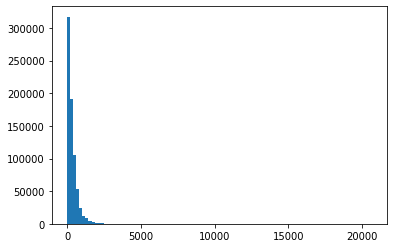

### **Why do we need this section?** 

Exploring intensities distributions

When we assess the overall distribution, we can observe that it is heavily skewed towards 0. The following distribution clearly follows a long tail as seen in the 'skd pdf' and the histogram.

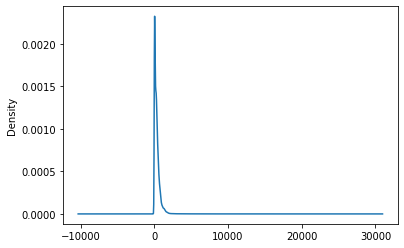

In [ ]:
#General distribution
traffic_2019_aggr['intensity'].plot(kind='kde')
plt.show()

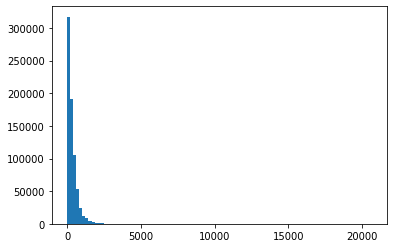

In [ ]:
#General distribution
data = traffic_2019_aggr['intensity']
plt.hist(data, bins = 100)
plt.show()

When we dive deep into street-level distributions, we observe that it still reflects the long tail but with a lower level of skewness. 

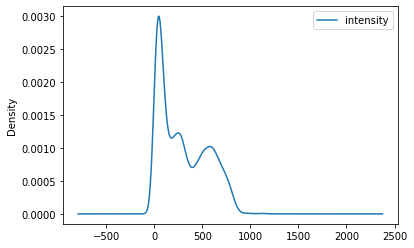

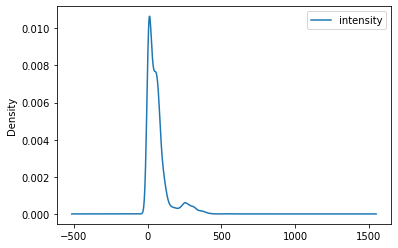

In [ ]:
#Street specific distributions
a = traffic_2019_aggr[traffic_2019_aggr['name_x_x'] =='Av. Sidónio Pais - Câmara'][['intensity']].plot(kind='kde')
b = traffic_2019_aggr[traffic_2019_aggr['name_x_x'] =='Av. Boavista - Casa da Música - E-O'][['intensity']].plot(kind='kde')
plt.legend()
plt.show()


Next, we will proceed with removing outliers to facilitate analysis.

### **2021**

We have included the following two steps, despite redundancy, to ease computational load. RAM memory in Colab is limited. This section can be fully executed without any dependency to prior steps.

In [ ]:
#Easing computational load
traffic_2021 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2021.csv", encoding='latin-1')

In [ ]:
#Easing computational load
traffic_2021['dateobservedfrom'] = pd.to_datetime(traffic_2021['dateobservedfrom'])
traffic_2021['hour'] = traffic_2021.dateobservedfrom.dt.hour
traffic_2021['day'] = traffic_2021.dateobservedfrom.dt.day
traffic_2021['month'] = traffic_2021.dateobservedfrom.dt.month
traffic_2021['year'] = traffic_2021.dateobservedfrom.dt.year
traffic_2021_aggr = traffic_2021.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.agg(['sum', 'mean', 'median', 'min', 'max', 'std', 'count']).reset_index()
traffic_2021_quantile95 = traffic_2021.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.quantile(q=0.95).reset_index()
traffic_2021_aggr['entity_id'] = traffic_2021_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
traffic_2021_aggr['date'] = pd.to_datetime(traffic_2021_aggr[['year', 'month', 'day']])
traffic_2021_aggr = traffic_2021_aggr.drop(['year', 'month', 'day'], axis = 1)
traffic_2021_aggr

,entity_id,laneid,hour,name,sum,mean,median,min,max,std,count,date
0,CT10Z2,1,0,R. Fernandes Tomás - 24 de Agosto,20,6.666667,7.0,5,8,1.527525,3,2020-12-31
1,CT10Z2,1,1,R. Fernandes Tomás - 24 de Agosto,8,2.666667,2.0,2,4,1.154701,3,2020-12-31
2,CT10Z2,1,2,R. Fernandes Tomás - 24 de Agosto,4,2.000000,2.0,2,2,0.000000,2,2020-12-31
3,CT10Z2,1,3,R. Fernandes Tomás - 24 de Agosto,4,2.000000,2.0,2,2,0.000000,2,2020-12-31
4,CT10Z2,1,4,R. Fernandes Tomás - 24 de Agosto,5,1.250000,1.0,1,2,0.500000,4,2020-12-31
...,...,...,...,...,...,...,...,...,...,...,...,...
183343,CT9Z9,1,1,R. Antero Quental - Constituição - N-S,35,2.916667,3.0,1,4,1.083625,12,2021-04-09
183344,CT9Z9,1,2,R. Antero Quental - Constituição - N-S,14,2.000000,2.0,1,3,0.816497,7,2021-04-09
183345,CT9Z9,1,3,R. Antero Quental - Constituição - N-S,11,1.833333,1.5,1,4,1.169045,6,2021-04-09
183346,CT9Z9,1,4,R. Antero Quental - Constituição - N-S,18,1.800000,2.0,1,4,0.918937,10,2021-04-09


In [ ]:
#Merging traffic_2021_quantile95 to initail DB
corrected_traffic_2021 = pd.merge(traffic_2021, traffic_2021_quantile95, how='left', on=["entity_id", "laneid", "year", "month", "day", "hour", "name"])

In [ ]:
#Check the outliers
corrected_traffic_2021 = corrected_traffic_2021.rename(columns={'intensity_y': 'intensity_q95', 'intensity_x': 'intensity' })
corrected_traffic_2021['outlier'] = np.where(corrected_traffic_2021['intensity'] <= corrected_traffic_2021['intensity_q95'], 0, 1)
corrected_traffic_2021[corrected_traffic_2021['outlier'] == 1] #The outliers

,entity_id,entity_type,dateobservedfrom,dateobservedto,dataprovider,intensity,source,laneid,lanedirection,date_from,time_from,name,hour,day,month,year,intensity_q95,outlier
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-02-15 22:20:00,2021-02-15 22:25:00,NaN,10,NaN,1,NaN,2021-02-15,22:20:00.0000000,R. Santa Catarina - S-N,22,15,2,2021,9.45,1
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-02-15 22:15:00,2021-02-15 22:20:00,NaN,9,NaN,1,NaN,2021-02-15,22:15:00.0000000,Av.Sidónio Pais O-E - Rotunda,22,15,2,2021,8.45,1
31,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-01-18 19:15:00,2021-01-18 19:20:00,NaN,23,NaN,1,NaN,2021-01-18,19:15:00.0000000,R. Alegria,19,18,1,2021,21.00,1
33,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-01-18 19:15:00,2021-01-18 19:20:00,NaN,24,NaN,1,NaN,2021-01-18,19:15:00.0000000,R. Fernandes Tomás - Dr. Alves da Veiga,19,18,1,2021,23.50,1
47,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-01-24 00:55:00,2021-01-24 01:00:00,NaN,138,NaN,1,NaN,2021-01-24,00:55:00.0000000,R. Carlos Malheiro Dias,0,24,1,2021,85.20,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1778427,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 03:25:00,2021-03-19 03:30:00,NaN,4,NaN,1,NaN,2021-03-19,03:25:00.0000000,R. Fonseca Cardoso,3,19,3,2021,3.80,1
1778436,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 03:30:00,2021-03-19 03:35:00,NaN,3,NaN,1,NaN,2021-03-19,03:30:00.0000000,R. Santa Catarina - S-N,3,19,3,2021,2.60,1
1778442,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 03:30:00,2021-03-19 03:35:00,NaN,2,NaN,1,NaN,2021-03-19,03:30:00.0000000,Ponte Infante D. Henrique N-S,3,19,3,2021,1.95,1
1778449,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2021-03-19 09:35:00,2021-03-19 09:40:00,NaN,12,NaN,1,NaN,2021-03-19,09:35:00.0000000,Via Panorâmica - Faixa BUS,9,19,3,2021,11.30,1


In [ ]:
#Proportion of outliers
len(corrected_traffic_2021[corrected_traffic_2021['outlier'] == 1]) /len(corrected_traffic_2021) 

0.0803119048676659

In [ ]:
#Delete the outliers
corrected_traffic_2021 = corrected_traffic_2021[corrected_traffic_2021['outlier'] == 0]

In [ ]:
#Final DF transformations
corrected_traffic_2021
corrected_traffic_2021['entity_id'] = corrected_traffic_2021['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
corrected_traffic_2021['date'] = pd.to_datetime(corrected_traffic_2021[['year', 'month', 'day']])
corrected_traffic_2021 = corrected_traffic_2021.drop(['entity_type', 'dateobservedfrom', 'dateobservedto', 'dataprovider', 'lanedirection', 'date_from', 'time_from', 'outlier', 'source'], axis = 1)
corrected_traffic_2021

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date
0,CT16Z2,6,1,R. Alegria,22,15,2,2021,8.00,2021-02-15
3,CT9Z7,12,1,Av. Fernão Magalhães N-S - Túnel,13,28,1,2021,20.45,2021-01-28
4,CT8Z7,14,1,Av. Fernão de Magalhães - Francisco Sá Carneiro,13,28,1,2021,18.90,2021-01-28
5,CT4Z6,31,1,R. Aníbal Cunha - S-N,13,28,1,2021,34.00,2021-01-28
6,CT10Z9,47,1,Rua de João Pedro Ribeiro - Antero Quental,13,28,1,2021,71.40,2021-01-28
...,...,...,...,...,...,...,...,...,...,...
1778486,CT18Z1,22,1,Av. Rodrigues de Freitas,10,19,3,2021,26.35,2021-03-19
1778487,CT8Z1,69,1,R. Fontainhas,10,19,3,2021,75.90,2021-03-19
1778488,CT9Z7,18,1,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021,24.35,2021-03-19
1778489,CT13Z9,19,1,R. Antero Quental - Constituição - S-N,10,19,3,2021,26.15,2021-03-19


In [ ]:
#Embedding weekday as a new column
corrected_traffic_2021['weekday'] = pd.to_datetime(corrected_traffic_2021[['year', 'month', 'day']]).dt.weekday
corrected_traffic_2021

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
0,CT16Z2,6,1,R. Alegria,22,15,2,2021,8.00,2021-02-15,0
3,CT9Z7,12,1,Av. Fernão Magalhães N-S - Túnel,13,28,1,2021,20.45,2021-01-28,3
4,CT8Z7,14,1,Av. Fernão de Magalhães - Francisco Sá Carneiro,13,28,1,2021,18.90,2021-01-28,3
5,CT4Z6,31,1,R. Aníbal Cunha - S-N,13,28,1,2021,34.00,2021-01-28,3
6,CT10Z9,47,1,Rua de João Pedro Ribeiro - Antero Quental,13,28,1,2021,71.40,2021-01-28,3
...,...,...,...,...,...,...,...,...,...,...,...
1778486,CT18Z1,22,1,Av. Rodrigues de Freitas,10,19,3,2021,26.35,2021-03-19,4
1778487,CT8Z1,69,1,R. Fontainhas,10,19,3,2021,75.90,2021-03-19,4
1778488,CT9Z7,18,1,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021,24.35,2021-03-19,4
1778489,CT13Z9,19,1,R. Antero Quental - Constituição - S-N,10,19,3,2021,26.15,2021-03-19,4


In [ ]:
#Saving the dataframe to a CSV
corrected_traffic_2021.to_csv('/content/drive/MyDrive/WDL/Stage_2/corrected_traffic_2021.csv')

###**2020**

In [ ]:
#Easing computational load
traffic_2020 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2020.csv", encoding='latin-1')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (4,6) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
#Easing computational load
traffic_2020['dateobservedfrom'] = pd.to_datetime(traffic_2020['dateobservedfrom'])
traffic_2020['hour'] = traffic_2020.dateobservedfrom.dt.hour
traffic_2020['day'] = traffic_2020.dateobservedfrom.dt.day
traffic_2020['month'] = traffic_2020.dateobservedfrom.dt.month
traffic_2020['year'] = traffic_2020.dateobservedfrom.dt.year
traffic_2020_aggr = traffic_2020.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.agg(['sum', 'mean', 'median', 'min', 'max', 'std', 'count']).reset_index()
traffic_2020_quantile95 = traffic_2020.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.quantile(q=0.95).reset_index()
traffic_2020_aggr['entity_id'] = traffic_2020_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
traffic_2020_aggr['date'] = pd.to_datetime(traffic_2020_aggr[['year', 'month', 'day']])
traffic_2020_aggr = traffic_2020_aggr.drop(['year', 'month', 'day'], axis = 1)
traffic_2020_aggr

,entity_id,laneid,hour,name,sum,mean,median,min,max,std,count,date
0,CT10Z2,1,23,R. Fernandes Tomás - 24 de Agosto,4,4.000000,4.0,4,4,NaN,1,2020-05-10
1,CT10Z2,1,18,R. Fernandes Tomás - 24 de Agosto,149,18.625000,18.0,8,27,5.853875,8,2020-05-11
2,CT10Z2,1,19,R. Fernandes Tomás - 24 de Agosto,147,12.250000,11.5,6,21,4.673426,12,2020-05-11
3,CT10Z2,1,20,R. Fernandes Tomás - 24 de Agosto,101,8.416667,8.5,7,12,1.564279,12,2020-05-11
4,CT10Z2,1,21,R. Fernandes Tomás - 24 de Agosto,61,5.545455,5.0,1,9,2.207425,11,2020-05-11
...,...,...,...,...,...,...,...,...,...,...,...,...
712719,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,13,Av. Sidónio Pais - Câmara,12,1.090909,1.0,1,2,0.301511,11,2020-05-24
712720,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,14,Av. Sidónio Pais - Câmara,21,1.235294,1.0,1,2,0.437237,17,2020-05-24
712721,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,15,Av. Sidónio Pais - Câmara,16,1.142857,1.0,1,2,0.363137,14,2020-05-24
712722,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,16,Av. Sidónio Pais - Câmara,28,1.333333,1.0,1,2,0.483046,21,2020-05-24


In [ ]:
traffic_2020_quantile95.head()

,entity_id,laneid,year,month,day,hour,name,intensity
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2020,5,10,23,R. Fernandes Tomás - 24 de Agosto,4.00
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2020,5,11,18,R. Fernandes Tomás - 24 de Agosto,25.95
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2020,5,11,19,R. Fernandes Tomás - 24 de Agosto,19.90
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2020,5,11,20,R. Fernandes Tomás - 24 de Agosto,10.90
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2020,5,11,21,R. Fernandes Tomás - 24 de Agosto,8.50


In [ ]:
#Merging traffic_2021_quantile95 to initail DB
corrected_traffic_2020 = pd.merge(traffic_2020, traffic_2020_quantile95, how='left', on=["entity_id", "laneid", "year", "month", "day", "hour", "name"])

In [ ]:
#Checking outliers
corrected_traffic_2020 = corrected_traffic_2020.rename(columns={'intensity_y': 'intensity_q95', 'intensity_x': 'intensity' })
corrected_traffic_2020['outlier'] = np.where(corrected_traffic_2020['intensity'] <= corrected_traffic_2020['intensity_q95'], 0, 1)
corrected_traffic_2020[corrected_traffic_2020['outlier'] == 1] #The outliers

,entity_id,entity_type,dateobservedfrom,dateobservedto,dataprovider,intensity,source,laneid,lanedirection,date_from,time_from,name,hour,day,month,year,intensity_q95,outlier
12,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-01-21 05:50:00.000,2020-01-21 05:55:00,NaN,7,NaN,1,NaN,2020-01-21,05:50:00.0000000,Rua do Campinho,5,21,1,2020,6.45,1
19,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-01-21 09:20:00.000,2020-01-21 09:25:00,NaN,24,NaN,1,NaN,2020-01-21,09:20:00.0000000,Rua do Campinho,9,21,1,2020,22.90,1
42,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-02-15 20:21:39.003,2020-02-15 20:22:39.003000000,https://www.schreder.com/fr-ch/aboutus/Volumlight,14,10.1.72.9,2,NaN,2020-02-15,20:21:39.0000000,Av. Sidónio Pais - Câmara,20,15,2,2020,13.45,1
68,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-04-10 09:25:00.000,2020-04-10 09:30:00,NaN,7,NaN,1,NaN,2020-04-10,09:25:00.0000000,Av.Boavista O-E - Nevogilde,9,10,4,2020,5.90,1
86,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-01-21 16:30:00.000,2020-01-21 16:35:00,NaN,33,NaN,1,NaN,2020-01-21,16:30:00.0000000,Rua do Campinho,16,21,1,2020,32.45,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6953778,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-12-30 10:05:00.000,2020-12-30 10:10:00,NaN,38,NaN,1,NaN,2020-12-30,10:05:00.0000000,Praça do Marquês de Pombal,10,30,12,2020,37.25,1
6953781,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-12-30 10:05:00.000,2020-12-30 10:10:00,NaN,41,NaN,1,NaN,2020-12-30,10:05:00.0000000,R. Alegria,10,30,12,2020,40.10,1
6953798,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-12-30 11:30:00.000,2020-12-30 11:35:00,NaN,31,NaN,1,NaN,2020-12-30,11:30:00.0000000,R. Pinto Bessa - E-O,11,30,12,2020,30.70,1
6953815,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2020-12-30 11:20:00.000,2020-12-30 11:25:00,NaN,35,NaN,1,NaN,2020-12-30,11:20:00.0000000,R. Fernandes Tomás - Drt.,11,30,12,2020,34.30,1


In [ ]:
#Proportion of outliers
len(corrected_traffic_2020[corrected_traffic_2020['outlier'] == 1]) /len(corrected_traffic_2020) 

0.08431549091772972

In [ ]:
#Delete the outliers
corrected_traffic_2020 = corrected_traffic_2020[corrected_traffic_2020['outlier'] == 0]

In [ ]:
#Final DF transformations
corrected_traffic_2020
corrected_traffic_2020['entity_id'] = corrected_traffic_2020['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
corrected_traffic_2020['date'] = pd.to_datetime(corrected_traffic_2020[['year', 'month', 'day']])
corrected_traffic_2020 = corrected_traffic_2020.drop(['entity_type', 'dateobservedfrom', 'dateobservedto', 'dataprovider', 'lanedirection', 'date_from', 'time_from', 'outlier', 'source'], axis = 1)
corrected_traffic_2020

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,10,5,Av. Sidónio Pais - Câmara,18,27,2,2020,12.00,2020-02-27
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,21,4,Av. Sidónio Pais - Câmara,18,27,2,2020,22.60,2020-02-27
2,CT5Z10,6,1,Av.Boavista O-E - Nevogilde,22,16,4,2020,7.00,2020-04-16
3,CT5Z10,2,1,Av.Boavista O-E - Nevogilde,22,16,4,2020,7.00,2020-04-16
4,CT5Z10,3,1,Av.Boavista O-E - Nevogilde,22,16,4,2020,7.00,2020-04-16
...,...,...,...,...,...,...,...,...,...,...
6953817,CT6Z1,9,1,Ponte Infante D. Henrique N-S,11,30,12,2020,16.95,2020-12-30
6953818,CT6Z3,41,1,R. Fonseca Cardoso,11,30,12,2020,51.85,2020-12-30
6953820,CT2Z3,32,1,R. Gonçalo Cristóvão,11,30,12,2020,47.60,2020-12-30
6953821,CT1Z10,17,1,Av.Boavista - Parque da Cidade,11,30,12,2020,19.65,2020-12-30


In [ ]:
#Embedding weekday as a new column
corrected_traffic_2020['weekday'] = pd.to_datetime(corrected_traffic_2020[['year', 'month', 'day']]).dt.weekday
corrected_traffic_2020

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
0,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,10,5,Av. Sidónio Pais - Câmara,18,27,2,2020,12.00,2020-02-27,3
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,21,4,Av. Sidónio Pais - Câmara,18,27,2,2020,22.60,2020-02-27,3
2,CT5Z10,6,1,Av.Boavista O-E - Nevogilde,22,16,4,2020,7.00,2020-04-16,3
3,CT5Z10,2,1,Av.Boavista O-E - Nevogilde,22,16,4,2020,7.00,2020-04-16,3
4,CT5Z10,3,1,Av.Boavista O-E - Nevogilde,22,16,4,2020,7.00,2020-04-16,3
...,...,...,...,...,...,...,...,...,...,...,...
6953817,CT6Z1,9,1,Ponte Infante D. Henrique N-S,11,30,12,2020,16.95,2020-12-30,2
6953818,CT6Z3,41,1,R. Fonseca Cardoso,11,30,12,2020,51.85,2020-12-30,2
6953820,CT2Z3,32,1,R. Gonçalo Cristóvão,11,30,12,2020,47.60,2020-12-30,2
6953821,CT1Z10,17,1,Av.Boavista - Parque da Cidade,11,30,12,2020,19.65,2020-12-30,2


In [ ]:
#Saving the dataframe to a CSV
corrected_traffic_2020.to_csv('/content/drive/MyDrive/WDL/Stage_2/corrected_traffic_2020.csv')

### **2019**

In [ ]:
#Easing computational load
traffic_2019 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2019.csv", encoding='latin-1')

/usr/local/lib/python3.7/dist-packages/IPython/core/interactiveshell.py:2718: DtypeWarning:

Columns (4,6) have mixed types.Specify dtype option on import or set low_memory=False.



In [ ]:
#Easing computational load
traffic_2019['dateobservedfrom'] = pd.to_datetime(traffic_2019['dateobservedfrom'])
traffic_2019['hour'] = traffic_2019.dateobservedfrom.dt.hour
traffic_2019['day'] = traffic_2019.dateobservedfrom.dt.day
traffic_2019['month'] = traffic_2019.dateobservedfrom.dt.month
traffic_2019['year'] = traffic_2019.dateobservedfrom.dt.year
traffic_2019_aggr = traffic_2019.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.agg(['sum', 'mean', 'median', 'min', 'max', 'std', 'count']).reset_index()
traffic_2019_quantile95 = traffic_2019.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.quantile(q=0.95).reset_index()
traffic_2019_aggr['entity_id'] = traffic_2019_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
traffic_2019_aggr['date'] = pd.to_datetime(traffic_2019_aggr[['year', 'month', 'day']])
traffic_2019_aggr = traffic_2019_aggr.drop(['year', 'month', 'day'], axis = 1)
traffic_2019_aggr

,entity_id,laneid,hour,name,sum,mean,median,min,max,std,count,date
0,testsixsq,1,12,Rua dos Campeões Europeus,26,26.000000,26.0,26,26,NaN,1,2019-06-14
1,CT10Z2,1,11,R. Fernandes Tomás - 24 de Agosto,919,459.500000,459.5,132,787,463.154942,2,2019-01-02
2,CT10Z2,1,13,R. Fernandes Tomás - 24 de Agosto,941,941.000000,941.0,941,941,NaN,1,2019-01-02
3,CT10Z2,1,15,R. Fernandes Tomás - 24 de Agosto,2086,1043.000000,1043.0,829,1257,302.641702,2,2019-01-02
4,CT10Z2,1,16,R. Fernandes Tomás - 24 de Agosto,1,1.000000,1.0,1,1,NaN,1,2019-01-04
...,...,...,...,...,...,...,...,...,...,...,...,...
727872,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,19,Av. Sidónio Pais - Câmara,55,2.115385,2.0,1,5,1.177350,26,2019-12-31
727873,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,20,Av. Sidónio Pais - Câmara,37,1.608696,2.0,1,3,0.656376,23,2019-12-31
727874,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,21,Av. Sidónio Pais - Câmara,28,1.866667,2.0,1,3,0.743223,15,2019-12-31
727875,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,22,Av. Sidónio Pais - Câmara,16,1.454545,1.0,1,3,0.687552,11,2019-12-31


In [ ]:
#Visualizing percentile 95
traffic_2019_quantile95

,entity_id,laneid,year,month,day,hour,name,intensity
0,testsixsq,1,2019,6,14,12,Rua dos Campeões Europeus,26.00
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2019,1,2,11,R. Fernandes Tomás - 24 de Agosto,754.25
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2019,1,2,13,R. Fernandes Tomás - 24 de Agosto,941.00
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2019,1,2,15,R. Fernandes Tomás - 24 de Agosto,1235.60
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1,2019,1,4,16,R. Fernandes Tomás - 24 de Agosto,1.00
...,...,...,...,...,...,...,...,...
727872,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2019,12,31,19,Av. Sidónio Pais - Câmara,4.00
727873,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2019,12,31,20,Av. Sidónio Pais - Câmara,2.90
727874,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2019,12,31,21,Av. Sidónio Pais - Câmara,3.00
727875,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2019,12,31,22,Av. Sidónio Pais - Câmara,2.50


In [ ]:
#Merging traffic_2019_quantile95 to initail DB
corrected_traffic_2019 = pd.merge(traffic_2019, traffic_2019_quantile95, how='left', on=["entity_id", "laneid", "year", "month", "day", "hour", "name"])

In [ ]:
#Checking outliers
corrected_traffic_2019 = corrected_traffic_2019.rename(columns={'intensity_y': 'intensity_q95', 'intensity_x': 'intensity' })
corrected_traffic_2019['outlier'] = np.where(corrected_traffic_2019['intensity'] <= corrected_traffic_2019['intensity_q95'], 0, 1)
corrected_traffic_2019[corrected_traffic_2019['outlier'] == 1] #The outliers

,entity_id,entity_type,dateobservedfrom,dateobservedto,dataprovider,intensity,source,laneid,lanedirection,date_from,time_from,name,hour,day,month,year,intensity_q95,outlier
5,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-03-18 05:35:00.000,2019-03-18 05:40:00,NaN,6,NaN,1,NaN,2019-03-18,05:35:00.0000000,R. Fonseca Cardoso,5,18,3,2019,5.50,1
17,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-03-18 12:50:00.000,2019-03-18 12:55:00,NaN,574,NaN,1,NaN,2019-03-18,12:50:00.0000000,R. Constituição - R.São Brás,12,18,3,2019,504.70,1
29,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-03-18 03:05:00.000,2019-03-18 03:10:00,NaN,5,NaN,1,NaN,2019-03-18,03:05:00.0000000,Praça do Marquês de Pombal,3,18,3,2019,4.55,1
39,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-03-18 01:10:00.000,2019-03-18 01:15:00,NaN,7,NaN,1,NaN,2019-03-18,01:10:00.0000000,R. Álvares Cabral,1,18,3,2019,6.45,1
56,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-03-18 08:50:00.000,2019-03-18 08:55:00,NaN,58,NaN,1,NaN,2019-03-18,08:50:00.0000000,Av. Boavista - Rotunda - E-O,8,18,3,2019,54.15,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8949361,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-12-31 23:35:24.367,2019-12-31 23:36:24.367000000,https://www.schreder.com/fr-ch/aboutus/Volumlight,11,10.1.72.9,4,NaN,2019-12-31,23:35:24.0000000,Av. Sidónio Pais - Câmara,23,31,12,2019,8.00,1
8949366,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-12-31 23:30:00.000,2019-12-31 23:35:00,NaN,55,NaN,1,NaN,2019-12-31,23:30:00.0000000,Rua de João Pedro Ribeiro - Antero Quental,23,31,12,2019,51.50,1
8949378,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-12-31 23:30:00.000,2019-12-31 23:35:00,NaN,65,NaN,1,NaN,2019-12-31,23:30:00.0000000,Rua de João Pedro Ribeiro - São Brás,23,31,12,2019,54.00,1
8949390,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2019-12-31 23:35:00.000,2019-12-31 23:40:00,NaN,30,NaN,1,NaN,2019-12-31,23:35:00.0000000,Av.Sidónio Pais - Cruzamento - E-O,23,31,12,2019,27.50,1


In [ ]:
#Proportion of outliers
len(corrected_traffic_2019[corrected_traffic_2019['outlier'] == 1]) /len(corrected_traffic_2019) 

0.07081645940832848

In [ ]:
#Delete the outliers
corrected_traffic_2019 = corrected_traffic_2019[corrected_traffic_2019['outlier'] == 0]

In [ ]:
corrected_traffic_2019
corrected_traffic_2019['entity_id'] = corrected_traffic_2019['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
corrected_traffic_2019['date'] = pd.to_datetime(corrected_traffic_2019[['year', 'month', 'day']])
corrected_traffic_2019 = corrected_traffic_2019.drop(['entity_type', 'dateobservedfrom', 'dateobservedto', 'dataprovider', 'lanedirection', 'date_from', 'time_from', 'outlier', 'source'], axis = 1)
corrected_traffic_2019

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date
0,CT2Z9,8,1,R. Constituição - Faria Guimarães,2,18,3,2019,22.9,2019-03-18
1,CT11Z9,3,1,R. Antero Quental - Damião de Góis - N-S,4,18,3,2019,5.0,2019-03-18
2,CT3Z9,1,1,R. Faria Guimarães - Constituição,4,18,3,2019,4.0,2019-03-18
3,CT4Z5,5,1,R. Júlio Dinis N-S - Praça da Galiza,5,18,3,2019,11.0,2019-03-18
4,CT12Z1,2,1,R. Santo Ildefonso - D.João IV,5,18,3,2019,6.2,2019-03-18
...,...,...,...,...,...,...,...,...,...,...
8949454,CT2Z3,28,1,R. Gonçalo Cristóvão,23,31,12,2019,32.0,2019-12-31
8949455,CT4Z6,14,1,R. Aníbal Cunha - S-N,23,31,12,2019,28.0,2019-12-31
8949456,CT3Z8,6,1,R.Arq.Cassiano Barbosa - O-E,23,31,12,2019,14.0,2019-12-31
8949457,CT4Z5,62,1,R. Júlio Dinis N-S - Praça da Galiza,23,31,12,2019,87.5,2019-12-31


In [ ]:
#Embedding weekday as a new column
corrected_traffic_2019['weekday'] = pd.to_datetime(corrected_traffic_2019[['year', 'month', 'day']]).dt.weekday
corrected_traffic_2019

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
0,CT2Z9,8,1,R. Constituição - Faria Guimarães,2,18,3,2019,22.9,2019-03-18,0
1,CT11Z9,3,1,R. Antero Quental - Damião de Góis - N-S,4,18,3,2019,5.0,2019-03-18,0
2,CT3Z9,1,1,R. Faria Guimarães - Constituição,4,18,3,2019,4.0,2019-03-18,0
3,CT4Z5,5,1,R. Júlio Dinis N-S - Praça da Galiza,5,18,3,2019,11.0,2019-03-18,0
4,CT12Z1,2,1,R. Santo Ildefonso - D.João IV,5,18,3,2019,6.2,2019-03-18,0
...,...,...,...,...,...,...,...,...,...,...,...
8949454,CT2Z3,28,1,R. Gonçalo Cristóvão,23,31,12,2019,32.0,2019-12-31,1
8949455,CT4Z6,14,1,R. Aníbal Cunha - S-N,23,31,12,2019,28.0,2019-12-31,1
8949456,CT3Z8,6,1,R.Arq.Cassiano Barbosa - O-E,23,31,12,2019,14.0,2019-12-31,1
8949457,CT4Z5,62,1,R. Júlio Dinis N-S - Praça da Galiza,23,31,12,2019,87.5,2019-12-31,1


In [ ]:
corrected_traffic_2019[corrected_traffic_2019['weekday'] == 6]

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
6776,CT6Z4,26,1,Av. Boavista - Rotunda - E-O,14,24,3,2019,35.80,2019-03-24,6
6777,CT6Z5,34,1,R.Campo Alegre - Massarelos - E-O,14,24,3,2019,47.00,2019-03-24,6
6778,CT12Z9,12,1,R. Antero Quental - Damião de Góis - S-N,15,24,3,2019,16.00,2019-03-24,6
6779,CT7Z1,55,1,Ponte Infante D. Henrique S-N,16,24,3,2019,59.95,2019-03-24,6
6780,CT7Z3,39,1,R. Boavista,16,24,3,2019,48.35,2019-03-24,6
...,...,...,...,...,...,...,...,...,...,...,...
8936001,CT17Z3,5,1,Túnel dos Almadas - Saída,23,29,12,2019,9.90,2019-12-29,6
8936002,CT6Z2,5,1,R. Passos Manuel,23,29,12,2019,12.25,2019-12-29,6
8936003,CT6Z1,3,1,Ponte Infante D. Henrique N-S,23,29,12,2019,11.00,2019-12-29,6
8936004,CT4Z6,12,1,R. Aníbal Cunha - S-N,23,29,12,2019,18.80,2019-12-29,6


In [ ]:
#Saving the dataframe to a CSV
corrected_traffic_2019.to_csv('/content/drive/MyDrive/WDL/Stage_2/corrected_traffic_2019.csv')


### **2018**

In [ ]:
#We have included this csv read here to ease the computational load. RAM in Colab is limited
traffic_2018 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/traffic_flow/traffic_flow_2018.csv", encoding='latin-1')

In [ ]:
#We have included this csv read here to ease the computational load. RAM in Colab is limited
traffic_2018['dateobservedfrom'] = pd.to_datetime(traffic_2018['dateobservedfrom'])
traffic_2018['hour'] = traffic_2018.dateobservedfrom.dt.hour
traffic_2018['day'] = traffic_2018.dateobservedfrom.dt.day
traffic_2018['month'] = traffic_2018.dateobservedfrom.dt.month
traffic_2018['year'] = traffic_2018.dateobservedfrom.dt.year
traffic_2018_aggr = traffic_2018.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.agg(['sum', 'mean', 'median', 'min', 'max', 'std', 'count']).reset_index()
traffic_2018_quantile95 = traffic_2018.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.quantile(q=0.95).reset_index()
traffic_2018_aggr['entity_id'] = traffic_2018_aggr['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
traffic_2018_aggr['date'] = pd.to_datetime(traffic_2018_aggr[['year', 'month', 'day']])
traffic_2018_aggr = traffic_2018_aggr.drop(['year', 'month', 'day'], axis = 1)
traffic_2018_aggr

,entity_id,laneid,hour,name,sum,mean,median,min,max,std,count,date
0,CT10Z2,1,0,R. Fernandes Tomás - 24 de Agosto,224,18.666667,18.5,13,26,3.700942,12,2017-12-31
1,CT10Z2,1,1,R. Fernandes Tomás - 24 de Agosto,186,15.500000,14.0,10,27,4.719399,12,2017-12-31
2,CT10Z2,1,2,R. Fernandes Tomás - 24 de Agosto,177,14.750000,14.0,9,19,3.107908,12,2017-12-31
3,CT10Z2,1,3,R. Fernandes Tomás - 24 de Agosto,138,11.500000,12.5,3,20,5.090097,12,2017-12-31
4,CT10Z2,1,4,R. Fernandes Tomás - 24 de Agosto,75,6.250000,5.5,3,10,2.137331,12,2017-12-31
...,...,...,...,...,...,...,...,...,...,...,...,...
779564,CT9Z9,1,19,R. Antero Quental - Constituição - N-S,359,29.916667,30.5,19,39,7.229464,12,2018-12-31
779565,CT9Z9,1,20,R. Antero Quental - Constituição - N-S,320,26.666667,25.0,12,55,11.031635,12,2018-12-31
779566,CT9Z9,1,21,R. Antero Quental - Constituição - N-S,262,21.833333,22.5,15,28,3.973396,12,2018-12-31
779567,CT9Z9,1,22,R. Antero Quental - Constituição - N-S,401,33.416667,33.0,27,41,4.925967,12,2018-12-31


In [ ]:
#Merging traffic_2021_quantile95 to initail DB
corrected_traffic_2018 = pd.merge(traffic_2018, traffic_2018_quantile95, how='left', on=["entity_id", "laneid", "year", "month", "day", "hour", "name"])

In [ ]:
#Checking for outliers
corrected_traffic_2018 = corrected_traffic_2018.rename(columns={'intensity_y': 'intensity_q95', 'intensity_x': 'intensity' })
corrected_traffic_2018['outlier'] = np.where(corrected_traffic_2018['intensity'] <= corrected_traffic_2018['intensity_q95'], 0, 1)
corrected_traffic_2018[corrected_traffic_2018['outlier'] == 1] #The outliers

,entity_id,entity_type,dateobservedfrom,dateobservedto,dataprovider,intensity,source,laneid,lanedirection,date_from,time_from,name,hour,day,month,year,intensity_q95,outlier
6,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2017-12-31 17:20:00,2017-12-31 17:25:00,NaN,48,NaN,1,NaN,2017-12-31,17:20:00.0000000,R. Faria Guimarães - Constituição,17,31,12,2017,46.35,1
19,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2017-12-31 03:15:00,2017-12-31 03:20:00,NaN,20,NaN,1,NaN,2017-12-31,03:15:00.0000000,R. Santa Catarina - S-N,3,31,12,2017,18.35,1
41,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2017-12-31 00:10:00,2017-12-31 00:15:00,NaN,37,NaN,1,NaN,2017-12-31,00:10:00.0000000,R. Heroísmo - Soares dos Reis,0,31,12,2017,35.90,1
50,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2017-12-31 10:50:00,2017-12-31 10:55:00,NaN,41,NaN,1,NaN,2017-12-31,10:50:00.0000000,R. Heroísmo,10,31,12,2017,38.25,1
51,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2017-12-31 16:20:00,2017-12-31 16:25:00,NaN,52,NaN,1,NaN,2017-12-31,16:20:00.0000000,R. Heroísmo,16,31,12,2017,48.15,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8887071,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2018-12-31 15:30:00,2018-12-31 15:35:00,NaN,44,NaN,1,NaN,2018-12-31,15:30:00.0000000,R. Álvares Cabral,15,31,12,2018,38.50,1
8887083,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2018-12-31 21:40:00,2018-12-31 21:45:00,NaN,29,NaN,1,NaN,2018-12-31,21:40:00.0000000,R. Fernandes Tomás - Esq.,21,31,12,2018,27.90,1
8887095,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2018-12-31 11:45:00,2018-12-31 11:50:00,NaN,31,NaN,1,NaN,2018-12-31,11:45:00.0000000,Av. Boavista - H.Militar - E-O,11,31,12,2018,30.45,1
8887107,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,TrafficFlowObserved,2018-12-31 22:50:00,2018-12-31 22:55:00,NaN,90,NaN,1,NaN,2018-12-31,22:50:00.0000000,Via Panorâmica,22,31,12,2018,79.55,1


In [ ]:
#Proportion of outliers
len(corrected_traffic_2018[corrected_traffic_2018['outlier'] == 1]) /len(corrected_traffic_2018) 

0.07369650272175063

In [ ]:
#Delete the outliers
corrected_traffic_2018 = corrected_traffic_2018[corrected_traffic_2018['outlier'] == 0]

In [ ]:
#Final transformations
corrected_traffic_2018
corrected_traffic_2018['entity_id'] = corrected_traffic_2018['entity_id'].str.replace('urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:','')
corrected_traffic_2018['date'] = pd.to_datetime(corrected_traffic_2018[['year', 'month', 'day']])
corrected_traffic_2018 = corrected_traffic_2018.drop(['entity_type', 'dateobservedfrom', 'dateobservedto', 'dataprovider', 'lanedirection', 'date_from', 'time_from', 'outlier', 'source'], axis = 1)
corrected_traffic_2018

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date
0,CT2Z9,28,1,R. Constituição - Faria Guimarães,3,31,12,2017,38.00,2017-12-31
1,CT2Z9,16,1,R. Constituição - Faria Guimarães,4,31,12,2017,36.50,2017-12-31
2,CT3Z9,16,1,R. Faria Guimarães - Constituição,10,31,12,2017,20.00,2017-12-31
3,CT3Z9,22,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31
4,CT3Z9,29,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31
...,...,...,...,...,...,...,...,...,...,...
8887104,CT11Z5,66,1,Via Panorâmica,20,31,12,2018,81.25,2018-12-31
8887105,CT11Z5,65,1,Via Panorâmica,22,31,12,2018,79.55,2018-12-31
8887106,CT11Z5,71,1,Via Panorâmica,22,31,12,2018,79.55,2018-12-31
8887109,CT11Z3,22,1,Av. Aliados,19,31,12,2018,30.30,2018-12-31


In [ ]:
#Embedding weekdays as a column
corrected_traffic_2018['weekday'] = pd.to_datetime(corrected_traffic_2018[['year', 'month', 'day']]).dt.weekday
corrected_traffic_2018

,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
0,CT2Z9,28,1,R. Constituição - Faria Guimarães,3,31,12,2017,38.00,2017-12-31,6
1,CT2Z9,16,1,R. Constituição - Faria Guimarães,4,31,12,2017,36.50,2017-12-31,6
2,CT3Z9,16,1,R. Faria Guimarães - Constituição,10,31,12,2017,20.00,2017-12-31,6
3,CT3Z9,22,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
4,CT3Z9,29,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
...,...,...,...,...,...,...,...,...,...,...,...
8887104,CT11Z5,66,1,Via Panorâmica,20,31,12,2018,81.25,2018-12-31,0
8887105,CT11Z5,65,1,Via Panorâmica,22,31,12,2018,79.55,2018-12-31,0
8887106,CT11Z5,71,1,Via Panorâmica,22,31,12,2018,79.55,2018-12-31,0
8887109,CT11Z3,22,1,Av. Aliados,19,31,12,2018,30.30,2018-12-31,0


In [ ]:
#Saving the dataframe as a csv
corrected_traffic_2018.to_csv('/content/drive/MyDrive/WDL/Stage_2/corrected_traffic_2018.csv')

### **Complete DB 2018-2021**

In [ ]:
#Organize dbs into a frame
frames = [corrected_traffic_2018, corrected_traffic_2019, corrected_traffic_2020, corrected_traffic_2021]

In [ ]:
#Concatenate the elements of the frame
complete_BD_2018_21 = pd.concat(frames)
complete_BD_2018_21

,Unnamed: 0,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
0,0,CT2Z9,28,1,R. Constituição - Faria Guimarães,3,31,12,2017,38.00,2017-12-31,6
1,1,CT2Z9,16,1,R. Constituição - Faria Guimarães,4,31,12,2017,36.50,2017-12-31,6
2,2,CT3Z9,16,1,R. Faria Guimarães - Constituição,10,31,12,2017,20.00,2017-12-31,6
3,3,CT3Z9,22,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
4,4,CT3Z9,29,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
...,...,...,...,...,...,...,...,...,...,...,...,...
1635652,1778486,CT18Z1,22,1,Av. Rodrigues de Freitas,10,19,3,2021,26.35,2021-03-19,4
1635653,1778487,CT8Z1,69,1,R. Fontainhas,10,19,3,2021,75.90,2021-03-19,4
1635654,1778488,CT9Z7,18,1,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021,24.35,2021-03-19,4
1635655,1778489,CT13Z9,19,1,R. Antero Quental - Constituição - S-N,10,19,3,2021,26.15,2021-03-19,4


In [ ]:
#Save the full dataframe as a csv
complete_BD_2018_21.to_csv('/content/drive/MyDrive/WDL/Stage_2/complete_BD_2018_21.csv')

In [ ]:
#Group the Complete_BD by date and hour
complete_BD_2018_21_aggr = complete_BD_2018_21.groupby(by=["entity_id", "laneid", "year", "month", "day", "hour", "name"]).intensity.agg(['sum', 'mean', 'median', 'min', 'max', 'std', 'count']).reset_index()
complete_BD_2018_21_aggr

,entity_id,laneid,year,month,day,hour,name,sum,mean,median,min,max,std,count
0,CT10Z2,1,2017,12,31,0,R. Fernandes Tomás - 24 de Agosto,198,18.000000,18.0,13,24,3.033150,11
1,CT10Z2,1,2017,12,31,1,R. Fernandes Tomás - 24 de Agosto,159,14.454545,14.0,10,21,3.173756,11
2,CT10Z2,1,2017,12,31,2,R. Fernandes Tomás - 24 de Agosto,158,14.363636,14.0,9,18,2.941861,11
3,CT10Z2,1,2017,12,31,3,R. Fernandes Tomás - 24 de Agosto,118,10.727273,12.0,3,18,4.540725,11
4,CT10Z2,1,2017,12,31,4,R. Fernandes Tomás - 24 de Agosto,65,5.909091,5.0,3,9,1.868397,11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2397618,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2020,5,24,13,Av. Sidónio Pais - Câmara,10,1.000000,1.0,1,1,0.000000,10
2397619,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2020,5,24,14,Av. Sidónio Pais - Câmara,21,1.235294,1.0,1,2,0.437237,17
2397620,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2020,5,24,15,Av. Sidónio Pais - Câmara,16,1.142857,1.0,1,2,0.363137,14
2397621,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,6,2020,5,24,16,Av. Sidónio Pais - Câmara,28,1.333333,1.0,1,2,0.483046,21


In [ ]:
#Save the full database to CSV
complete_BD_2018_21_aggr.to_csv('/content/drive/MyDrive/WDL/Stage_2/complete_BD_2018_21_aggr.csv')

# **Pre-processing: clustering**
Due to the enormous amount of data per street, it is complex to study a model for each sensor. Therefore we intend to group the streets that have a similar intensity graph as a function of time, and then create models for each group. 


The idea is to perform a clustering and according to the results analyze the number of optimal groups. The variables used for clustering are the following ones:

1.  Variations from one hour to the next. That is, the slope of the latter function. These variables give us information about the shape of the graph. 




In [ ]:
complete_BD_2018_21 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/Corrected_DBs/complete_BD_2018_21.csv")
complete_BD_2018_21

,Unnamed: 0,Unnamed: 0.1,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
0,0,0,CT2Z9,28,1,R. Constituição - Faria Guimarães,3,31,12,2017,38.00,2017-12-31,6
1,1,1,CT2Z9,16,1,R. Constituição - Faria Guimarães,4,31,12,2017,36.50,2017-12-31,6
2,2,2,CT3Z9,16,1,R. Faria Guimarães - Constituição,10,31,12,2017,20.00,2017-12-31,6
3,3,3,CT3Z9,22,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
4,4,4,CT3Z9,29,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24551012,1635652,1778486,CT18Z1,22,1,Av. Rodrigues de Freitas,10,19,3,2021,26.35,2021-03-19,4
24551013,1635653,1778487,CT8Z1,69,1,R. Fontainhas,10,19,3,2021,75.90,2021-03-19,4
24551014,1635654,1778488,CT9Z7,18,1,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021,24.35,2021-03-19,4
24551015,1635655,1778489,CT13Z9,19,1,R. Antero Quental - Constituição - S-N,10,19,3,2021,26.15,2021-03-19,4


In [ ]:
traffic_aggr = complete_BD_2018_21.groupby(by=["entity_id", "laneid", "name", "hour"]).intensity.agg(['sum', 'mean', 'median', 'min', 'max', 'std', 'count']).reset_index()
traffic_aggr.head(100)

,entity_id,laneid,name,hour,sum,mean,median,min,max,std,count
0,CT10Z2,1,R. Fernandes Tomás - 24 de Agosto,0,26545,6.007015,5.0,1,298,6.720825,4419
1,CT10Z2,1,R. Fernandes Tomás - 24 de Agosto,1,17152,4.385579,3.0,1,392,7.910409,3911
2,CT10Z2,1,R. Fernandes Tomás - 24 de Agosto,2,18870,5.519158,2.0,1,1792,54.738956,3419
3,CT10Z2,1,R. Fernandes Tomás - 24 de Agosto,3,7656,2.506056,2.0,1,103,3.659529,3055
4,CT10Z2,1,R. Fernandes Tomás - 24 de Agosto,4,23302,7.313873,2.0,1,2081,94.197231,3186
...,...,...,...,...,...,...,...,...,...,...,...
95,CT10Z5,1,Via Panorâmica - Faixa BUS,23,14818,1.762160,1.0,1,44,1.421274,8409
96,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,0,293909,26.463983,19.0,1,805,35.543152,11106
97,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,1,192796,18.803862,11.0,1,812,41.310103,10253
98,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,2,152924,15.723216,7.0,1,889,46.898465,9726


In [ ]:
#Check if a random 'name' contain 24 hours
traffic_aggr[traffic_aggr['name'] == 'Av.Sidónio Pais - Cruzamento - O-E']

,entity_id,laneid,name,hour,sum,mean,median,min,max,std,count
96,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,0,293909,26.463983,19.0,1,805,35.543152,11106
97,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,1,192796,18.803862,11.0,1,812,41.310103,10253
98,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,2,152924,15.723216,7.0,1,889,46.898465,9726
99,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,3,138307,14.729180,6.0,1,1136,52.069988,9390
100,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,4,153374,15.943243,7.0,1,1214,55.070389,9620
101,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,5,193929,19.294498,11.0,1,1193,57.422469,10051
102,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,6,266984,24.729900,17.0,1,886,58.450082,10796
103,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,7,638385,56.003597,41.0,1,1681,68.760139,11399
104,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,8,923251,79.859095,75.0,1,1104,67.363226,11561
105,CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,9,954098,82.051772,84.0,1,1181,65.061821,11628


In [ ]:
l = traffic_aggr.groupby(['entity_id','name']).count().reset_index()[['entity_id','name']]
l

,entity_id,name
0,CT10Z2,R. Fernandes Tomás - 24 de Agosto
1,CT10Z3,R. Camões - N-S
2,CT10Z4,Av. Boavista - Casa da Música - E-O
3,CT10Z5,Via Panorâmica - Faixa BUS
4,CT10Z8,Av.Sidónio Pais - Cruzamento - O-E
...,...,...
119,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
120,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
121,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
122,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara


In [ ]:
change = traffic_aggr.pivot_table(index = 'entity_id', columns='hour', values = 'mean').reset_index()
clus = pd.DataFrame()
for i in range(23):
  clus[str(i)+'-'+str(i+1)] = (change[i+1] - change[i]) / change[i] 

clus['entity_id'] = l['entity_id']
clus['name'] = l['name']

clus

,0-1,1-2,2-3,3-4,4-5,5-6,6-7,7-8,8-9,9-10,10-11,11-12,12-13,13-14,14-15,15-16,16-17,17-18,18-19,19-20,20-21,21-22,22-23,entity_id,name
0,-0.269924,0.258479,-0.545935,1.918480,0.062337,-0.407191,0.698426,0.845123,0.075975,-0.025199,-0.015400,-0.009456,-0.077796,0.065670,0.121858,0.047918,-0.054898,0.002999,-0.098975,-0.192372,-0.191029,-0.021489,-0.167042,CT10Z2,R. Fernandes Tomás - 24 de Agosto
1,-0.222386,-0.069971,-0.059737,-0.095173,-0.037937,0.623627,1.421413,0.474630,-0.025530,-0.075011,-0.158894,-0.161829,-0.039680,0.175979,0.074458,-0.074584,-0.075075,-0.051314,-0.151705,-0.148548,-0.171638,-0.135432,-0.013748,CT10Z3,R. Camões - N-S
2,-0.227191,-0.141084,-0.160419,-0.044934,0.006542,0.069910,0.857277,1.711891,-0.006784,-0.032421,0.151378,0.177034,-0.097220,-0.029979,0.122982,0.084740,0.103798,0.041558,-0.170712,-0.306904,-0.411843,-0.123648,0.013513,CT10Z4,Av. Boavista - Casa da Música - E-O
3,-0.170197,-0.069610,-0.046648,0.019689,0.031561,0.768642,1.631574,0.424243,-0.012783,-0.030469,-0.282022,-0.202862,0.383382,0.335387,-0.200849,-0.259409,-0.112726,-0.062218,-0.033842,-0.053638,-0.284086,-0.225639,-0.070980,CT10Z5,Via Panorâmica - Faixa BUS
4,-0.289455,-0.163831,-0.063221,0.082426,0.210199,0.281707,1.264611,0.425964,0.027457,-0.014035,-0.019775,-0.033464,0.038714,0.056550,-0.036305,-0.045587,-0.028199,-0.022345,-0.019044,-0.101815,-0.228863,-0.177246,-0.117084,CT10Z8,Av.Sidónio Pais - Cruzamento - O-E
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119,-0.227159,-0.145905,-0.115871,-0.013403,0.140590,0.652384,1.061264,0.414014,-0.113167,-0.008920,0.061045,0.003514,-0.003569,0.047142,0.063832,0.023558,0.027957,-0.049868,-0.103121,-0.212690,-0.251330,-0.152349,-0.149136,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
120,-0.325972,-0.189065,-0.079402,0.070865,0.291069,1.105582,0.816975,0.153987,0.034148,0.013254,-0.014577,0.000360,0.065588,-0.006657,-0.014878,-0.030873,-0.038149,-0.049044,-0.034886,-0.133311,-0.220431,-0.135388,-0.137183,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
121,-0.206144,-0.087022,-0.074049,-0.012983,0.210018,0.792116,0.900065,0.304262,-0.007611,-0.046782,-0.004070,0.019375,0.130350,-0.008770,-0.077150,-0.058122,-0.045810,-0.041512,-0.038248,-0.157767,-0.256276,-0.151183,-0.124348,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
122,-0.134062,-0.040026,-0.189167,0.010622,0.203068,0.667778,0.627484,0.152204,-0.033720,-0.003736,0.054952,0.039140,-0.027982,0.012103,0.024615,0.064774,-0.061962,-0.122752,-0.077341,-0.249523,-0.247032,-0.052858,-0.049822,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara


In [ ]:
change['old_range'] = (change.max(axis=1) - change.min(axis=1))
change['0-sc'] = (((change[0] - change.min(axis=1))*1/change['old_range']))
change['1-sc'] = (((change[1] - change.min(axis=1))*1/change['old_range']))
change['2-sc'] = (((change[2] - change.min(axis=1))*1/change['old_range']))
change['3-sc'] = (((change[3] - change.min(axis=1))*1/change['old_range']))
change['4-sc'] = (((change[4] - change.min(axis=1))*1/change['old_range']))
change['5-sc'] = (((change[5] - change.min(axis=1))*1/change['old_range']))
change['6-sc'] = (((change[6] - change.min(axis=1))*1/change['old_range']))
change['7-sc'] = (((change[7] - change.min(axis=1))*1/change['old_range']))
change['8-sc'] = (((change[8] - change.min(axis=1))*1/change['old_range']))
change['9-sc'] = (((change[9] - change.min(axis=1))*1/change['old_range']))
change['10-sc'] = (((change[10] - change.min(axis=1))*1/change['old_range']))
change['11-sc'] = (((change[11] - change.min(axis=1))*1/change['old_range']))
change['12-sc'] = (((change[12] - change.min(axis=1))*1/change['old_range']))
change['13-sc'] = (((change[13] - change.min(axis=1))*1/change['old_range']))
change['14-sc'] = (((change[14] - change.min(axis=1))*1/change['old_range']))
change['15-sc'] = (((change[15] - change.min(axis=1))*1/change['old_range']))
change['16-sc'] = (((change[16] - change.min(axis=1))*1/change['old_range']))
change['17-sc'] = (((change[17] - change.min(axis=1))*1/change['old_range']))
change['18-sc'] = (((change[18] - change.min(axis=1))*1/change['old_range']))
change['19-sc'] = (((change[19] - change.min(axis=1))*1/change['old_range']))
change['20-sc'] = (((change[20] - change.min(axis=1))*1/change['old_range']))
change['21-sc'] = (((change[21] - change.min(axis=1))*1/change['old_range']))
change['22-sc'] = (((change[22] - change.min(axis=1))*1/change['old_range']))
change['23-sc'] = (((change[23] - change.min(axis=1))*1/change['old_range']))
change

hour,entity_id,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17,18,19,20,21,22,23,old_range,0-sc,1-sc,2-sc,3-sc,4-sc,5-sc,6-sc,7-sc,8-sc,9-sc,10-sc,11-sc,12-sc,13-sc,14-sc,15-sc,16-sc,17-sc,18-sc,19-sc,20-sc,21-sc,22-sc,23-sc
0,CT10Z2,6.007015,4.385579,5.519158,2.506056,7.313873,7.769797,4.606007,7.822962,14.434329,15.530973,15.139612,14.906467,14.765504,13.616811,14.511026,16.279312,17.059389,16.122871,16.171220,14.570672,11.767681,9.519709,9.315141,7.759122,14.553333,0.240561,0.284816,0.362707,0.155668,0.491860,0.523188,0.305795,0.526841,0.981126,1.056480,1.029588,1.013568,1.003882,0.924953,0.986397,1.107900,1.161502,1.097151,1.100473,0.990495,0.797894,0.643429,0.629373,0.522454
1,CT10Z3,2.203646,1.713586,1.593684,1.498482,1.355867,1.304430,2.117908,5.128331,7.562389,7.369320,6.816540,5.733433,4.805598,4.614911,5.427037,5.831125,5.396215,4.991095,4.734982,4.016662,3.419994,2.832993,2.449316,2.415644,6.257959,0.143692,0.250864,0.231704,0.216491,0.193701,0.185482,0.315473,0.796528,1.185482,1.154630,1.066298,0.893221,0.744956,0.714485,0.844260,0.908832,0.839335,0.774598,0.733672,0.618887,0.523542,0.429741,0.368431,0.363050
2,CT10Z4,2.254192,1.742060,1.496283,1.256250,1.199801,1.207650,1.292077,2.399745,6.507847,6.463695,6.254138,7.200876,8.475674,7.651672,7.422286,8.335093,9.041408,9.979891,10.394631,8.620145,5.974585,3.513995,3.079497,3.121109,9.194830,0.114672,0.176989,0.150259,0.124154,0.118015,0.118869,0.128051,0.248517,0.695301,0.690499,0.667708,0.770673,0.909316,0.819700,0.794752,0.894026,0.970843,1.072909,1.118015,0.925028,0.637305,0.369699,0.322445,0.326970
3,CT10Z5,1.463118,1.214100,1.129587,1.076893,1.098096,1.132753,2.003434,5.272185,7.508875,7.412892,7.187030,5.160132,4.113335,5.690315,7.598775,6.072572,4.497292,3.990329,3.742058,3.615418,3.421494,2.449494,1.896793,1.762160,6.521882,0.059220,0.177078,0.164119,0.156040,0.159291,0.164605,0.298106,0.799304,1.142256,1.127538,1.092907,0.782123,0.621617,0.863416,1.156040,0.922027,0.680490,0.602757,0.564689,0.545272,0.515537,0.366501,0.281755,0.261112
4,CT10Z8,26.463983,18.803862,15.723216,14.729180,15.943243,19.294498,24.729900,56.003597,79.859095,82.051772,80.900171,79.300375,76.646691,79.613992,84.116192,81.062383,77.366963,75.185322,73.505342,72.105498,64.764071,49.941969,41.089943,36.278960,69.387012,0.169121,0.268562,0.224164,0.209838,0.227335,0.275633,0.353968,0.804682,1.148485,1.180086,1.163489,1.140433,1.102189,1.144953,1.209838,1.165827,1.112569,1.081127,1.056916,1.036741,0.930937,0.717322,0.589748,0.520412
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.623483,2.027535,1.731707,1.531053,1.510532,1.722897,2.846888,5.868190,8.297703,7.358679,7.293038,7.738242,7.765438,7.737725,8.102501,8.619701,8.822761,9.069419,8.617145,7.728533,6.084748,4.555469,3.861447,3.285566,7.558887,0.147237,0.248753,0.209617,0.183071,0.180357,0.208451,0.357149,0.756851,1.078263,0.954035,0.945351,1.004249,1.007847,1.004181,1.052438,1.120861,1.147725,1.180357,1.120523,1.002965,0.785501,0.583185,0.491370,0.415184
120,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,3.517298,2.370759,1.922531,1.769879,1.895300,2.446963,5.152281,9.361567,10.803130,11.172034,11.320110,11.155098,11.159111,11.891009,11.811851,11.636114,11.276874,10.846677,10.314714,9.954874,8.627783,6.725950,5.815337,5.017572,10.121130,0.172651,0.217180,0.172894,0.157811,0.171669,0.226176,0.493470,0.909360,1.051792,1.088240,1.102871,1.086567,1.086964,1.159277,1.151456,1.134093,1.098599,1.056094,1.003534,0.967981,0.836860,0.648953,0.558982,0.480160
121,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.725835,2.163919,1.975610,1.829318,1.805567,2.184769,3.915359,7.439436,9.702971,9.629117,9.178652,9.141293,9.318401,10.533058,10.440679,9.635186,9.075167,8.659437,8.299964,7.982505,6.723131,5.000153,4.244216,3.716455,8.727491,0.

In [ ]:
fclus = pd.merge(clus, change, how='left', on='entity_id')
fclus.drop(['old_range',0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23], axis='columns', inplace=True)
fclus['entity_id_x'] = fclus['entity_id']
fclus['name_x'] = fclus['name']
fclus.drop(['entity_id', 'name'], axis='columns', inplace=True)
fclus

,0-1,1-2,2-3,3-4,4-5,5-6,6-7,7-8,8-9,9-10,10-11,11-12,12-13,13-14,14-15,15-16,16-17,17-18,18-19,19-20,20-21,21-22,22-23,0-sc,1-sc,2-sc,3-sc,4-sc,5-sc,6-sc,7-sc,8-sc,9-sc,10-sc,11-sc,12-sc,13-sc,14-sc,15-sc,16-sc,17-sc,18-sc,19-sc,20-sc,21-sc,22-sc,23-sc,entity_id_x,name_x
0,-0.269924,0.258479,-0.545935,1.918480,0.062337,-0.407191,0.698426,0.845123,0.075975,-0.025199,-0.015400,-0.009456,-0.077796,0.065670,0.121858,0.047918,-0.054898,0.002999,-0.098975,-0.192372,-0.191029,-0.021489,-0.167042,0.240561,0.284816,0.362707,0.155668,0.491860,0.523188,0.305795,0.526841,0.981126,1.056480,1.029588,1.013568,1.003882,0.924953,0.986397,1.107900,1.161502,1.097151,1.100473,0.990495,0.797894,0.643429,0.629373,0.522454,CT10Z2,R. Fernandes Tomás - 24 de Agosto
1,-0.222386,-0.069971,-0.059737,-0.095173,-0.037937,0.623627,1.421413,0.474630,-0.025530,-0.075011,-0.158894,-0.161829,-0.039680,0.175979,0.074458,-0.074584,-0.075075,-0.051314,-0.151705,-0.148548,-0.171638,-0.135432,-0.013748,0.143692,0.250864,0.231704,0.216491,0.193701,0.185482,0.315473,0.796528,1.185482,1.154630,1.066298,0.893221,0.744956,0.714485,0.844260,0.908832,0.839335,0.774598,0.733672,0.618887,0.523542,0.429741,0.368431,0.363050,CT10Z3,R. Camões - N-S
2,-0.227191,-0.141084,-0.160419,-0.044934,0.006542,0.069910,0.857277,1.711891,-0.006784,-0.032421,0.151378,0.177034,-0.097220,-0.029979,0.122982,0.084740,0.103798,0.041558,-0.170712,-0.306904,-0.411843,-0.123648,0.013513,0.114672,0.176989,0.150259,0.124154,0.118015,0.118869,0.128051,0.248517,0.695301,0.690499,0.667708,0.770673,0.909316,0.819700,0.794752,0.894026,0.970843,1.072909,1.118015,0.925028,0.637305,0.369699,0.322445,0.326970,CT10Z4,Av. Boavista - Casa da Música - E-O
3,-0.170197,-0.069610,-0.046648,0.019689,0.031561,0.768642,1.631574,0.424243,-0.012783,-0.030469,-0.282022,-0.202862,0.383382,0.335387,-0.200849,-0.259409,-0.112726,-0.062218,-0.033842,-0.053638,-0.284086,-0.225639,-0.070980,0.059220,0.177078,0.164119,0.156040,0.159291,0.164605,0.298106,0.799304,1.142256,1.127538,1.092907,0.782123,0.621617,0.863416,1.156040,0.922027,0.680490,0.602757,0.564689,0.545272,0.515537,0.366501,0.281755,0.261112,CT10Z5,Via Panorâmica - Faixa BUS
4,-0.289455,-0.163831,-0.063221,0.082426,0.210199,0.281707,1.264611,0.425964,0.027457,-0.014035,-0.019775,-0.033464,0.038714,0.056550,-0.036305,-0.045587,-0.028199,-0.022345,-0.019044,-0.101815,-0.228863,-0.177246,-0.117084,0.169121,0.268562,0.224164,0.209838,0.227335,0.275633,0.353968,0.804682,1.148485,1.180086,1.163489,1.140433,1.102189,1.144953,1.209838,1.165827,1.112569,1.081127,1.056916,1.036741,0.930937,0.717322,0.589748,0.520412,CT10Z8,Av.Sidónio Pais - Cruzamento - O-E
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119,-0.227159,-0.145905,-0.115871,-0.013403,0.140590,0.652384,1.061264,0.414014,-0.113167,-0.008920,0.061045,0.003514,-0.003569,0.047142,0.063832,0.023558,0.027957,-0.049868,-0.103121,-0.212690,-0.251330,-0.152349,-0.149136,0.147237,0.248753,0.209617,0.183071,0.180357,0.208451,0.357149,0.756851,1.078263,0.954035,0.945351,1.004249,1.007847,1.004181,1.052438,1.120861,1.147725,1.180357,1.120523,1.002965,0.785501,0.583185,0.491370,0.415184,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
120,-0.325972,-0.189065,-0.079402,0.070865,0.291069,1.105582,0.816975,0.153987,0.034148,0.013254,-0.014577,0.000360,0.065588,-0.006657,-0.014878,-0.030873,-0.038149,-0.049044,-0.034886,-0.133311,-0.220431,-0.135388,-0.137183,0.172651,0.217180,0.172894,0.157811,0.171669,0.226176,0.493470,0.909360,1.051792,1.088240,1.102871,1.086567,1.086964,1.159277,1.151456,1.134093,1.098599,1.056094,1.003534,0.967981,0.836860,0.648953,0.558982,0.480160,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
121,-0.206144,-0.087022,-0.074049,-0.012983,0.210018,0.792116,0.900065,0.304262,-0.007611,-0.046782,-0.004070,0.

In [ ]:
clus = fclus.dropna()
clus

,0-1,1-2,2-3,3-4,4-5,5-6,6-7,7-8,8-9,9-10,10-11,11-12,12-13,13-14,14-15,15-16,16-17,17-18,18-19,19-20,20-21,21-22,22-23,0-sc,1-sc,2-sc,3-sc,4-sc,5-sc,6-sc,7-sc,8-sc,9-sc,10-sc,11-sc,12-sc,13-sc,14-sc,15-sc,16-sc,17-sc,18-sc,19-sc,20-sc,21-sc,22-sc,23-sc,entity_id_x,name_x
0,-0.269924,0.258479,-0.545935,1.918480,0.062337,-0.407191,0.698426,0.845123,0.075975,-0.025199,-0.015400,-0.009456,-0.077796,0.065670,0.121858,0.047918,-0.054898,0.002999,-0.098975,-0.192372,-0.191029,-0.021489,-0.167042,0.240561,0.284816,0.362707,0.155668,0.491860,0.523188,0.305795,0.526841,0.981126,1.056480,1.029588,1.013568,1.003882,0.924953,0.986397,1.107900,1.161502,1.097151,1.100473,0.990495,0.797894,0.643429,0.629373,0.522454,CT10Z2,R. Fernandes Tomás - 24 de Agosto
1,-0.222386,-0.069971,-0.059737,-0.095173,-0.037937,0.623627,1.421413,0.474630,-0.025530,-0.075011,-0.158894,-0.161829,-0.039680,0.175979,0.074458,-0.074584,-0.075075,-0.051314,-0.151705,-0.148548,-0.171638,-0.135432,-0.013748,0.143692,0.250864,0.231704,0.216491,0.193701,0.185482,0.315473,0.796528,1.185482,1.154630,1.066298,0.893221,0.744956,0.714485,0.844260,0.908832,0.839335,0.774598,0.733672,0.618887,0.523542,0.429741,0.368431,0.363050,CT10Z3,R. Camões - N-S
2,-0.227191,-0.141084,-0.160419,-0.044934,0.006542,0.069910,0.857277,1.711891,-0.006784,-0.032421,0.151378,0.177034,-0.097220,-0.029979,0.122982,0.084740,0.103798,0.041558,-0.170712,-0.306904,-0.411843,-0.123648,0.013513,0.114672,0.176989,0.150259,0.124154,0.118015,0.118869,0.128051,0.248517,0.695301,0.690499,0.667708,0.770673,0.909316,0.819700,0.794752,0.894026,0.970843,1.072909,1.118015,0.925028,0.637305,0.369699,0.322445,0.326970,CT10Z4,Av. Boavista - Casa da Música - E-O
3,-0.170197,-0.069610,-0.046648,0.019689,0.031561,0.768642,1.631574,0.424243,-0.012783,-0.030469,-0.282022,-0.202862,0.383382,0.335387,-0.200849,-0.259409,-0.112726,-0.062218,-0.033842,-0.053638,-0.284086,-0.225639,-0.070980,0.059220,0.177078,0.164119,0.156040,0.159291,0.164605,0.298106,0.799304,1.142256,1.127538,1.092907,0.782123,0.621617,0.863416,1.156040,0.922027,0.680490,0.602757,0.564689,0.545272,0.515537,0.366501,0.281755,0.261112,CT10Z5,Via Panorâmica - Faixa BUS
4,-0.289455,-0.163831,-0.063221,0.082426,0.210199,0.281707,1.264611,0.425964,0.027457,-0.014035,-0.019775,-0.033464,0.038714,0.056550,-0.036305,-0.045587,-0.028199,-0.022345,-0.019044,-0.101815,-0.228863,-0.177246,-0.117084,0.169121,0.268562,0.224164,0.209838,0.227335,0.275633,0.353968,0.804682,1.148485,1.180086,1.163489,1.140433,1.102189,1.144953,1.209838,1.165827,1.112569,1.081127,1.056916,1.036741,0.930937,0.717322,0.589748,0.520412,CT10Z8,Av.Sidónio Pais - Cruzamento - O-E
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119,-0.227159,-0.145905,-0.115871,-0.013403,0.140590,0.652384,1.061264,0.414014,-0.113167,-0.008920,0.061045,0.003514,-0.003569,0.047142,0.063832,0.023558,0.027957,-0.049868,-0.103121,-0.212690,-0.251330,-0.152349,-0.149136,0.147237,0.248753,0.209617,0.183071,0.180357,0.208451,0.357149,0.756851,1.078263,0.954035,0.945351,1.004249,1.007847,1.004181,1.052438,1.120861,1.147725,1.180357,1.120523,1.002965,0.785501,0.583185,0.491370,0.415184,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
120,-0.325972,-0.189065,-0.079402,0.070865,0.291069,1.105582,0.816975,0.153987,0.034148,0.013254,-0.014577,0.000360,0.065588,-0.006657,-0.014878,-0.030873,-0.038149,-0.049044,-0.034886,-0.133311,-0.220431,-0.135388,-0.137183,0.172651,0.217180,0.172894,0.157811,0.171669,0.226176,0.493470,0.909360,1.051792,1.088240,1.102871,1.086567,1.086964,1.159277,1.151456,1.134093,1.098599,1.056094,1.003534,0.967981,0.836860,0.648953,0.558982,0.480160,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara
121,-0.206144,-0.087022,-0.074049,-0.012983,0.210018,0.792116,0.900065,0.304262,-0.007611,-0.046782,-0.004070,0.

## **Clustering**

After performing a dimensionality reduction (PCA) and a clustering algorithm (K-Means), the results showed that 3 or 4 groups should be made. Two versions have been made to study which one is the most optimal.

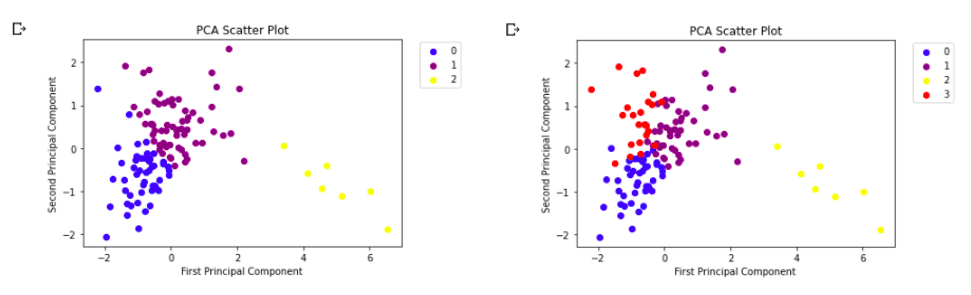

Version 1:
  + Group 0: 43 streets         
  + Group 1: 47 strests
  + Group 2:  7 streets
  + Group 3: 23 streets

Version 2: 
  + Group 0: 49 streets         
  + Group 1: 64 strests
  + Group 2:  7 streets

The more concentrated the points are in the same cluster, the more similar they are to each other, and therefore the better the results will be. For this reason, the version with 4 clusters has been chosen.

### **Cluster Version 1**

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=4).fit(clus.iloc[:,:-3])

c = kmeans.labels_.astype(float)
from sklearn.decomposition import PCA
# Create a regular PCA model 
pca = PCA(n_components=3)

# Fit and transform the data to the model
reduced_data_pca = pca.fit_transform(clus.iloc[:,:-3])

# Print out the data
print ("Projected data: ",reduced_data_pca.shape)

Projected data:  (120, 3)


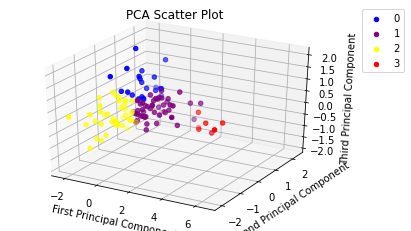

In [ ]:
c_names = np.array(range(4))
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection = '3d')
colors = ['blue','purple','yellow','red','orange', 'pink','green']
for i in range(len(colors)):
    x = reduced_data_pca[:,0][c == i]
    y = reduced_data_pca[:,1][c == i]
    z = reduced_data_pca[:,2][c == i]
    ax.scatter(x,y,z, c=colors[i])
plt.legend(c_names,bbox_to_anchor=(1.05,1), loc=2, borderaxespad=0.3)
ax.set_xlabel('First Principal Component')
ax.set_ylabel('Second Principal Component')
ax.set_zlabel('Third Principal Component')
plt.title("PCA Scatter Plot")
plt.show()

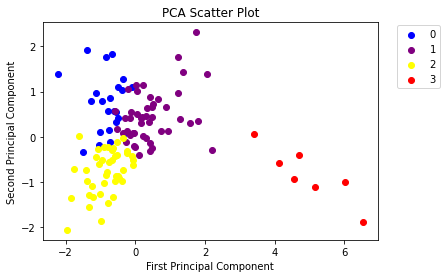

In [ ]:
c_names = np.array(range(4))
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111)
colors = ['blue','purple','yellow','red','orange', 'pink','green']
for i in range(len(colors)):
    x = reduced_data_pca[:,0][c == i]
    y = reduced_data_pca[:,1][c == i]
    ax.scatter(x,y, c=colors[i])
plt.legend(c_names,bbox_to_anchor=(1.05,1), loc=2, borderaxespad=0.3)
ax.set_xlabel('First Principal Component')
ax.set_ylabel('Second Principal Component')
plt.title("PCA Scatter Plot")
plt.show()

In [ ]:
import collections
collections.Counter(c)

Counter({0.0: 23, 1.0: 47, 2.0: 43, 3.0: 7})

In [ ]:
clus['group'] = c

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
cluster_DB = pd.merge(complete_BD_2018_21, clus[['entity_id_x', 'name_x','group']], how= 'left', left_on=['entity_id', 'name'], right_on=['entity_id_x', 'name_x'])
cluster_DB

,Unnamed: 0,Unnamed: 0.1,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday,entity_id_x,name_x,group
0,0,0,CT2Z9,28,1,R. Constituição - Faria Guimarães,3,31,12,2017,38.00,2017-12-31,6,CT2Z9,R. Constituição - Faria Guimarães,1.0
1,1,1,CT2Z9,16,1,R. Constituição - Faria Guimarães,4,31,12,2017,36.50,2017-12-31,6,CT2Z9,R. Constituição - Faria Guimarães,1.0
2,2,2,CT3Z9,16,1,R. Faria Guimarães - Constituição,10,31,12,2017,20.00,2017-12-31,6,CT3Z9,R. Faria Guimarães - Constituição,2.0
3,3,3,CT3Z9,22,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6,CT3Z9,R. Faria Guimarães - Constituição,2.0
4,4,4,CT3Z9,29,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6,CT3Z9,R. Faria Guimarães - Constituição,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24551012,1635652,1778486,CT18Z1,22,1,Av. Rodrigues de Freitas,10,19,3,2021,26.35,2021-03-19,4,CT18Z1,Av. Rodrigues de Freitas,1.0
24551013,1635653,1778487,CT8Z1,69,1,R. Fontainhas,10,19,3,2021,75.90,2021-03-19,4,CT8Z1,R. Fontainhas,2.0
24551014,1635654,1778488,CT9Z7,18,1,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021,24.35,2021-03-19,4,CT9Z7,Av. Fernão Magalhães N-S - Túnel,2.0
24551015,1635655,1778489,CT13Z9,19,1,R. Antero Quental - Constituição - S-N,10,19,3,2021,26.15,2021-03-19,4,CT13Z9,R. Antero Quental - Constituição - S-N,0.0


group
0.0    AxesSubplot(0.125,0.125;0.775x0.755)
1.0    AxesSubplot(0.125,0.125;0.775x0.755)
2.0    AxesSubplot(0.125,0.125;0.775x0.755)
3.0    AxesSubplot(0.125,0.125;0.775x0.755)
dtype: object

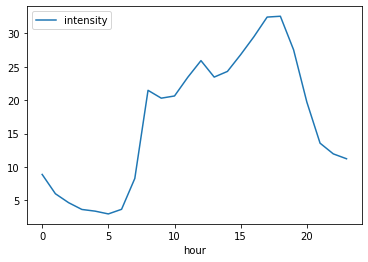

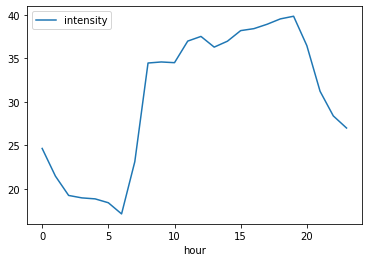

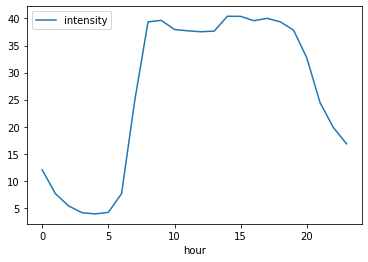

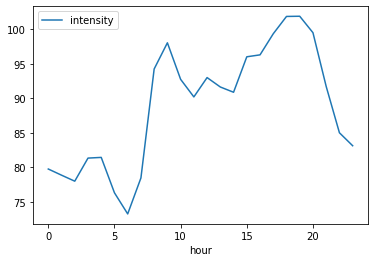

In [ ]:
cluster_DB.groupby(['group','hour']).mean('intensity').reset_index().groupby('group').plot(x = 'hour', y='intensity')

### **Cluster Version 2**

In [ ]:
from sklearn.cluster import KMeans

kmeans = KMeans(n_clusters=3).fit(clus.iloc[:,:-3])

c = kmeans.labels_.astype(float)
from sklearn.decomposition import PCA
# Create a regular PCA model 
pca = PCA(n_components=3)

# Fit and transform the data to the model
reduced_data_pca = pca.fit_transform(clus.iloc[:,:-3])

# Print out the data
print ("Projected data: ",reduced_data_pca.shape)

Projected data:  (120, 3)


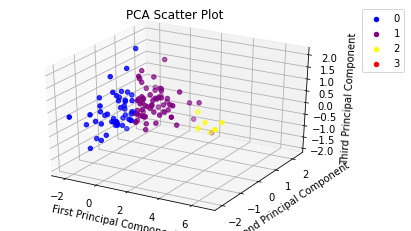

In [ ]:
c_names = np.array(range(4))
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111, projection = '3d')
colors = ['blue','purple','yellow','red','orange', 'pink','green']
for i in range(len(colors)):
    x = reduced_data_pca[:,0][c == i]
    y = reduced_data_pca[:,1][c == i]
    z = reduced_data_pca[:,2][c == i]
    ax.scatter(x,y,z, c=colors[i])
plt.legend(c_names,bbox_to_anchor=(1.05,1), loc=2, borderaxespad=0.3)
ax.set_xlabel('First Principal Component')
ax.set_ylabel('Second Principal Component')
ax.set_zlabel('Third Principal Component')
plt.title("PCA Scatter Plot")
plt.show()

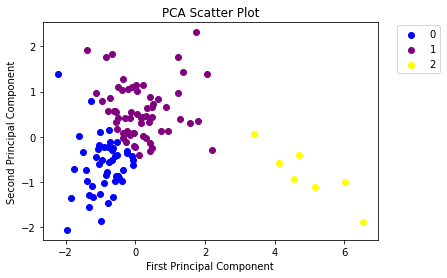

In [ ]:
c_names = np.array(range(3))
from mpl_toolkits.mplot3d import Axes3D
fig = plt.figure()
ax = fig.add_subplot(111)
colors = ['blue','purple','yellow','red','orange', 'pink','green']
for i in range(len(colors)):
    x = reduced_data_pca[:,0][c == i]
    y = reduced_data_pca[:,1][c == i]
    ax.scatter(x,y, c=colors[i])
plt.legend(c_names,bbox_to_anchor=(1.05,1), loc=2, borderaxespad=0.3)
ax.set_xlabel('First Principal Component')
ax.set_ylabel('Second Principal Component')
plt.title("PCA Scatter Plot")
plt.show()

In [ ]:
clus['group'] = c

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
import collections
collections.Counter(c)

Counter({0.0: 49, 1.0: 64, 2.0: 7})

In [ ]:
cluster_DB2 = pd.merge(complete_BD_2018_21, clus[['entity_id_x', 'name_x','group']], how= 'left', left_on=['entity_id', 'name'], right_on=['entity_id_x', 'name_x'])
cluster_DB2

,Unnamed: 0,Unnamed: 0.1,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday,entity_id_x,name_x,group
0,0,0,CT2Z9,28,1,R. Constituição - Faria Guimarães,3,31,12,2017,38.00,2017-12-31,6,CT2Z9,R. Constituição - Faria Guimarães,1.0
1,1,1,CT2Z9,16,1,R. Constituição - Faria Guimarães,4,31,12,2017,36.50,2017-12-31,6,CT2Z9,R. Constituição - Faria Guimarães,1.0
2,2,2,CT3Z9,16,1,R. Faria Guimarães - Constituição,10,31,12,2017,20.00,2017-12-31,6,CT3Z9,R. Faria Guimarães - Constituição,0.0
3,3,3,CT3Z9,22,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6,CT3Z9,R. Faria Guimarães - Constituição,0.0
4,4,4,CT3Z9,29,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6,CT3Z9,R. Faria Guimarães - Constituição,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
24551012,1635652,1778486,CT18Z1,22,1,Av. Rodrigues de Freitas,10,19,3,2021,26.35,2021-03-19,4,CT18Z1,Av. Rodrigues de Freitas,1.0
24551013,1635653,1778487,CT8Z1,69,1,R. Fontainhas,10,19,3,2021,75.90,2021-03-19,4,CT8Z1,R. Fontainhas,0.0
24551014,1635654,1778488,CT9Z7,18,1,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021,24.35,2021-03-19,4,CT9Z7,Av. Fernão Magalhães N-S - Túnel,0.0
24551015,1635655,1778489,CT13Z9,19,1,R. Antero Quental - Constituição - S-N,10,19,3,2021,26.15,2021-03-19,4,CT13Z9,R. Antero Quental - Constituição - S-N,1.0


group
0.0    AxesSubplot(0.125,0.125;0.775x0.755)
1.0    AxesSubplot(0.125,0.125;0.775x0.755)
2.0    AxesSubplot(0.125,0.125;0.775x0.755)
dtype: object

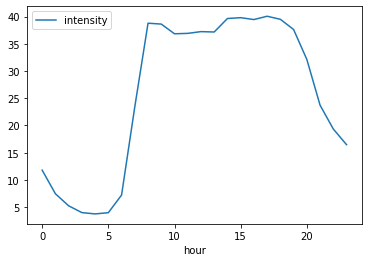

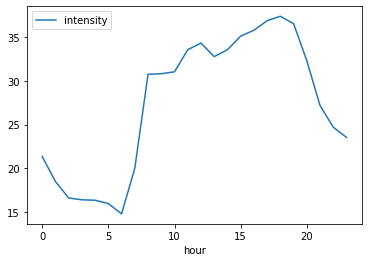

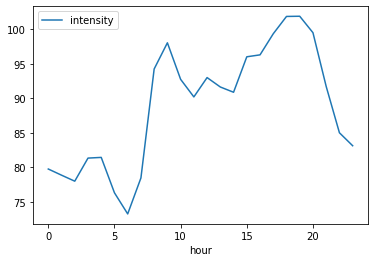

In [ ]:
cluster_DB2.groupby(['group','hour']).mean('intensity').reset_index().groupby('group').plot(x = 'hour', y='intensity')

### **Visualization Cluster Version 1**

In [ ]:
streets_by_group = clus[['entity_id_x','group','name_x']].groupby(['entity_id_x','group','name_x']).count()[:-6].reset_index()

In [ ]:
streets_by_group.head()

,entity_id_x,group,name_x
0,CT10Z2,1.0,R. Fernandes Tomás - 24 de Agosto
1,CT10Z3,2.0,R. Camões - N-S
2,CT10Z4,0.0,Av. Boavista - Casa da Música - E-O
3,CT10Z5,2.0,Via Panorâmica - Faixa BUS
4,CT10Z8,1.0,Av.Sidónio Pais - Cruzamento - O-E


In [ ]:
entities = data_entities[data_entities['entity_type']=='TrafficFlowObserved']
entities['entity_id'] = entities['entity_id'].str.replace("urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:","")
entities = entities[['entity_id','latitude','longitude']]
entities.head()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,entity_id,latitude,longitude
0,testsixsq,41.162590,-8.585198
1,CT10Z2,41.148406,-8.599094
2,CT10Z3,41.154960,-8.610091
3,CT10Z4,41.158701,-8.633546
4,CT10Z5,41.151096,-8.633818


In [ ]:
clus_coor = streets_by_group.merge(entities, left_on = 'entity_id_x', right_on = 'entity_id', how = 'left')
clus_coor.head()

,entity_id_x,group,name_x,entity_id,latitude,longitude
0,CT10Z2,1.0,R. Fernandes Tomás - 24 de Agosto,CT10Z2,41.148406,-8.599094
1,CT10Z3,2.0,R. Camões - N-S,CT10Z3,41.154960,-8.610091
2,CT10Z4,0.0,Av. Boavista - Casa da Música - E-O,CT10Z4,41.158701,-8.633546
3,CT10Z5,2.0,Via Panorâmica - Faixa BUS,CT10Z5,41.151096,-8.633818
4,CT10Z8,1.0,Av.Sidónio Pais - Cruzamento - O-E,CT10Z8,41.163673,-8.634562


In [ ]:
import plotly.express as px

fig = px.scatter_mapbox(clus_coor, lat="latitude", lon="longitude", animation_frame='group', hover_data=["entity_id_x","name_x"], 
                        color_discrete_sequence=["red"], zoom=12, height=600)
fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

### **Saving clustered BDs in GDrive**

In [ ]:
cluster_DB.to_csv('/content/drive/MyDrive/WDL/Stage_2/clustered_BD_v1.csv')

In [ ]:
cluster_DB2.to_csv('/content/drive/MyDrive/WDL/Stage_2/clustered_BD_v2.csv')

### **Visualizing clusters in terms of time-series**

In [ ]:
all_data = pd.read_csv("/content/drive/MyDrive/WDL/clustered_BD_v1.csv")
all_data.groupby('group').count()['name']

group
0.0    9813916
1.0    1317098
2.0    3636042
3.0    9783953
Name: name, dtype: int64

In [ ]:
tw = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/weather_observed/all_weather.csv')
tw['date'] = tw['date'].astype(str)
tw.head()

,Unnamed: 0,latitude,longitude,name_x,precipitation,temperature,winddirection,windspeed,date
0,0,41.183769,-8.603107,Hospital S.João,0.0,20.400000,130.0,0.472222,2018-10-23 21:00:00
1,1,41.161724,-8.603915,Marquês,0.0,22.799999,85.0,1.833333,2018-10-22 10:00:00
2,2,41.148427,-8.598082,Campo 24 de Agosto,0.0,13.600000,123.0,1.166667,2018-10-01 06:00:00
3,4,41.183769,-8.603107,Hospital S.João,0.0,14.200000,NaN,0.000000,2018-10-01 06:00:00
4,5,41.148427,-8.598082,Campo 24 de Agosto,0.0,28.000000,301.0,1.555556,2018-10-01 15:00:00


### GROUP 0

In [ ]:
grupo0 = all_data[all_data['group'] == 0]
grupo0['date'] = pd.to_datetime(grupo0[['year', 'month', 'day','hour']])
grupo0.head()

grupo_0 = grupo0.groupby(['date']).mean('intensity').reset_index()[['intensity','date']]
grupo_0.head()

grupo_0['date'] = grupo_0['date'].astype(str)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
weather = tw.groupby('date').mean().reset_index()[['date','precipitation','temperature','winddirection','windspeed']]
weather.head()

,date,precipitation,temperature,winddirection,windspeed
0,2017-12-31 23:00:00,0.0,15.000000,NaN,NaN
1,2018-06-29 18:00:00,0.0,19.700001,312.0,1.500000
2,2018-06-29 19:00:00,0.0,19.000000,260.0,0.861111
3,2018-06-29 20:00:00,0.0,18.400000,282.0,1.666667
4,2018-06-29 21:00:00,0.0,18.400000,219.0,0.694444


In [ ]:
#Merge with weather information
group_0_weather = grupo_0.merge(weather, on = ['date'], how = 'left')
group_0_weather['date'] = pd.to_datetime(group_0_weather.date)

group_0_weather['fecha'] = group_0_weather['date'].astype(str)
group_0_weather['fecha'] = group_0_weather['fecha'].str[:10]
group_0_weather.head()

,intensity,date,precipitation,temperature,winddirection,windspeed,fecha
0,22.277652,2017-12-31 00:00:00,NaN,NaN,NaN,NaN,2017-12-31
1,13.755102,2017-12-31 01:00:00,NaN,NaN,NaN,NaN,2017-12-31
2,9.148492,2017-12-31 02:00:00,NaN,NaN,NaN,NaN,2017-12-31
3,7.021635,2017-12-31 03:00:00,NaN,NaN,NaN,NaN,2017-12-31
4,5.768116,2017-12-31 04:00:00,NaN,NaN,NaN,NaN,2017-12-31


In [ ]:
#Merge with covid information. As there are some duplicated rows and the date is not in the correct form, some parsing needs to be done
covid['data']= pd.to_datetime(covid['data'])
covid[covid['data_dados'] == '01/01/2021 0:00']
covid['data_dados'] = covid['data_dados'].astype(str)
covid = covid.drop_duplicates(subset=['data_dados'], keep='first')
covid['data'] = covid['data_dados'].str[6:10] + '-' + covid['data_dados'].str[3:5] + '-' + covid['data_dados'].str[0:2]

In [ ]:
group_0_weather = group_0_weather.merge(covid, left_on = 'fecha', right_on='data', how = 'left').drop(columns= ['data', 'data_dados', 'confirmados_arsnorte', 'obitos_arsnorte', 'nuevos_arsnorte', 'poblacion_arsnorte'])
group_0_weather['incidencia_14_arsnorte'] = group_0_weather['incidencia_14_arsnorte'].replace(np.nan, 0)

In [ ]:
group_0_weather.to_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_0_weather_covid.csv')

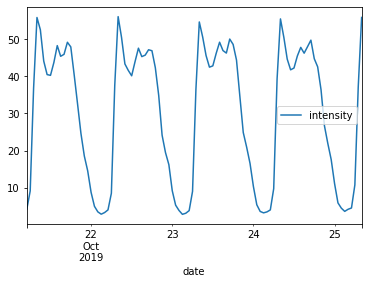

In [ ]:
group_0_weather[15400:15500].plot(x='date', y = 'intensity')

### GROUP 1

In [ ]:
grupo1 = all_data[all_data['group'] == 1]
grupo1['date'] = pd.to_datetime(grupo1[['year', 'month', 'day','hour']])
grupo1.head()

grupo_1 = grupo1.groupby(['date']).mean('intensity').reset_index()[['intensity','date']]
grupo_1.head()

grupo_1['date'] = grupo_1['date'].astype(str)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
weather = tw.groupby('date').mean().reset_index()[['date','precipitation','temperature','winddirection','windspeed']]
weather.head()

,date,precipitation,temperature,winddirection,windspeed
0,2017-12-31 23:00:00,0.0,15.000000,NaN,NaN
1,2018-06-29 18:00:00,0.0,19.700001,312.0,1.500000
2,2018-06-29 19:00:00,0.0,19.000000,260.0,0.861111
3,2018-06-29 20:00:00,0.0,18.400000,282.0,1.666667
4,2018-06-29 21:00:00,0.0,18.400000,219.0,0.694444


In [ ]:
group_1_weather = grupo_1.merge(weather, on = ['date'], how = 'left')
group_1_weather['date'] = pd.to_datetime(group_1_weather.date)

group_1_weather['fecha'] = group_1_weather['date'].astype(str)
group_1_weather['fecha'] = group_1_weather['fecha'].str[:10]
group_1_weather.head()

,intensity,date,precipitation,temperature,winddirection,windspeed,fecha
0,205.360000,2017-12-31 00:00:00,NaN,NaN,NaN,NaN,2017-12-31
1,275.480000,2017-12-31 01:00:00,NaN,NaN,NaN,NaN,2017-12-31
2,364.375000,2017-12-31 02:00:00,NaN,NaN,NaN,NaN,2017-12-31
3,301.272727,2017-12-31 03:00:00,NaN,NaN,NaN,NaN,2017-12-31
4,291.920000,2017-12-31 04:00:00,NaN,NaN,NaN,NaN,2017-12-31


In [ ]:
group_1_weather = group_1_weather.merge(covid, left_on = 'fecha', right_on='data', how = 'left').drop(columns= ['data', 'data_dados', 'confirmados_arsnorte', 'obitos_arsnorte', 'nuevos_arsnorte', 'poblacion_arsnorte'])
group_1_weather['incidencia_14_arsnorte'] = group_1_weather['incidencia_14_arsnorte'].replace(np.nan, 0)

In [ ]:
group_1_weather.to_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_1_weather_covid.csv')

In [ ]:
group_1_weather.head()

,intensity,date,precipitation,temperature,winddirection,windspeed,fecha,incidencia_14_arsnorte
0,205.360000,2017-12-31 00:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
1,275.480000,2017-12-31 01:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
2,364.375000,2017-12-31 02:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
3,301.272727,2017-12-31 03:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
4,291.920000,2017-12-31 04:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0


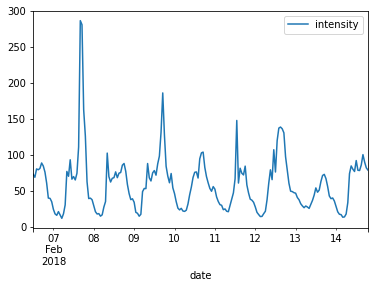

In [ ]:
group_1_weather[900:1100].plot(x='date', y = 'intensity')

### GRUPO 2

In [ ]:
grupo2 = all_data[all_data['group'] == 2]
grupo2['date'] = pd.to_datetime(grupo2[['year', 'month', 'day','hour']])
grupo2.head()

grupo_2 = grupo2.groupby(['date']).mean('intensity').reset_index()[['intensity','date']]
grupo_2.head()

grupo_2['date'] = grupo_2['date'].astype(str)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
weather = tw.groupby('date').mean().reset_index()[['date','precipitation','temperature','winddirection','windspeed']]
weather.head()

,date,precipitation,temperature,winddirection,windspeed
0,2017-12-31 23:00:00,0.0,15.000000,NaN,NaN
1,2018-06-29 18:00:00,0.0,19.700001,312.0,1.500000
2,2018-06-29 19:00:00,0.0,19.000000,260.0,0.861111
3,2018-06-29 20:00:00,0.0,18.400000,282.0,1.666667
4,2018-06-29 21:00:00,0.0,18.400000,219.0,0.694444


In [ ]:
group_2_weather = grupo_2.merge(weather, on = ['date'], how = 'left')
group_2_weather['date'] = pd.to_datetime(group_2_weather.date)

group_2_weather['fecha'] = group_2_weather['date'].astype(str)
group_2_weather['fecha'] = group_2_weather['fecha'].str[:10]
group_2_weather.head()

,intensity,date,precipitation,temperature,winddirection,windspeed,fecha
0,18.358974,2017-12-31 00:00:00,NaN,NaN,NaN,NaN,2017-12-31
1,13.670157,2017-12-31 01:00:00,NaN,NaN,NaN,NaN,2017-12-31
2,9.811828,2017-12-31 02:00:00,NaN,NaN,NaN,NaN,2017-12-31
3,7.517045,2017-12-31 03:00:00,NaN,NaN,NaN,NaN,2017-12-31
4,6.207547,2017-12-31 04:00:00,NaN,NaN,NaN,NaN,2017-12-31


In [ ]:
group_2_weather = group_2_weather.merge(covid, left_on = 'fecha', right_on='data', how = 'left').drop(columns= ['data', 'data_dados', 'confirmados_arsnorte', 'obitos_arsnorte', 'nuevos_arsnorte', 'poblacion_arsnorte'])
group_2_weather['incidencia_14_arsnorte'] = group_2_weather['incidencia_14_arsnorte'].replace(np.nan, 0)

In [ ]:
group_2_weather.to_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_2_weather_covid.csv')

In [ ]:
group_2_weather.head()

,intensity,date,precipitation,temperature,winddirection,windspeed,fecha,incidencia_14_arsnorte
0,18.358974,2017-12-31 00:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
1,13.670157,2017-12-31 01:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
2,9.811828,2017-12-31 02:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
3,7.517045,2017-12-31 03:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0
4,6.207547,2017-12-31 04:00:00,NaN,NaN,NaN,NaN,2017-12-31,0.0


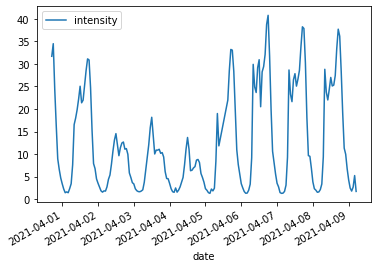

In [ ]:
group_2_weather[-200:].plot(x='date', y = 'intensity')

### GRUPO 3

In [ ]:
grupo3 = all_data[all_data['group'] == 3]
grupo3['date'] = pd.to_datetime(grupo3[['year', 'month', 'day','hour']])
grupo3.head()

grupo_3 = grupo3.groupby(['date']).mean('intensity').reset_index()[['intensity','date']]
grupo_3.head()

grupo_3['date'] = grupo_3['date'].astype(str)

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
weather = tw.groupby('date').mean().reset_index()[['date','precipitation','temperature','winddirection','windspeed']]
weather.head()

,date,precipitation,temperature,winddirection,windspeed
0,2017-12-31 23:00:00,0.0,15.000000,NaN,NaN
1,2018-06-29 18:00:00,0.0,19.700001,312.0,1.500000
2,2018-06-29 19:00:00,0.0,19.000000,260.0,0.861111
3,2018-06-29 20:00:00,0.0,18.400000,282.0,1.666667
4,2018-06-29 21:00:00,0.0,18.400000,219.0,0.694444


In [ ]:
group_3_weather = grupo_3.merge(weather, on = ['date'], how = 'left')
group_3_weather['date'] = pd.to_datetime(group_3_weather.date)

group_3_weather['fecha'] = group_3_weather['date'].astype(str)
group_3_weather['fecha'] = group_3_weather['fecha'].str[:10]
group_3_weather.head()

,intensity,date,precipitation,temperature,winddirection,windspeed,fecha
0,61.150685,2017-12-31 00:00:00,NaN,NaN,NaN,NaN,2017-12-31
1,63.355615,2017-12-31 01:00:00,NaN,NaN,NaN,NaN,2017-12-31
2,40.228117,2017-12-31 02:00:00,NaN,NaN,NaN,NaN,2017-12-31
3,24.654155,2017-12-31 03:00:00,NaN,NaN,NaN,NaN,2017-12-31
4,38.466480,2017-12-31 04:00:00,NaN,NaN,NaN,NaN,2017-12-31


In [ ]:
group_3_weather = group_3_weather.merge(covid, left_on = 'fecha', right_on='data', how = 'left').drop(columns= ['data', 'data_dados', 'confirmados_arsnorte', 'obitos_arsnorte', 'nuevos_arsnorte', 'poblacion_arsnorte'])
group_3_weather['incidencia_14_arsnorte'] = group_3_weather['incidencia_14_arsnorte'].replace(np.nan, 0)

In [ ]:
group_3_weather.to_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_3_weather_covid.csv')

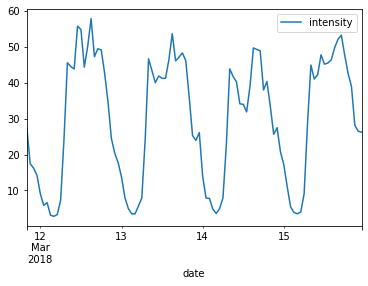

In [ ]:
group_3_weather[1700:1800].plot(x='date', y = 'intensity')

# **Forecasting the intensity**

After removing outliers and joining into a single df (for each year) the variables that we have considered to be important, we move onto predicting the traffic flow. There are two possible ways to do this: forecasting intensity with the time series or forecasting the intesity as a function of the time series and some other variables, which are:
- temperature
- precipitation
- wind speed
- wind direction
- covid incidence (if aplicable, else 0)

For this second part we do a Vector AutoRegression to forecast the values of these variables in order to be able to forecast intensity as a function if them.

The proccess is explained below withe the first group (first cluster) as a guide. Again, this is repeated for the rest of the groups.

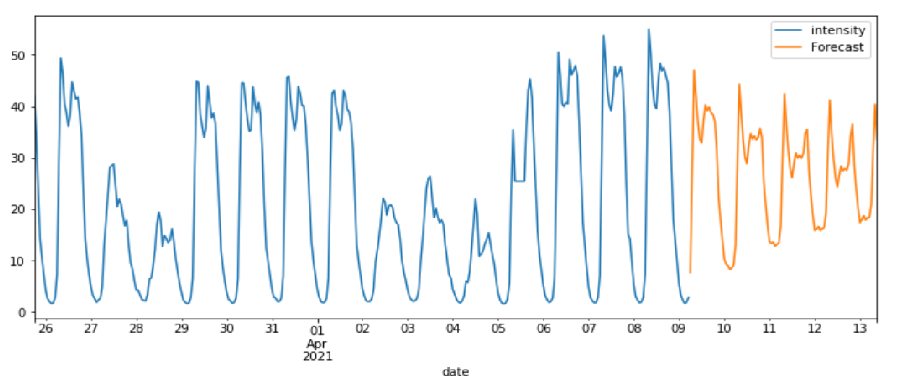

In [ ]:
from statsmodels.tsa.seasonal import seasonal_decompose

/usr/local/lib/python3.7/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning:

pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.



In [ ]:
g0 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_0_weather_covid.csv', index_col ='date', parse_dates = True).asfreq('h')
g1 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_1_weather_covid.csv', index_col ='date', parse_dates = True).asfreq('h')
g2 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_2_weather_covid.csv', index_col ='date', parse_dates = True).asfreq('h')
g3 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/datos_arima/group_3_weather_covid.csv', index_col ='date', parse_dates = True).asfreq('h')

In [ ]:
#Remove dates when there is no info about the weather
start_remove=pd.to_datetime('2017-12-31 00:00:00')
end_remove = pd.to_datetime('2018-06-29 17:00:00')
dropThis = pd.date_range(start_remove,end_remove,freq='h')

g0 = g0[~g0.index.isin(dropThis)]
g1 = g1[~g1.index.isin(dropThis)]
g2 = g2[~g2.index.isin(dropThis)]
g3 = g3[~g3.index.isin(dropThis)]

#### Inpute values

There are also some values from certain variables that are missing. Rows should not be removed in order to have all values of the time series so said NaN value is filled with the nearest value in time. This is done for every variable.

In [ ]:
g0=g0.fillna(-500)
g1=g1.fillna(-500)
g2=g2.fillna(-500)
g3=g3.fillna(-500)

#missing value treatment
cols = g0.columns
for j in cols:
    for i in range(0,len(g0)):
       if g0[j][i] == -500:
           g0[j][i] = g0[j][i-1]

cols = g1.columns
for j in cols:
    for i in range(0,len(g1)):
       if g1[j][i] == -500:
           g1[j][i] = g1[j][i-1]


cols = g2.columns
for j in cols:
    for i in range(0,len(g2)):
       if g2[j][i] == -500:
           g2[j][i] = g2[j][i-1]


cols = g3.columns
for j in cols:
    for i in range(0,len(g3)):
       if g3[j][i] == -500:
           g3[j][i] = g3[j][i-1]



/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:24: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:31: SettingWithCopyWarning:


A value is tryi

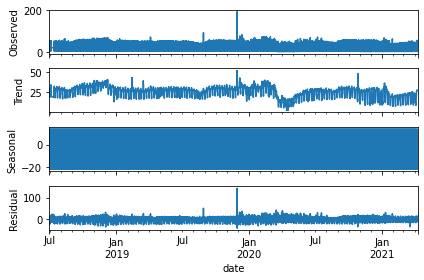

In [ ]:
#Plot variable intensity for group 0
# ETS Decomposition
decomposition2 = seasonal_decompose(g0.intensity, 
                            model ='additive').plot()
  

#### Calculate order of model

In [ ]:
# To install the library
!pip3 install pmdarima

In [ ]:
import time 


# Import the library
from pmdarima import auto_arima

start = time.time()
# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")
  
# Fit auto_arima function to AirPassengers dataset
stepwise_fit = auto_arima(g0['intensity'], start_p = 1, start_q = 1,
                          max_p = 3, max_q = 3, m = 12,
                          start_P = 0, seasonal = True,
                          d = None, D = 1, trace = True,
                          error_action ='ignore',   # we don't want to know if an order does not work
                          suppress_warnings = True,  # we don't want convergence warnings
                          stepwise = True)           # set to stepwise
  
    
end=time.time()
duration=end-start
print(duration)


# To print the summary
stepwise_fit.summary()

In [ ]:
import time 


# Import the library
from pmdarima import auto_arima

start = time.time()
# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")
  
# Fit auto_arima function to AirPassengers dataset
stepwise_fit = auto_arima(g1['intensity'], start_p = 1, start_q = 1,
                          max_p = 3, max_q = 3, m = 12,
                          start_P = 0, seasonal = True,
                          d = None, D = 1, trace = True,
                          error_action ='ignore',   # we don't want to know if an order does not work
                          suppress_warnings = True,  # we don't want convergence warnings
                          stepwise = True)           # set to stepwise
  
    
end=time.time()
duration=end-start
print(duration)


# To print the summary
stepwise_fit.summary()

In [ ]:
import time 


# Import the library
from pmdarima import auto_arima

start = time.time()
# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")
  
# Fit auto_arima function to AirPassengers dataset
stepwise_fit = auto_arima(g2['intensity'], start_p = 1, start_q = 1,
                          max_p = 3, max_q = 3, m = 12,
                          start_P = 0, seasonal = True,
                          d = None, D = 1, trace = True,
                          error_action ='ignore',   # we don't want to know if an order does not work
                          suppress_warnings = True,  # we don't want convergence warnings
                          stepwise = True)           # set to stepwise
  
    
end=time.time()
duration=end-start
print(duration)


# To print the summary
stepwise_fit.summary()

In [ ]:
import time 


# Import the library
from pmdarima import auto_arima

start = time.time()
# Ignore harmless warnings
import warnings
warnings.filterwarnings("ignore")
  
# Fit auto_arima function to AirPassengers dataset
stepwise_fit = auto_arima(g3['intensity'], start_p = 1, start_q = 1,
                          max_p = 3, max_q = 3, m = 12,
                          start_P = 0, seasonal = True,
                          d = None, D = 1, trace = True,
                          error_action ='ignore',   # we don't want to know if an order does not work
                          suppress_warnings = True,  # we don't want convergence warnings
                          stepwise = True)           # set to stepwise
  
    
end=time.time()
duration=end-start
print(duration)


# To print the summary
stepwise_fit.summary()

## **Forecast**

As a proof of concept, the next steps are done for the first cluster (group 0). Both methods are performed (forecast of intensity given the time series and given the time series plus other variables ) and evaluated to chose one for the other groups.

#### Forecast with time-series and other variables 

In [ ]:
# Make copy of original df to get independent variables
var_for=g0.copy()

#Drop unnecessary variables
var_for = var_for.drop(['Unnamed: 0','intensity','fecha','precipitation','winddirection','windspeed'], axis=1)
var_for.head()

,temperature,incidencia_14_arsnorte
date,,
2018-06-29 18:00:00,19.700001,0.0
2018-06-29 19:00:00,19.000000,0.0
2018-06-29 20:00:00,18.400000,0.0
2018-06-29 21:00:00,18.400000,0.0
2018-06-29 22:00:00,18.400000,0.0


In [ ]:
# Train the model on intensity and added variables
model2 = sm.tsa.statespace.SARIMAX(g0['intensity'],freq='h',
                        order = (3, 0, 2), 
                        seasonal_order =(2, 1, 0, 12), exog=var_for, maxiter=30)

results = model2.fit()

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



In [ ]:
#Forecast values of the independet variables using Vector Autoregression for the next 100 hours

model2 = VAR(endog=var_for)
model_fit2 = model2.fit()

yhat = model_fit2.forecast(model_fit.y, steps=100)


In [ ]:
#Save predictions as data frame
column_names = ["temperature", "covid"] 
pred_df = pd.DataFrame(yhat, columns = column_names)

for j in range(0,):
    for i in range(0, len(yhat)):
       pred_df.iloc[i][j] = yhat[i][j]

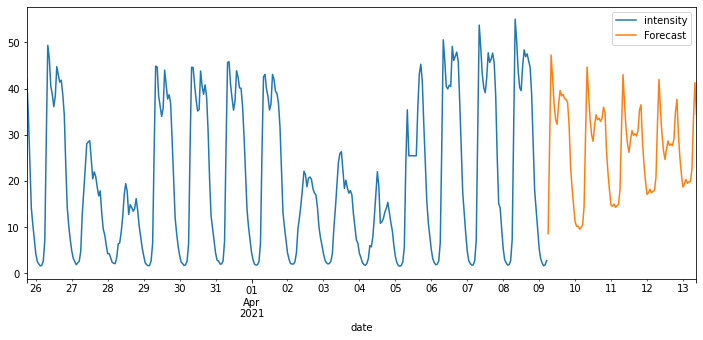

In [ ]:
# Forecast intensity for the next 4 days
forecast = results.predict(start = len(g0), 
                          end = (len(g0)-1) + 100, 
                          typ = 'levels', exog=pred_df).rename('Forecast_G0')
  
# Plot the forecast values
g0['intensity'][24000:].plot(figsize = (12, 5), legend = True)
forecast.plot(legend = True)

#### Forecast with time-series

In this part we forecast the intensity only as a function of the time series.

In [ ]:
# Fit model with intensity as a function of only the time series
model_g0 = sm.tsa.statespace.SARIMAX(g0['intensity'],freq='h',
                        order = (3, 0, 2), 
                        seasonal_order =(2, 1, 0, 12))

results = model_g0.fit()  

In [ ]:
results.plot_diagnostics(figsize=(12, 7))

In [ ]:
# Forecast intensity for the next 4 days 
forecast = results.predict(start = len(g0), 
                          end = (len(g0)-1) + 100, 
                          typ = 'levels').rename('Forecast_G0')


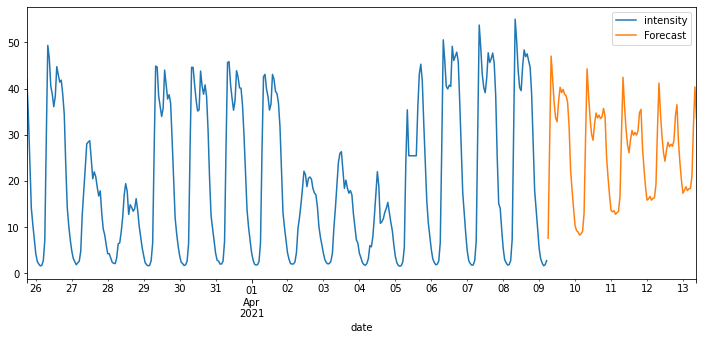

In [ ]:
# Plot the forecast values
g0['intensity'][24000:].plot(figsize = (12, 5), legend = True)
forecast.plot(legend = True)

As it can be seen above, the forecasting for both models ( intensity vs intensity + added variables) is almost identical, there are slight differences on the smaller peaks but nothing remarkable. It is clear that with only the time series for the intensity the model is able to predict the same as with added variables, which can mean that the time series is already impacted by these variables and the model doesn't need them to predict. 

Even though there are small differences is aspect the main in difference is in computation time: the model that takes into account only the intensity needs 3 minutes to compute while the one who takes into account the other variables needs 15-20. For this reason we proceeed to forecast the other groups taking into account only the intensity.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:512: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



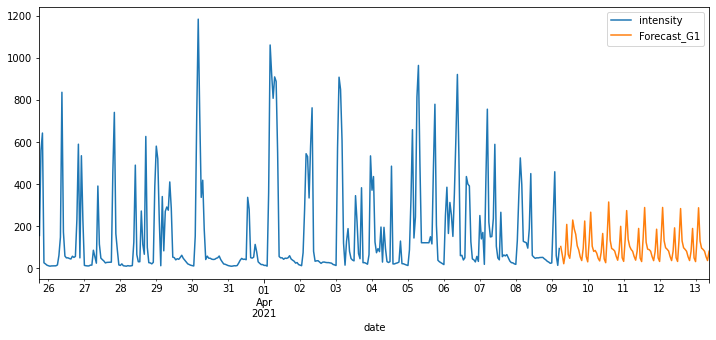

In [ ]:
#GROUP 1
# Fit model with intensity as a function of only the time series
model_g1 = sm.tsa.statespace.SARIMAX(g1['intensity'],freq='h',
                        order = (3, 0, 2), 
                        seasonal_order =(2, 1, 0, 12))

results = model_g1.fit()  

# Forecast intensity for the next 100 hours
forecast = results.predict(start = len(g1), 
                          end = (len(g1)-1) + 100, 
                          typ = 'levels').rename('Forecast_G1')

# Plot the forecast values
g1['intensity'][24000:].plot(figsize = (12, 5), legend = True)
forecast.plot(legend = True)


/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/base/model.py:512: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



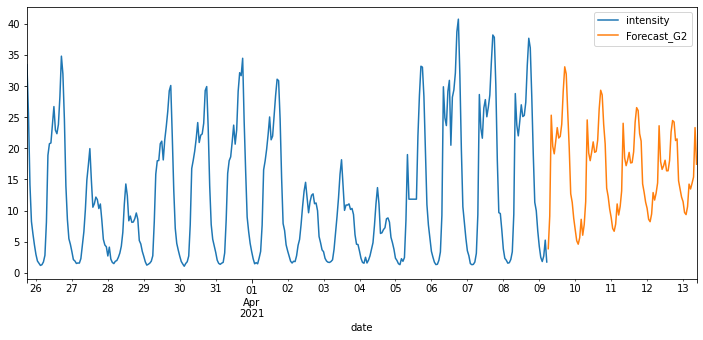

In [ ]:
#GROUP 2
# Fit model with intensity as a function of only the time series
model_g2 = sm.tsa.statespace.SARIMAX(g2['intensity'],freq='h',
                        order = (3, 0, 2), 
                        seasonal_order =(2, 1, 0, 12))

results = model_g2.fit()  

# Forecast intensity for the next 4 days
forecast = results.predict(start = len(g2), 
                          end = (len(g2)-1) + 100, 
                          typ = 'levels').rename('Forecast_G2')

# Plot the forecast values
g2['intensity'][24000:].plot(figsize = (12, 5), legend = True)
forecast.plot(legend = True)

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:949: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros as starting parameters.

/usr/local/lib/python3.7/dist-packages/statsmodels/tsa/statespace/sarimax.py:961: UserWarning:

Non-invertible starting MA parameters found. Using zeros as starting parameters.



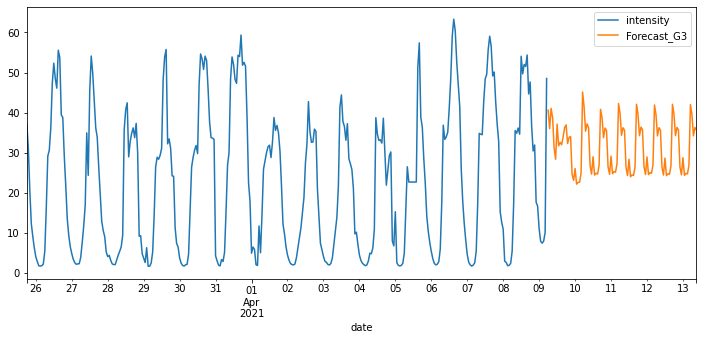

In [ ]:
#GROUP 3
# Fit model with intensity as a function of only the time series
model_g3 = sm.tsa.statespace.SARIMAX(g3['intensity'],freq='h',
                        order = (3, 0, 2), 
                        seasonal_order =(2, 1, 0, 12))

results = model_g3.fit()  

# Forecast intensity for the next 100 hours
forecast = results.predict(start = len(g3), 
                          end = (len(g3)-1) + 100, 
                          typ = 'levels').rename('Forecast_G3')

# Plot the forecast values
g3['intensity'][24000:].plot(figsize = (12, 5), legend = True)
forecast.plot(legend = True)

# **Assessing dimensions impacting traffic-flow**



Up to this section, we have focused on developing the building blocks for a reliable forecasting system for traffic flows in Porto. However, what dimensions are truly driving traffic in Porto? Here, we conclude the project with a detailed analysis of the variables potentially leading to congestions. 



First, we leveraged an Extreme Gradient Boosting model to determine the overall independent importance of each feature. The assessment facilitated the detection of three broad categories and their respective weights:


	
Weather: 18%
	Time-related features (weekday, month, hours): 14%
	Points of Interest (POIs): driving ~68% of traffic


Another counterintuitive insight is the negligible impact of COVID19 on intra-year dynamics.



Second, we have dived deep into each of the main categories. In the weather dimension, we can divide the impact into precipitation (driving 51%) and temperature (49%). For time-related features, months are weighted 21%, weekdays 63%, and hours 15%. 



For the most impactful dimension, POI, we have performed a slightly different assessment. We have conducted a multi-output regression feature impact measurement to understand the specific influence of a POI category on the traffic given a certain timeframe (months, weekdays, and hours). This assessment results in the following kind of visualization, which facilitates decision-making.



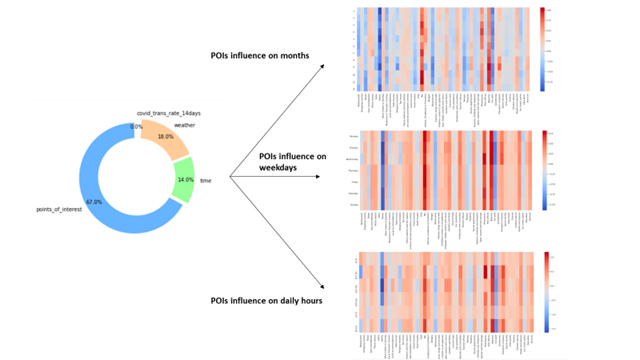


In the next section, we will propose a congestion-management strategy based on our forecasting models and insights.



In [ ]:
import json
import pandas as pd
import pandas as pd
import numpy as np
import sklearn.neighbors
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import r2_score
from scipy.stats import spearmanr, pearsonr
import matplotlib.pyplot as plt
import plotly.express as px

#!pip install xgboost
from xgboost import XGBRegressor
import xgboost as xgb

In [ ]:
file = open('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/POIs.json', encoding="utf8")
data = json.load(file)

POIs file parsing in order to obtain id, geographical_zone, category, name and coordinates

In [ ]:
#list with attributes and values from json file
tbl = []
for p in data['points_of_interest']: 
    try:
        tbl.append([p['category'][1]['id'], p['category'][1]['value'], p['description'], p['label'][1]['value'], p['location']['point'][0]['Point']['posList']])
    except:
        tbl.append([p['category'][1]['id'], p['category'][1]['value'], p['description'], p['label'][1]['value']])

#convert list to dataframe 
df = pd.DataFrame(tbl, columns=['id', 'category', 'support_column', 'name', 'geo_coord'])
df

,id,category,support_column,name,geo_coord
0,5c87e24fe323aa00013854ed,Restaurants,"[{'lang': 'pt-PT', 'value': 'O Restaurante Chu...",Churrascão Gaucho,41.15743895 -8.62750399
1,5c87e24fe323aa00013854ed,Restaurants,"[{'lang': 'pt-PT', 'value': 'O Restaurante da ...",Alzira,41.14073900 -8.61242000
2,5c87e24fe323aa00013854ed,Restaurants,"[{'lang': 'pt-PT', 'value': 'O restaurante Irm...",Irmãos Unidos,41.14580771 -8.60511089
3,5c87e24fe323aa00013854ed,Restaurants,"[{'lang': 'pt-PT', 'value': 'Localizado na zon...",Líder,41.16256626 -8.59424829
4,5c87e24fe323aa00013854ed,Restaurants,"[{'lang': 'pt-PT', 'value': 'Restaurante com l...",Abadia,41.14802700 -8.60780700
...,...,...,...,...,...
1905,5ca5d9aafdc8e200014a48d9,Gardens and Parks,"[{'lang': 'pt-PT', 'value': 'O Parque de Serra...",Serralves Park,41.15978439 -8.65984912
1906,5c87e24fe323aa00013854ed,Restaurants,"[{'lang': 'pt-PT', 'value': 'Bem-vindo ao Zeni...",Zenith Brunch & Cocktails,41.14850270 -8.61538547
1907,5c87e616e323aa0001a030a0,Shops,"[{'lang': 'pt-PT', 'value': 'Fundada em 1829 e...",Papelaria Araújo,41.14304468 -8.61488524
1908,5c87e616e323aa0001a030a0,Shops,"[{'lang': 'pt-PT', 'value': 'A Arcádia é uma e...",Arcádia,41.14791041 -8.60665019


In [ ]:
#separate support column into 6 different columns, getting only geographical-zone value from type field
df_pois = (pd.concat({i: pd.DataFrame(x) for i, x in df.pop('support_column').items()})
         .reset_index(level=1, drop=True)
         .join(df)
         .reset_index(drop=True)
         .query('type == "x-citysdk/geographical-zone"')
         .drop(['lang', 'author', 'href', 'license', 'type'], axis = 1)
         )

#separate coordinates into two different columns
new = df_pois["geo_coord"].str.split(" ", n = 1, expand = True)
df_pois["latitude"]= new[0]
df_pois["longitude"]= new[1]
df_pois.drop(columns =["geo_coord"], inplace = True)

df_pois['latitude'] = pd.to_numeric(df_pois['latitude'])
df_pois['longitude'] = pd.to_numeric(df_pois['longitude'])

df_pois

,value,id,category,name,latitude,longitude
7,Boavista,5c87e24fe323aa00013854ed,Restaurants,Churrascão Gaucho,41.157439,-8.627504
27,Centro Histórico,5c87e24fe323aa00013854ed,Restaurants,Alzira,41.140739,-8.612420
45,Baixa,5c87e24fe323aa00013854ed,Restaurants,Irmãos Unidos,41.145808,-8.605111
64,Outras Zonas do Porto,5c87e24fe323aa00013854ed,Restaurants,Líder,41.162566,-8.594248
85,Baixa,5c87e24fe323aa00013854ed,Restaurants,Abadia,41.148027,-8.607807
...,...,...,...,...,...,...
22420,Boavista,5ca5d9aafdc8e200014a48d9,Gardens and Parks,Serralves Park,41.159784,-8.659849
22442,Baixa,5c87e24fe323aa00013854ed,Restaurants,Zenith Brunch & Cocktails,41.148503,-8.615385
22456,Centro Histórico,5c87e616e323aa0001a030a0,Shops,Papelaria Araújo,41.143045,-8.614885
22468,Baixa,5c87e616e323aa0001a030a0,Shops,Arcádia,41.147910,-8.606650


## **Interactive plots**

Interactive bar plot with the number of POIs by category of the different geographical zones 

In [ ]:
dfg=df_pois.groupby(by=["value", "category"]).count().reset_index()
dfg.drop(columns =["name", "latitude", "longitude"], inplace = True)
dfg=dfg.rename(columns={"id": "count"})

# plot structure
fig = px.bar(dfg,
             x='category',
             y='count',
             title='Number of points of interest in Oporto by geographical zone',
             #color='Items',
             barmode='stack', 
             animation_frame= 'value'
             )

fig.update_layout(barmode='stack', xaxis={'categoryorder':'total descending'})
fig.update_layout(margin=dict(l=20, r=20, t=20, b=200),paper_bgcolor="LightSteelBlue")
fig['layout']['updatemenus'][0]['pad']=dict(r= 0, t= 200)
fig['layout']['sliders'][0]['pad']=dict(r= 10, t= 200,)


# plot
fig.show()

Interactive map plot with the distribution of POIs by category

In [ ]:
fig = px.scatter_mapbox(df_pois, lat="latitude", lon="longitude",hover_name="name", hover_data=["name", "category"],animation_frame= 'category',
                        color_discrete_sequence=["fuchsia"], zoom=10, height=300)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

## **Dataframe creation**

Load entities dataframe in order to analyze which are the points of interest located close to the induction loop sensors. We will use Harvesine equation for calculating the distance between entities and pois 

In [ ]:
entities = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/data_entities.csv', encoding='latin-1')
#filter, clean and formatting steps for entities dataframe
entities = entities.query('entity_type == "TrafficFlowObserved"')
entities = entities.drop(['entity_type', 'start_date', 'end_date', 'street'], axis = 1)

entities['latitude'] = pd.to_numeric(entities['latitude'])
entities['longitude'] = pd.to_numeric(entities['longitude'])

entities

,entity_id,name,latitude,longitude
0,testsixsq,Rua dos Campeões Europeus,41.162590,-8.585198
1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Fernandes Tomás - 24 de Agosto,41.148406,-8.599094
2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,R. Camões - N-S,41.154960,-8.610091
3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Boavista - Casa da Música - E-O,41.158701,-8.633546
4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Via Panorâmica - Faixa BUS,41.151096,-8.633818
...,...,...,...,...
125,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara,41.164327,-8.636619
126,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara,41.164327,-8.636619
127,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av. Sidónio Pais - Câmara,41.164327,-8.636619
178,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,Av.Boavista O-E - Parque da Cidade,41.165238,-8.673290


In [ ]:
# add columns with radians for latitude and longitude in both dataframes for Harvesine calculation
df_pois[['lat_radians_pois','long_radians_pois']] = (
    np.radians(df_pois.loc[:,['latitude','longitude']])
)
entities[['lat_radians_entities','long_radians_entities']] = (
    np.radians(entities.loc[:,['latitude','longitude']])
)

In [ ]:
#haversine calculation for distance between 2 pairs of coordinates
dist = sklearn.neighbors.DistanceMetric.get_metric('haversine')
dist_matrix = (dist.pairwise
    (df_pois[['lat_radians_pois','long_radians_pois']],
     entities[['lat_radians_entities','long_radians_entities']])*6371
)
# Note that 6371 is the radius of the earth in km
df_dist_matrix = (
    pd.DataFrame(dist_matrix,index=df_pois['name'], 
                 columns=entities['entity_id'])
)
df_dist_matrix

entity_id,testsixsq,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT10Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT10Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT10Z4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT10Z5,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT10Z8,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT10Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT11Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT11Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT11Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT11Z5,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT11Z8,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT11Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT12Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT12Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT12Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT12Z5,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT12Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT13Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT13Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT13Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT13Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT14Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT14Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT14Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT14Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT15Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT15Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT15Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT15Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT16Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT16Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT16Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT17Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT17Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT17Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT18Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT18Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT18Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT19Z1,...,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT5Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z10,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z5,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z6,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z7,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z8,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT6Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT7Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT7Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT7Z4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT7Z5,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT7Z7,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT7Z8,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT7Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z1,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z5,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z7,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z8,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT8Z9,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT9Z2,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT9Z3,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT9Z4,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT9Z7,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:CMP:CT9Z8,urn:ngsi-ld:Traf

In [ ]:
# Unpivot dataframe to get clarity on results
df_dist_long = (
    pd.melt(df_dist_matrix.reset_index(),id_vars='name')
)

df_dist_long = df_dist_long.rename(columns={'value':'km'})
df_dist_long['km'] = pd.to_numeric(df_dist_long['km'])
df_dist_long

,name,entity_id,km
0,Churrascão Gaucho,testsixsq,3.587683
1,Alzira,testsixsq,3.331385
2,Irmãos Unidos,testsixsq,2.502335
3,Líder,testsixsq,0.757617
4,Abadia,testsixsq,2.490995
...,...,...,...
244785,Serralves Park,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.323217
244786,Zenith Brunch & Cocktails,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1.784779
244787,Papelaria Araújo,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.238384
244788,Arcádia,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.433901


In [ ]:
#to get the point of interest name and category besides the distance from the entity_id, it's necessary to join both dataframes
df_dist_long = pd.merge(df_dist_long,df_pois[['name','category']],on='name', how='left')
df_dist_long = df_dist_long.drop(['name'], axis = 1)

#if dist in km is less or equal than 1km then less_1_km equals 1, if not 0
df_dist_long['less_1_km'] = np.where(df_dist_long['km']<= 1, 1, 0)

df_dist_long

,entity_id,km,category,less_1_km
0,testsixsq,3.587683,Restaurants,0
1,testsixsq,3.331385,Restaurants,0
2,testsixsq,2.502335,Restaurants,0
3,testsixsq,0.757617,Restaurants,1
4,testsixsq,2.490995,Restaurants,0
...,...,...,...,...
255705,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,1.784779,Restaurants,0
255706,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.238384,Shops,0
255707,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.433901,Shops,0
255708,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,2.433901,Shops,0


In [ ]:
types = df_dist_long.category.unique()
df_number_pois = pd.pivot_table(df_dist_long, values=['less_1_km'], 
                       index = ['entity_id'], 
                       columns=['category'], margins=True, 
                       aggfunc='sum', fill_value=0) \
       .reset_index()
# reset column names
df_number_pois.columns = [c[1] if c[1] else c[0] for c in df_number_pois.columns.tolist()]

df_number_pois['entity_id'] = df_number_pois['entity_id'].str.replace(r'urn:ngsi-ld:TrafficFlowObserved:porto:traffic:', '')
df_number_pois['entity_id'] = df_number_pois['entity_id'].str.replace(r'CMP:', '')

#dataframe with entity_ids in rows and columns formed by the categories of the different points of interest
#values represent the number of poi category that are at a shorter distance than 1 km 
#e.g: entity_id CT10Z3 has 31 bars in a circle with a radius smaller or equal to 1 km
df_number_pois 

,entity_id,"Airports, Airfields and Heliports",Bar,Beaches,Bridges,Cafes,Car assistance,Car park,"Casinos, bingo and arcade",Cemeteries,Cinema,Citizens advice,Club,Concert halls,Education,Embassies and consulates,Exhibition centers & art galleries,Fado houses,Fairs and Markets,Gardens and Parks,Guest houses,"Hospitals, health centres and clinics",Hotels,Ice cream parlor,"Libraries, archives and documentation centres",Local accommodations,Marinas and Ports,Monuments,Museums & Thematic Centres,Petrol station,Pharmacies,Police stations and fire station,Post offices,Pousadas of Portugal,Religious temples,Rentals,Restaurants,Roads and squares,Services,Shopping centres,Shops,"Spas, saunas and hot springs",Sports facility,"Statues, Sculptures & Fountains",Tea house,Theatres,Tourism offices,Tourist apartments,Transport company,View points,Wine Cellars & Quintas,Youth hostels,All
0,testsixsq,0,0,0,0,3,4,2,0,0,1,2,0,0,0,0,0,0,2,2,0,1,2,0,0,0,0,0,3,10,7,0,2,0,0,1,6,1,0,1,6,0,4,1,0,0,0,1,2,0,0,0,64
1,CT10Z2,0,7,0,2,13,4,7,0,3,0,3,3,3,4,1,9,0,4,5,6,5,27,1,4,16,0,10,4,7,25,1,4,0,10,9,56,5,2,2,75,4,3,14,0,5,0,10,12,3,0,4,392
2,CT10Z3,0,31,0,0,20,6,14,0,2,2,3,5,4,10,2,12,0,5,4,8,8,43,2,2,27,0,9,5,5,30,3,5,0,8,8,64,10,3,2,117,2,2,37,3,7,0,10,5,2,0,8,555
3,CT10Z4,0,2,0,0,1,3,6,1,2,1,1,0,1,2,7,4,0,1,2,1,2,10,0,3,1,0,3,4,5,9,0,3,0,2,3,21,1,0,3,19,3,2,2,2,0,0,4,1,0,0,1,139
4,CT10Z5,0,1,0,1,1,3,7,0,4,1,0,0,2,5,4,15,0,1,4,0,2,6,0,5,1,0,6,7,3,5,0,2,0,4,2,16,2,0,3,17,1,1,3,2,1,0,7,1,4,0,0,150
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
126,VolumLight:0_3,0,2,0,0,0,3,2,1,2,0,0,0,1,0,6,1,0,0,1,0,1,6,0,1,0,0,3,2,5,9,1,4,0,2,2,15,1,0,0,11,2,3,1,1,0,0,0,0,0,0,0,89
127,VolumLight:0_4,0,2,0,0,0,3,2,1,2,0,0,0,1,0,6,1,0,0,1,0,1,6,0,1,0,0,3,2,5,9,1,4,0,2,2,15,1,0,0,11,2,3,1,1,0,0,0,0,0,0,0,89
128,VolumLight:0_5,0,2,0,0,0,3,2,1,2,0,0,0,1,0,6,1,0,0,1,0,1,6,0,1,0,0,3,2,5,9,1,4,0,2,2,15,1,0,0,11,2,3,1,1,0,0,0,0,0,0,0,89
129,VolumLight:0_6,0,2,0,0,0,3,2,1,2,0,0,0,1,0,6,1,0,0,1,0,1,6,0,1,0,0,3,2,5,9,1,4,0,2,2,15,1,0,0,11,2,3,1,1,0,0,0,0,0,0,0,89


Once created a new dataframe linking the number of pois with the entity_id, it's time to create a new one linking traffic, weather and covid info for 2021

In [ ]:
traffic_2021 = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/Corrected_DBs/Yearly_DBs/corrected_traffic_2021.csv", encoding='latin-1')

#aggregation, formatting and cleaning steps for 2021 traffic_flow dataset
traffic_2021['date'] = pd.to_datetime(traffic_2021['date'])
traffic_2021_aggr = traffic_2021.groupby(by=["entity_id", "name", "year", "month", "day", "hour", 'weekday' ]).intensity.sum().reset_index()
traffic_2021_aggr['date'] = pd.to_datetime(traffic_2021_aggr[['year', 'month', 'day', 'hour']])
traffic_2021_aggr = traffic_2021_aggr.drop(['year', 'day', 'name'], axis = 1)
traffic_2021_aggr

,entity_id,month,hour,weekday,intensity,date
0,CT10Z2,12,0,3,12,2020-12-31 00:00:00
1,CT10Z2,12,1,3,4,2020-12-31 01:00:00
2,CT10Z2,12,2,3,4,2020-12-31 02:00:00
3,CT10Z2,12,3,3,4,2020-12-31 03:00:00
4,CT10Z2,12,4,3,3,2020-12-31 04:00:00
...,...,...,...,...,...,...
183343,CT9Z9,4,1,4,35,2021-04-09 01:00:00
183344,CT9Z9,4,2,4,14,2021-04-09 02:00:00
183345,CT9Z9,4,3,4,7,2021-04-09 03:00:00
183346,CT9Z9,4,4,4,14,2021-04-09 04:00:00


In [ ]:
weather_2021 = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/weather_observed/weather_observed_2021.csv', encoding='latin-1')

# aggregation, formatting and cleaning steps for 2021 weather dataframe 
weather_2021['dateobserved'] = pd.to_datetime(weather_2021['dateobserved'])
weather_2021['hour'] = weather_2021.dateobserved.dt.hour
weather_2021['day'] = weather_2021.dateobserved.dt.day
weather_2021['month'] = weather_2021.dateobserved.dt.month
weather_2021['year'] = weather_2021.dateobserved.dt.year

weather_2021_aggr = (weather_2021.groupby(by=["year", "month", "day", "hour"])
       .agg({'precipitation':'sum','temperature':'mean'})
       .reset_index())

weather_2021_aggr['date'] = pd.to_datetime(weather_2021_aggr[['year', 'month', 'day', 'hour']])
weather_2021_aggr = weather_2021_aggr.drop(['year', 'month', 'day', 'hour'], axis = 1)
weather_2021_aggr

,precipitation,temperature,date
0,8.4,8.530822,2020-12-31 00:00:00
1,17.6,8.577143,2020-12-31 01:00:00
2,1.4,8.699107,2020-12-31 02:00:00
3,2.6,8.970652,2020-12-31 03:00:00
4,0.0,9.388182,2020-12-31 04:00:00
...,...,...,...
2310,0.0,13.514286,2021-04-09 02:00:00
2311,0.0,13.157447,2021-04-09 03:00:00
2312,0.0,12.927659,2021-04-09 04:00:00
2313,0.0,12.859302,2021-04-09 05:00:00


In [ ]:
covid = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/covid_data/covid_arsnorte_daily_v2.csv', encoding='latin-1', delimiter=";")
covid['date_2'] = pd.to_datetime(covid['data'] + ' ' + covid['hour'])
covid = covid.rename(columns={'date_2': 'date'})
covid = covid.drop(['data', 'hour', 'data_dados', 'confirmados_arsnorte', 'obitos_arsnorte', 'nuevos_arsnorte', 'poblacion_arsnorte' ], axis = 1)
covid['incidencia_14_arsnorte'] = covid['incidencia_14_arsnorte'].str.replace(',', '.').astype(float)

covid

,incidencia_14_arsnorte,date
0,0.000000,2020-02-26 00:00:00
1,0.000000,2020-02-27 00:00:00
2,0.000000,2020-02-28 00:00:00
3,0.000000,2020-02-29 00:00:00
4,0.000000,2020-01-03 00:00:00
...,...,...
10219,73.285448,2021-04-22 23:00:00
10220,74.044321,2021-04-23 23:00:00
10221,74.044321,2021-04-24 23:00:00
10222,73.746193,2021-04-25 23:00:00


In [ ]:
#merge between 2021 traffic and weather dataframes
traffic_2021_aggr = pd.merge(traffic_2021_aggr,weather_2021_aggr,on='date', how='left')
traffic_2021_aggr

,entity_id,month,hour,weekday,intensity,date,precipitation,temperature
0,CT10Z2,12,0,3,12,2020-12-31 00:00:00,8.4,8.530822
1,CT10Z2,12,1,3,4,2020-12-31 01:00:00,17.6,8.577143
2,CT10Z2,12,2,3,4,2020-12-31 02:00:00,1.4,8.699107
3,CT10Z2,12,3,3,4,2020-12-31 03:00:00,2.6,8.970652
4,CT10Z2,12,4,3,3,2020-12-31 04:00:00,0.0,9.388182
...,...,...,...,...,...,...,...,...
183343,CT9Z9,4,1,4,35,2021-04-09 01:00:00,0.0,14.005155
183344,CT9Z9,4,2,4,14,2021-04-09 02:00:00,0.0,13.514286
183345,CT9Z9,4,3,4,7,2021-04-09 03:00:00,0.0,13.157447
183346,CT9Z9,4,4,4,14,2021-04-09 04:00:00,0.0,12.927659


In [ ]:
#merge between 2021 traffic & weather and covid dataframe
traffic_2021_aggr = pd.merge(traffic_2021_aggr , covid , on='date', how='left')
traffic_2021_aggr['incidencia_14_arsnorte'] = traffic_2021_aggr['incidencia_14_arsnorte'].fillna(traffic_2021_aggr.groupby(['month'])['incidencia_14_arsnorte'].transform('min'))
traffic_2021_aggr = traffic_2021_aggr.query('month < 4')
traffic_2021_aggr

,entity_id,month,hour,weekday,intensity,date,precipitation,temperature,incidencia_14_arsnorte
24,CT10Z2,1,0,4,3,2021-01-01 00:00:00,0.0,7.053293,576.174315
25,CT10Z2,1,1,4,3,2021-01-01 01:00:00,0.4,6.542500,576.174315
26,CT10Z2,1,2,4,17,2021-01-01 02:00:00,0.0,6.012821,576.174315
27,CT10Z2,1,3,4,3,2021-01-01 03:00:00,0.0,5.042667,576.174315
28,CT10Z2,1,4,4,3,2021-01-01 04:00:00,0.0,4.556028,576.174315
...,...,...,...,...,...,...,...,...,...
183150,CT9Z9,3,19,2,240,2021-03-31 19:00:00,0.0,24.342391,46.535176
183151,CT9Z9,3,20,2,179,2021-03-31 20:00:00,0.0,23.426596,46.535176
183152,CT9Z9,3,21,2,141,2021-03-31 21:00:00,0.0,22.674157,46.535176
183153,CT9Z9,3,22,2,104,2021-03-31 22:00:00,0.0,22.682979,46.535176


In [ ]:
#once merged, a new dataset will be created. traffic_2021_aggr_2 will not include date column, only weekday hour and month 
traffic_2021_aggr_2 = (traffic_2021_aggr.groupby(by=['entity_id', 'month', 'hour', 'weekday'])
       .agg({'precipitation':'mean','temperature':'mean', 'intensity':'mean', 'incidencia_14_arsnorte':'mean'})
       .reset_index())

traffic_2021_aggr_2['precipitation'] = traffic_2021_aggr_2['precipitation'].fillna(traffic_2021_aggr_2.groupby(['hour', 'month'])['precipitation'].transform('mean'))
traffic_2021_aggr_2['temperature'] = traffic_2021_aggr_2['temperature'].fillna(traffic_2021_aggr_2
                                                                               .groupby(['hour', 'month'])['temperature'].transform('mean'))

traffic_2021_aggr_2

,entity_id,month,hour,weekday,precipitation,temperature,intensity,incidencia_14_arsnorte
0,CT10Z2,1,0,0,8.85,7.350716,9.25,636.985789
1,CT10Z2,1,0,1,1.45,7.203132,9.75,648.423089
2,CT10Z2,1,0,2,7.65,7.865551,10.00,880.163927
3,CT10Z2,1,0,3,0.10,8.522181,13.25,896.262876
4,CT10Z2,1,0,4,0.32,8.737295,12.40,841.460050
...,...,...,...,...,...,...,...,...
40752,CT9Z9,3,23,2,0.08,15.778584,61.00,59.739566
40753,CT9Z9,3,23,3,0.00,12.237297,51.25,49.184455
40754,CT9Z9,3,23,4,0.00,11.900171,63.50,48.473012
40755,CT9Z9,3,23,5,0.00,11.810236,64.00,51.278132


Finally, we will join both dataframes created previously, merging information from traffic intesity, precipitations and temperature from weather, covid transmission rate and the number of pois that are closer than 1 km

In [ ]:
traffic_2021_aggr = pd.merge(traffic_2021_aggr_2,df_number_pois,on='entity_id', how='left')
traffic_2021_aggr = traffic_2021_aggr.drop(['All'], axis = 1)
traffic_2021_aggr

,entity_id,month,hour,weekday,precipitation,temperature,intensity,incidencia_14_arsnorte,"Airports, Airfields and Heliports",Bar,Beaches,Bridges,Cafes,Car assistance,Car park,"Casinos, bingo and arcade",Cemeteries,Cinema,Citizens advice,Club,Concert halls,Education,Embassies and consulates,Exhibition centers & art galleries,Fado houses,Fairs and Markets,Gardens and Parks,Guest houses,"Hospitals, health centres and clinics",Hotels,Ice cream parlor,"Libraries, archives and documentation centres",Local accommodations,Marinas and Ports,Monuments,Museums & Thematic Centres,Petrol station,Pharmacies,Police stations and fire station,Post offices,Pousadas of Portugal,Religious temples,Rentals,Restaurants,Roads and squares,Services,Shopping centres,Shops,"Spas, saunas and hot springs",Sports facility,"Statues, Sculptures & Fountains",Tea house,Theatres,Tourism offices,Tourist apartments,Transport company,View points,Wine Cellars & Quintas,Youth hostels
0,CT10Z2,1,0,0,8.85,7.350716,9.25,636.985789,0,7,0,2,13,4,7,0,3,0,3,3,3,4,1,9,0,4,5,6,5,27,1,4,16,0,10,4,7,25,1,4,0,10,9,56,5,2,2,75,4,3,14,0,5,0,10,12,3,0,4
1,CT10Z2,1,0,1,1.45,7.203132,9.75,648.423089,0,7,0,2,13,4,7,0,3,0,3,3,3,4,1,9,0,4,5,6,5,27,1,4,16,0,10,4,7,25,1,4,0,10,9,56,5,2,2,75,4,3,14,0,5,0,10,12,3,0,4
2,CT10Z2,1,0,2,7.65,7.865551,10.00,880.163927,0,7,0,2,13,4,7,0,3,0,3,3,3,4,1,9,0,4,5,6,5,27,1,4,16,0,10,4,7,25,1,4,0,10,9,56,5,2,2,75,4,3,14,0,5,0,10,12,3,0,4
3,CT10Z2,1,0,3,0.10,8.522181,13.25,896.262876,0,7,0,2,13,4,7,0,3,0,3,3,3,4,1,9,0,4,5,6,5,27,1,4,16,0,10,4,7,25,1,4,0,10,9,56,5,2,2,75,4,3,14,0,5,0,10,12,3,0,4
4,CT10Z2,1,0,4,0.32,8.737295,12.40,841.460050,0,7,0,2,13,4,7,0,3,0,3,3,3,4,1,9,0,4,5,6,5,27,1,4,16,0,10,4,7,25,1,4,0,10,9,56,5,2,2,75,4,3,14,0,5,0,10,12,3,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
40752,CT9Z9,3,23,2,0.08,15.778584,61.00,59.739566,0,6,0,0,0,7,4,0,2,0,0,0,1,2,1,4,0,0,3,3,5,11,0,0,11,0,3,1,7,18,1,3,0,2,2,12,0,0,0,6,1,3,14,1,0,0,1,5,1,0,2
40753,CT9Z9,3,23,3,0.00,12.237297,51.25,49.184455,0,6,0,0,0,7,4,0,2,0,0,0,1,2,1,4,0,0,3,3,5,11,0,0,11,0,3,1,7,18,1,3,0,2,2,12,0,0,0,6,1,3,14,1,0,0,1,5,1,0,2
40754,CT9Z9,3,23,4,0.00,11.900171,63.50,48.473012,0,6,0,0,0,7,4,0,2,0,0,0,1,2,1,4,0,0,3,3,5,11,0,0,11,0,3,1,7,18,1,3,0,2,2,12,0,0,0,6,1,3,14,1,0,0,1,5,1,0,2
40755,CT9Z9,3,23,5,0.00,11.810236,64.00,51.278132,0,6,0,0,0,7,4,0,2,0,0,0,1,2,1,4,0,0,3,3,5,11,0,0,11,0,3,1,7,18,1,3,0,2,2,12,0,0,0,6,1,3,14,1,0,0,1,5,1,0,2


## **XGBoost Regression**

This final dataframe will be used for calculating a regression with xgboost in order to estimate the importance of the 56 features when calculating the traffic flow intensity during 2021

In [ ]:
cols_at_end = ['intensity']
traffic_2021_aggr = traffic_2021_aggr[[c for c in traffic_2021_aggr if c not in cols_at_end] 
        + [c for c in cols_at_end if c in traffic_2021_aggr]]

array = traffic_2021_aggr.values

# split into input and output
X = array[:,2:-1]
y = array[:,-1]

# Saving feature names for later use
feature_list = list(traffic_2021_aggr.iloc[:, 1:-1].columns)

In [ ]:
# Split the data into training and testing sets
train_features, test_features, train_labels, test_labels = train_test_split(X, y, test_size = 0.25, random_state = 42)

# Feature Scaling
sc = StandardScaler()
train_features = sc.fit_transform(train_features)
test_features = sc.transform(test_features)

print('Training Features Shape:', train_features.shape)
print('Training Labels Shape:', train_labels.shape)
print('Testing Features Shape:', test_features.shape)
print('Testing Labels Shape:', test_labels.shape)

In [ ]:
reg = xgb.XGBRegressor(n_estimators=1000)
reg.fit(train_features, train_labels,
        eval_set=[(train_features, train_labels), (test_features, test_labels)],
        early_stopping_rounds=100,
       verbose=True)
# predict method on the test data
predictions = reg.predict(test_features)

[11:04:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[0]	validation_0-rmse:1053.46	validation_1-rmse:1111.32
Multiple eval metrics have been passed: 'validation_1-rmse' will be used for early stopping.

Will train until validation_1-rmse hasn't improved in 100 rounds.
[1]	validation_0-rmse:998.004	validation_1-rmse:1056.11
[2]	validation_0-rmse:951.392	validation_1-rmse:1009.34
[3]	validation_0-rmse:910.395	validation_1-rmse:968.401
[4]	validation_0-rmse:875.692	validation_1-rmse:933.861
[5]	validation_0-rmse:846.529	validation_1-rmse:904.519
[6]	validation_0-rmse:818.592	validation_1-rmse:877.339
[7]	validation_0-rmse:794.592	validation_1-rmse:859.261
[8]	validation_0-rmse:774.996	validation_1-rmse:838.087
[9]	validation_0-rmse:757.251	validation_1-rmse:824.058
[10]	validation_0-rmse:742.792	validation_1-rmse:809.158
[11]	validation_0-rmse:729.441	validation_1-rmse:794.701
[12]	validation_0-rmse:719.416	validati

In [ ]:
from sklearn import metrics
from sklearn.metrics import r2_score
from scipy.stats import spearmanr, pearsonr

print('R squared:', r2_score(test_labels, predictions))
#print(f'Out-of-bag R-2 score estimate: {rf.oob_score_:>5.3}')
print('Mean Absolute Error:', metrics.mean_absolute_error(test_labels, predictions))
print('Mean Squared Error:', metrics.mean_squared_error(test_labels, predictions))
print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(test_labels, predictions)))

R squared: 0.6563113500091381
Mean Absolute Error: 143.63013599524513
Mean Squared Error: 447725.832657443
Root Mean Squared Error: 669.1231819758175


In [ ]:
# Get numerical feature importances
importances = list(reg.feature_importances_)
# List of tuples with variable and importance
feature_importances = [(feature, round(importance, 2)) for feature, importance in zip(feature_list, importances)]
# Sort the feature importances by most important first
feature_importances = sorted(feature_importances, key = lambda x: x[1], reverse = True)

Features importance will be calculated by feature type

In [ ]:
from pandas import DataFrame

df_features_importance = DataFrame(feature_importances,columns=['tag','importance'])

# create a list of our conditions
conditions = [
    (df_features_importance['tag'] == 'weekday') | (df_features_importance['tag'] == 'hour') | (df_features_importance['tag'] == 'month'),
    (df_features_importance['tag'] == 'precipitation') | (df_features_importance['tag'] == 'temperature'),
    (df_features_importance['tag'] == 'incidencia_14_arsnorte')
    ]

# create a list of the values we want to assign for each condition
values = ['time', 'weather', 'covid_trans_rate_14days']

# create a new column and use np.select to assign values to it using our lists as arguments
df_features_importance['type'] = np.select(conditions, values, default='points_of_interest')

df_features_importance = (df_features_importance.groupby(by=["type"])
       .agg({'importance':'sum'})
       .reset_index())

df_features_importance

,type,importance
0,covid_trans_rate_14days,0.00
1,points_of_interest,0.67
2,time,0.14
3,weather,0.18


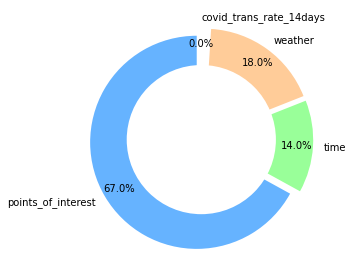

In [ ]:
# Pie chart
labels = df_features_importance['type'].tolist()
sizes = df_features_importance['importance'].tolist()

#colors
colors = ['#ff9999','#66b3ff','#99ff99','#ffcc99']
#explsion
explode = (0.05,0.05,0.05,0.05)
 
plt.pie(sizes, colors = colors, labels=labels, autopct='%1.1f%%', startangle=90, pctdistance=0.85, explode = explode)
#draw circle
centre_circle = plt.Circle((0,0),0.70,fc='white')
fig = plt.gcf()
fig.gca().add_artist(centre_circle)
 
plt.tight_layout()
plt.show()

Points of interest are clearly the most weigthed variable affecting the traffic flow intensity. In the next steps we will try to crumble which are those points of interest with higher impact in our model 

## **Section set-up**


In [ ]:
##Importing required libraries
import pandas as pd
from sklearn import preprocessing
import numpy as np
import pandas as pd
import plotly.express as px
import pickle

## **Normalizing and standardizing POIs Absolute Values**

We need to normalize and standardize previously calculated POIs absolute values. These are distributed according to a **'long-tail'**. We need to perform the appropriate transformations to leverage standard tools such as regression. 

For this purporse, we have designed a two stepts approach:
1. Box-Cox power law transform
2. Standarization between 0 and 1

In [ ]:
#Reading the POIs absolute value file
pois = pd.read_excel('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/pois_sensor_absoluteValues.xlsx')

In [ ]:
#Transposing the matrix and froping unwanted columns
pois = pois.T
pois.columns = pois.iloc[0,:]
pois.drop(index=pois.index[0], 
        axis=0, 
        inplace=True)
pois

Unnamed: 0,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Pousadas of Portugal,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Marinas and Ports,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
CT10Z2,55,2,65,4,7,13,27,0,4,16,0,10,0,0,1,4,6,4,3,6,9,2,9,0,8,5,5,2,4,1,0,7,5,10,0,4,25,4,0,7,2,10,0,3,3,0,3,5,1,4,2
CT10Z3,61,2,106,5,5,19,43,0,5,27,0,8,0,3,3,2,8,8,5,28,22,0,8,0,11,8,4,3,6,2,0,8,7,10,0,2,30,5,0,14,1,5,0,2,2,2,3,10,2,10,3
CT10Z4,21,3,19,1,5,1,10,0,4,1,0,2,0,2,0,3,1,1,0,2,2,0,2,1,4,2,2,1,3,7,0,3,0,4,0,3,9,3,0,6,1,1,0,2,0,1,1,1,0,2,0
CT10Z5,16,3,17,1,3,1,6,0,7,1,0,4,0,2,0,5,0,0,0,1,3,1,4,0,15,2,4,2,3,4,0,2,1,7,0,1,5,2,0,7,2,1,0,1,4,1,0,2,0,5,0
CT10Z8,17,2,10,1,5,0,7,0,3,0,0,2,0,1,0,1,1,0,0,2,1,0,2,1,4,2,1,1,2,5,0,2,0,0,0,2,11,4,0,3,1,1,0,3,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CT9Z7,6,1,6,1,9,3,2,0,3,2,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,2,0,7,0,0,1,0,1,0,0,11,2,0,2,0,2,0,5,0,1,1,0,0,0,0
CT9Z8,17,2,10,0,5,0,7,0,3,0,0,2,0,1,1,1,1,0,0,2,1,0,2,1,4,2,1,1,2,5,0,2,0,0,0,2,10,4,0,3,1,1,0,3,0,0,0,1,0,0,0
CT9Z9,12,0,6,0,7,0,11,0,1,11,0,2,0,1,1,0,3,2,0,6,9,0,2,0,4,5,3,1,5,1,0,2,0,1,0,1,18,3,0,4,1,5,0,3,1,0,0,0,0,2,0
CT7Z10,1,1,13,1,2,0,0,0,2,0,0,0,0,2,0,0,0,0,0,0,1,0,0,0,0,2,1,0,1,1,0,0,1,0,0,0,4,2,0,3,1,0,0,0,0,0,1,0,0,0,0


In [ ]:
#As a pre-requisite of Box-Cox, we delete all columns containing 0s only
for i in pois.columns:
  if pois[i].max() == 0:
    print(i)
    pois.drop(i, axis='columns', inplace=True)

pois

Pousadas of Portugal
Marinas and Ports


Unnamed: 0,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
CT10Z2,55,2,65,4,7,13,27,0,4,16,0,10,0,1,4,6,4,3,6,9,2,9,0,8,5,5,2,4,1,0,7,5,10,0,4,25,4,0,7,2,10,3,3,0,3,5,1,4,2
CT10Z3,61,2,106,5,5,19,43,0,5,27,0,8,3,3,2,8,8,5,28,22,0,8,0,11,8,4,3,6,2,0,8,7,10,0,2,30,5,0,14,1,5,2,2,2,3,10,2,10,3
CT10Z4,21,3,19,1,5,1,10,0,4,1,0,2,2,0,3,1,1,0,2,2,0,2,1,4,2,2,1,3,7,0,3,0,4,0,3,9,3,0,6,1,1,2,0,1,1,1,0,2,0
CT10Z5,16,3,17,1,3,1,6,0,7,1,0,4,2,0,5,0,0,0,1,3,1,4,0,15,2,4,2,3,4,0,2,1,7,0,1,5,2,0,7,2,1,1,4,1,0,2,0,5,0
CT10Z8,17,2,10,1,5,0,7,0,3,0,0,2,1,0,1,1,0,0,2,1,0,2,1,4,2,1,1,2,5,0,2,0,0,0,2,11,4,0,3,1,1,3,0,0,0,1,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CT9Z7,6,1,6,1,9,3,2,0,3,2,0,0,0,0,0,0,0,1,0,1,0,0,0,0,1,2,0,7,0,0,1,0,1,0,0,11,2,0,2,0,2,5,0,1,1,0,0,0,0
CT9Z8,17,2,10,0,5,0,7,0,3,0,0,2,1,1,1,1,0,0,2,1,0,2,1,4,2,1,1,2,5,0,2,0,0,0,2,10,4,0,3,1,1,3,0,0,0,1,0,0,0
CT9Z9,12,0,6,0,7,0,11,0,1,11,0,2,1,1,0,3,2,0,6,9,0,2,0,4,5,3,1,5,1,0,2,0,1,0,1,18,3,0,4,1,5,3,1,0,0,0,0,2,0
CT7Z10,1,1,13,1,2,0,0,0,2,0,0,0,2,0,0,0,0,0,0,1,0,0,0,0,2,1,0,1,1,0,0,1,0,0,0,4,2,0,3,1,0,0,0,0,1,0,0,0,0


In the next steps, we will be implementing a method for automatically transforming a full Dataframe via Box-Cox

In [ ]:
#BoxCox for all columns within a DF
import scipy
for i in range(len(pois.columns)):
  print(pois.columns[i])
  array = np.array(pois.iloc[:, i]).astype(float)
  array[array == 0] = 0.001
  pois[pois.columns[i]] = scipy.stats.boxcox(array)[0]

Restaurants
Shopping centres
Shops
Fairs and Markets
Petrol station
Cafes
Hotels
Wine Cellars & Quintas
Museums & Thematic Centres
Local accommodations
Fado houses
Religious temples
Tea house
Police stations and fire station
Libraries, archives and documentation centres
Guest houses
Youth hostels
Club
Bar
Statues, Sculptures & Fountains
Bridges
Monuments
Casinos, bingo and arcade
Exhibition centers & art galleries
Hospitals, health centres and clinics
Gardens and Parks
Concert halls
Car assistance
Embassies and consulates
Tourism offices
Rentals
Theatres
Tourist apartments
Airports, Airfields and Heliports
Spas, saunas and hot springs
Pharmacies
Post offices
Beaches
Car park
Cemeteries
Transport company
Sports facility
View points
Cinema
Citizens advice
Roads and squares
Ice cream parlor
Education
Services


In [ ]:
#We define the names of columns and indexes, to be leveraged in the next standarization function
pois_cols = pois.columns
pois_idx = pois.index
pois_cols
pois_idx

Index(['CT10Z2', 'CT10Z3', 'CT10Z4', 'CT10Z5', 'CT10Z8', 'CT10Z9', 'CT11Z1',
       'CT11Z2', 'CT11Z3', 'CT11Z5',
       ...
       'CT8Z8', 'CT8Z9', 'CT9Z2', 'CT9Z3', 'CT9Z4', 'CT9Z7', 'CT9Z8', 'CT9Z9',
       'CT7Z10', 'CT11Z4'],
      dtype='object', length=123)

In [ ]:
#Standarization function
from sklearn import preprocessing

x = pois.iloc[:,:].values #returns a numpy array
min_max_scaler = preprocessing.MinMaxScaler()
x_scaled = min_max_scaler.fit_transform(x)
pois = pd.DataFrame(x_scaled)
pois.columns = pois_cols
pois.index = pois_idx
pois

Unnamed: 0,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
CT10Z2,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
CT10Z3,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
CT10Z4,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
CT10Z5,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
CT10Z8,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
CT9Z7,0.270805,0.584565,0.182120,0.511930,0.923064,0.583517,0.270602,0.0,0.537322,0.366069,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.683552,0.000000,0.308621,0.000000,0.000000,0.0,0.000000,0.000000,0.366129,0.000000,0.910484,0.000000,0.0,0.276483,0.000000,0.296112,0.0,0.000000,0.465784,0.434224,0.0,0.302552,0.000000,0.424898,0.889119,0.000000,0.891262,0.533278,0.000000,0.000000,0.000000,0.00000
CT9Z8,0.480803,0.766335,0.278304,0.000000,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.672140,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.437362,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
CT9Z9,0.405498,0.000000,0.182120,0.000000,

In [ ]:
#Saving the transformation to csv
pois.to_csv('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/JGL_normalized_absoluteVals')

## **Normalizing and standardizing outputs**

Similarly, we will proceed transforming de dataset via Box-Cox, followed by a standarization procedure.

In [ ]:
#First, we load the traffic_flow file, which contain the most granular level of detail
traffic_flow = pd.read_csv("/content/drive/MyDrive/WDL/Stage_2/Corrected_DBs/complete_BD_2018_21.csv")
traffic_flow

,Unnamed: 0,Unnamed: 0.1,entity_id,intensity,laneid,name,hour,day,month,year,intensity_q95,date,weekday
0,0,0,CT2Z9,28,1,R. Constituição - Faria Guimarães,3,31,12,2017,38.00,2017-12-31,6
1,1,1,CT2Z9,16,1,R. Constituição - Faria Guimarães,4,31,12,2017,36.50,2017-12-31,6
2,2,2,CT3Z9,16,1,R. Faria Guimarães - Constituição,10,31,12,2017,20.00,2017-12-31,6
3,3,3,CT3Z9,22,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
4,4,4,CT3Z9,29,1,R. Faria Guimarães - Constituição,11,31,12,2017,30.00,2017-12-31,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...
24551012,1635652,1778486,CT18Z1,22,1,Av. Rodrigues de Freitas,10,19,3,2021,26.35,2021-03-19,4
24551013,1635653,1778487,CT8Z1,69,1,R. Fontainhas,10,19,3,2021,75.90,2021-03-19,4
24551014,1635654,1778488,CT9Z7,18,1,Av. Fernão Magalhães N-S - Túnel,10,19,3,2021,24.35,2021-03-19,4
24551015,1635655,1778489,CT13Z9,19,1,R. Antero Quental - Constituição - S-N,10,19,3,2021,26.15,2021-03-19,4


In [ ]:
#Through the following procedure, we normalize the dataset via Box-Cox followed by a Standarization
for i in traffic_flow['entity_id'].unique():
  print(i)
  sensor = traffic_flow[traffic_flow['entity_id'] == i]['intensity']
  if len(sensor.unique()) > 1:
    
    array = sensor.astype(float)

    array[array == 0] = 0.001
    array = scipy.stats.boxcox(array)[0]
    x = array.reshape(-1, 1)
    x
    min_max_scaler = preprocessing.MinMaxScaler()
    x_scaled = min_max_scaler.fit_transform(x)
    traffic_flow.loc[traffic_flow.entity_id == i, 'intensity_norm'] = x_scaled
    print('OK')
  else: print('Delete', i, 'from dataset!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!!')

  

CT2Z9
OK
CT3Z9
OK
CT2Z8
OK
CT4Z2
OK
CT2Z7
OK
CT13Z2
OK
CT19Z1
OK
CT20Z1
OK
CT7Z1
OK
CT7Z7
OK
CT10Z8
OK
CT12Z2
OK
CT3Z8
OK
CT1Z8
OK
CT1Z5
OK
CT5Z5
OK
CT5Z3
OK
CT11Z1
OK
CT3Z4
OK
CT3Z5
OK
CT8Z1
OK
CT18Z1
OK
CT18Z3
OK
CT10Z5
OK
CT11Z3
OK
CT4Z10
OK
CT9Z8
OK
CT11Z9
OK
CT9Z3
OK
CT9Z9
OK
CT11Z8
OK
CT5Z10
OK
CT9Z7
OK
CT2Z5
OK
CT22Z3
OK
CT3Z7
OK
CT3Z6
OK
CT4Z9
OK
CT14Z9
OK
CT4Z3
OK
CT15Z9
OK
CT17Z3
OK
CT6Z3
OK
CT6Z1
OK
CT1Z10
OK
CT10Z4
OK
CT15Z3
OK
CT7Z5
OK
CT8Z7
OK
CT8Z5
OK
CT13Z1
OK
CT13Z9
OK
CT12Z5
OK
CT5Z4
OK
CT15Z2
OK
CT5Z7
OK
CT7Z3
OK
CT10Z9
OK
CT12Z1
OK
CT12Z3
OK
CT6Z5
OK
CT6Z4
OK
CT9Z2
OK
CT4Z8
OK
CT4Z6
OK
CT6Z7
OK
CT13Z3
OK
CT6Z8
OK
CT3Z3
OK
CT8Z8
OK
CT3Z10
OK
CT6Z9
OK
CT7Z9
OK
CT8Z9
OK
CT3Z2
OK
CT6Z2
OK
CT2Z6
OK
CT14Z3
OK
CT4Z7
OK
CT16Z2
OK
CT12Z9
OK
CT4Z5
OK
CT1Z4
OK
CT1Z7
OK
CT5Z8
OK
CT5Z6
OK
CT8Z2
OK
CT5Z9
OK
CT7Z8
OK
CT4Z4
OK
CT2Z3
OK
CT16Z3
OK
CT14Z1
OK
CT10Z2
OK
CT1Z6
OK
CT21Z3
OK
CT2Z2
OK
CT1Z9
OK
CT11Z5
OK
CT1Z2
OK
CT14Z2
OK
CT11Z2
OK
CT19Z3
OK
CT10Z3
OK
CT1Z3
OK
CT8Z3
OK
CT17

In [ ]:
#We delete non-constant elements since there is no intensity_norm
traffic_flow = traffic_flow[traffic_flow['entity_id'] != 'testsixsq']
traffic_flow = traffic_flow[traffic_flow['entity_id'] != 'CT21Z1']
traffic_flow = traffic_flow[traffic_flow['entity_id'] != 'CT2Z4']

In [ ]:
#We check that max and min equals 1 and 0 respectively
traffic_flow.groupby(by=["entity_id", "laneid", "name"]).intensity_norm.agg(['max', 'min', 'mean'])

,,,max,min,mean
entity_id,laneid,name,,,
CT10Z2,1,R. Fernandes Tomás - 24 de Agosto,1.0,0.0,0.134336
CT10Z3,1,R. Camões - N-S,1.0,0.0,0.241881
CT10Z4,1,Av. Boavista - Casa da Música - E-O,1.0,0.0,0.262396
CT10Z5,1,Via Panorâmica - Faixa BUS,1.0,0.0,0.254406
CT10Z8,1,Av.Sidónio Pais - Cruzamento - O-E,1.0,0.0,0.250762
...,...,...,...,...,...
urn:ngsi-ld:TrafficFlowObserved:porto:traffic:VolumLight:0_2,2,Av. Sidónio Pais - Câmara,1.0,0.0,0.111584
urn:ngsi-ld:TrafficFlowObserved:porto:traffic:VolumLight:0_3,3,Av. Sidónio Pais - Câmara,1.0,0.0,0.069913
urn:ngsi-ld:TrafficFlowObserved:porto:traffic:VolumLight:0_4,4,Av. Sidónio Pais - Câmara,1.0,0.0,0.089106


In [ ]:
#We save the results
traffic_flow.to_csv('/content/drive/MyDrive/WDL/normalized_completeDB.csv')

## **Heatmap by week**

In [ ]:
#We load the dataset
traffic_flow = pd.read_csv('/content/drive/MyDrive/normalized_completeDB.csv')
traffic_flow

In [ ]:
#We group hours into 6 buckets
traffic_flow.loc[traffic_flow['hour'].isin([0,1,2,3]), 'hour_group'] = '[0-3]'
traffic_flow.loc[traffic_flow['hour'].isin([4,5,6,7]), 'hour_group'] = '[4-7]'
traffic_flow.loc[traffic_flow['hour'].isin([8,9,10,11]), 'hour_group'] = '[8-11]'
traffic_flow.loc[traffic_flow['hour'].isin([12,13,14,15]), 'hour_group'] = '[12-15]'
traffic_flow.loc[traffic_flow['hour'].isin([16,17,18,19]), 'hour_group'] = '[16-19]'
traffic_flow.loc[traffic_flow['hour'].isin([20,21,22,23]), 'hour_group'] = '[20-23]'

In [ ]:
#Now, we group de DB by "entity_id", "month", "weekday", "hour_group"
traffic_flow_month = traffic_flow.groupby(by=["entity_id", "month", "weekday", "hour_group"]).intensity_norm.agg(['sum', 'mean', 'std'])
traffic_flow_month

sum  ...       std
entity_id                                          month weekday hour_group              ...          
CT10Z2                                             1     0       [0-3]        17.091738  ...  0.065101
                                                                 [12-15]      52.256575  ...  0.057791
                                                                 [16-19]      52.263842  ...  0.062094
                                                                 [20-23]      47.374849  ...  0.062506
                                                                 [4-7]        25.597579  ...  0.071652
...                                                                                 ...  ...       ...
urn:ngsi-ld:TrafficFlowObserved:porto:traffic:V... 12    6       [12-15]     130.129533  ...  0.312829
                                                                 [16-19]     118.499089  ...  0.326793
                                                                 [20-23]      30.321628  ...  0.304447
                                                                 [4-7]        15.338476  ...  0.273447
                                                                 [8-11]       60.778541  ...  0.287381

[55248 rows x 3 columns]

In [ ]:
#Pivot the table taking entity_id as an index
traffic_flow_pivot_week = traffic_flow_month.pivot_table(index = 'entity_id', columns='weekday', values = 'mean').reset_index()
traffic_flow_pivot_week

weekday,entity_id,0,1,2,3,4,5,6
0,CT10Z2,0.131551,0.131456,0.130256,0.135480,0.135473,0.123056,0.111936
1,CT10Z3,0.232460,0.236315,0.232302,0.243073,0.252177,0.202934,0.162575
2,CT10Z4,0.223158,0.230432,0.231671,0.228798,0.234145,0.187617,0.146272
3,CT10Z5,0.236650,0.240857,0.248821,0.249488,0.257755,0.182599,0.127600
4,CT10Z8,0.247997,0.247419,0.249705,0.252729,0.258180,0.240070,0.212948
...,...,...,...,...,...,...,...,...
116,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.104900,0.104019,0.107947,0.108979,0.122922,0.088958,0.074569
117,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.066499,0.066079,0.067873,0.068318,0.084795,0.063176,0.051802
118,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.083516,0.082783,0.085499,0.087419,0.102681,0.075516,0.060798
119,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.128483,0.127718,0.130984,0.131643,0.145758,0.099143,0.077797


In [ ]:
#Load the pois dataset
pois = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/JGL_normalized_absoluteVals')
pois = pois.rename(columns={'Unnamed: 0': 'entity_id'})
pois

,entity_id,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
1,CT10Z3,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
2,CT10Z4,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
3,CT10Z5,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
4,CT10Z8,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118,CT9Z7,0.270805,0.584565,0.182120,0.511930,0.923064,0.583517,0.270602,0.0,0.537322,0.366069,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.683552,0.000000,0.308621,0.000000,0.000000,0.0,0.000000,0.000000,0.366129,0.000000,0.910484,0.000000,0.0,0.276483,0.000000,0.296112,0.0,0.000000,0.465784,0.434224,0.0,0.302552,0.000000,0.424898,0.889119,0.000000,0.891262,0.533278,0.000000,0.000000,0.000000,0.00000
119,CT9Z8,0.480803,0.766335,0.278304,0.000000,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.672140,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.437362,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
120,CT9Z9,0.405498,0

In [ ]:
#Merge traffic flows per month with POIs and save it as a dataframe
traffic_pois_week = pd.merge(traffic_flow_pivot_week, pois, on= 'entity_id', how='left')
traffic_pois_week.to_csv('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/traffic_pois_week.csv')
traffic_pois_week

,entity_id,0,1,2,3,4,5,6,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.131551,0.131456,0.130256,0.135480,0.135473,0.123056,0.111936,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
1,CT10Z3,0.232460,0.236315,0.232302,0.243073,0.252177,0.202934,0.162575,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
2,CT10Z4,0.223158,0.230432,0.231671,0.228798,0.234145,0.187617,0.146272,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
3,CT10Z5,0.236650,0.240857,0.248821,0.249488,0.257755,0.182599,0.127600,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
4,CT10Z8,0.247997,0.247419,0.249705,0.252729,0.258180,0.240070,0.212948,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.104900,0.104019,0.107947,0.108979,0.122922,0.088958,0.074569,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
117,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.066499,0.066079,0.067873,0.068318,0.084795,0.063176,0.051802,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,N

In [ ]:
#Define the columns of the new dataframe
#Creating a new dataframe
columns = traffic_pois_week.columns[8:].values
columns =['Week'] + columns.tolist()
columns
regressionHeatmap_week = pd.DataFrame(columns=columns)
columns


['Week',
 'Restaurants',
 'Shopping centres',
 'Shops',
 'Fairs and Markets',
 'Petrol station',
 'Cafes',
 'Hotels',
 'Wine Cellars & Quintas',
 'Museums & Thematic Centres',
 'Local accommodations',
 'Fado houses',
 'Religious temples',
 'Tea house',
 'Police stations and fire station',
 'Libraries, archives and documentation centres',
 'Guest houses',
 'Youth hostels',
 'Club',
 'Bar',
 'Statues, Sculptures & Fountains',
 'Bridges',
 'Monuments',
 'Casinos, bingo and arcade',
 'Exhibition centers & art galleries',
 'Hospitals, health centres and clinics',
 'Gardens and Parks',
 'Concert halls',
 'Car assistance',
 'Embassies and consulates',
 'Tourism offices',
 'Rentals',
 'Theatres',
 'Tourist apartments',
 'Airports, Airfields and Heliports',
 'Spas, saunas and hot springs',
 'Pharmacies',
 'Post offices',
 'Beaches',
 'Car park',
 'Cemeteries',
 'Transport company',
 'Sports facility',
 'View points',
 'Cinema',
 'Citizens advice',
 'Roads and squares',
 'Ice cream parlor',
 'Ed

In [ ]:
#We make NaN imputation 
#from sklearn.impute import SimpleImputer
#imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
#imp_mean.fit(traffic_pois.iloc[:,2:])
#Delete Full NaN rows
traffic_pois_week = traffic_pois_week[:115]

In [ ]:
#Fill column NaNs
traffic_pois_week.fillna(traffic_pois_week.mean(), inplace=True)

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:4536: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
traffic_pois_week

,entity_id,0,1,2,3,4,5,6,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.131551,0.131456,0.130256,0.135480,0.135473,0.123056,0.111936,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.000000,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.916830
1,CT10Z3,0.232460,0.236315,0.232302,0.243073,0.252177,0.202934,0.162575,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.000000,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.965490
2,CT10Z4,0.223158,0.230432,0.231671,0.228798,0.234145,0.187617,0.146272,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.000000,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.000000
3,CT10Z5,0.236650,0.240857,0.248821,0.249488,0.257755,0.182599,0.127600,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.000000,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.000000
4,CT10Z8,0.247997,0.247419,0.249705,0.252729,0.258180,0.240070,0.212948,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.000000,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110,CT9Z3,0.165380,0.174138,0.173727,0.179433,0.187859,0.186191,0.151755,0.844708,0.895855,0.925926,0.935298,0.498334,0.960512,0.936095,0.0,0.723217,0.892135,0.0,0.765749,0.886246,0.922714,0.706984,0.822487,0.972126,0.964007,0.890000,0.858881,0.000000,0.726614,0.0,0.931717,0.799509,0.711500,0.865751,0.817046,0.385236,0.936584,0.768083,0.914110,0.737261,0.0,0.559149,0.923049,0.628135,0.0,0.887654,0.793673,0.592026,0.492031,0.577623,1.000000,1.000000,0.918605,0.955914,0.

In [ ]:
#We create the for loop:
import sklearn
from sklearn.linear_model import LinearRegression
for i in range(len(traffic_pois_week.iloc[:, 1:8].columns)):
  print(traffic_pois_week.iloc[:, 1:8].columns[i])
  reg = LinearRegression(fit_intercept=False).fit(traffic_pois_week[traffic_pois_week.columns[8:]] ,traffic_pois_week[traffic_pois_week.iloc[:, 1:8].columns[i]])
  regression = pd.Series([traffic_pois_week.iloc[:, 1:8].columns[i]] + reg.coef_.tolist(), index=columns)
  print(regression)
  regressionHeatmap_week = regressionHeatmap_week.append(regression, ignore_index=True)
  print('OK')

regressionHeatmap_week
  

0
Week                                             0.000000
Restaurants                                     -0.252505
Shopping centres                                 0.044034
Shops                                           -0.086175
Fairs and Markets                                0.199720
Petrol station                                   0.025825
Cafes                                           -0.098839
Hotels                                          -0.901615
Wine Cellars & Quintas                           0.318567
Museums & Thematic Centres                      -0.402386
Local accommodations                             0.099630
Fado houses                                     -0.073796
Religious temples                               -0.026962
Tea house                                        0.059636
Police stations and fire station                 0.121392
Libraries, archives and documentation centres    0.196535
Guest houses                                    -0.077830
Youth hostel

,Week,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,0.0,-0.252505,0.044034,-0.086175,0.199720,0.025825,-0.098839,-0.901615,0.318567,-0.402386,0.099630,-0.073796,-0.026962,0.059636,0.121392,0.196535,-0.077830,-0.240751,0.101404,0.789231,0.424538,0.059247,-0.539818,0.028599,0.043024,0.125261,0.309539,-0.132720,-0.095903,0.374041,0.103123,-0.286516,-0.200353,0.137576,-0.213558,-0.094831,0.574257,-0.044886,0.743578,-0.732417,0.186591,0.399407,0.110879,-0.097569,0.013350,0.088852,0.435938,-0.395589,0.018632,0.250444
1,1.0,-0.109345,0.144789,-0.190069,0.164732,0.048603,-0.165010,-1.146697,0.266443,-0.329656,-0.017104,-0.023953,-0.356307,0.161636,0.203400,0.214519,-0.034672,-0.294018,0.156357,0.741894,0.225453,0.053008,-0.597721,0.062100,-0.017303,0.323781,0.370998,-0.019738,-0.153494,0.397614,0.119583,-0.265854,-0.323248,0.257309,-0.153648,-0.113983,0.574218,0.025864,0.803252,-0.918973,0.240702,0.531763,0.079800,-0.007961,0.030354,0.130937,0.379027,-0.303810,0.157784,0.328775
2,2.0,-0.340491,0.123654,-0.136524,0.159879,0.028445,-0.164371,-1.107446,0.308161,-0.234265,-0.106105,-0.022194,-0.400353,0.103270,0.208583,0.207547,-0.004261,-0.161258,0.141642,0.703920,0.113432,0.044239,-0.565939,0.059343,0.061952,0.216063,0.308572,-0.038757,-0.116571,0.430164,0.104011,-0.273582,-0.296530,0.247571,-0.201145,-0.119450,0.786156,-0.020683,0.820230,-0.898234,0.257775,0.581902,0.076936,0.035533,0.050533,0.070593,0.408671,-0.281435,0.152295,0.317028
3,3.0,-0.009053,0.067334,-0.372310,0.248360,0.236444,-0.115875,-0.938656,0.254698,-0.395019,0.070248,-0.031658,-0.094045,0.103701,0.159495,0.263978,-0.059146,-0.210389,0.057256,0.794729,0.271681,0.040249,-0.533281,0.069493,0.018975,0.149269,0.322495,-0.163561,-0.136666,0.361440,0.129871,-0.354800,-0.174492,0.236069,-0.156408,-0.175180,0.596667,-0.009678,0.700420,-0.691012,0.170983,0.223668,0.040577,-0.001306,-0.003804,0.070199,0.339754,-0.269035,0.040986,0.275061
4,4.0,-0.061936,0.066587,-0.342470,0.258844,0.251262,-0.105573,-0.931563,0.241617,-0.413448,0.092031,-0.026683,-0.110256,0.121657,0.167860,0.277469,-0.063590,-0.214252,0.059769,0.808961,0.270598,0.034486,-0.532074,0.066512,0.032676,0.152265,0.346938,-0.161443,-0.151782,0.371170,0.131208,-0.372380,-0.166312,0.250270,-0.147113,-0.169764,0.585159,-0.006102,0.701764,-0.732909,0.170970,0.232858,0.051952,-0.009034,-0.006700,0.065158,0.347577,-0.277872,0.016728,0.270339
5,5.0,-0.125284,0.051092,-0.373453,0.255326,0.227845,-0.100889,-1.051325,0.183064,-0.399141,0.077211,-0.024285,-0.142795,0.105671,0.180787,0.277343,-0.036058,-0.159813,0.085426,0.726804,0.274795,0.033085,-0.488159,0.086318,0.100215,0.113052,0.329500,-0.139436,-0.156328,0.360105,0.137062,-0.382055,-0.165933,0.255997,-0.093548,-0.148873,0.697472,0.013469,0.658712,-0.719731,0.145439,0.226404,0.052282,0.015633,-0.000324,0.059081,0.353744,-0.252859,0.019861,0.250329
6,6.0,-0.069040,0.073462,-0.323714,0.203273,0.216011,-0.139369,-1.062643,0.136028,-0.365406,0.063656,-0.024754,-0.081023,0.089657,0.166493,0.243750,-0.017309,-0.142483,0.083118,0.686904,0.221553,0.020455,-0.452824,0.082923,0.066265,0.115386,0.299030,-0.116345,-0.120072,0.314441,0.122621,-0.402376,-0.119757,0.264196,-0.062803,-0.111555,0.620508,0.002868,0.624

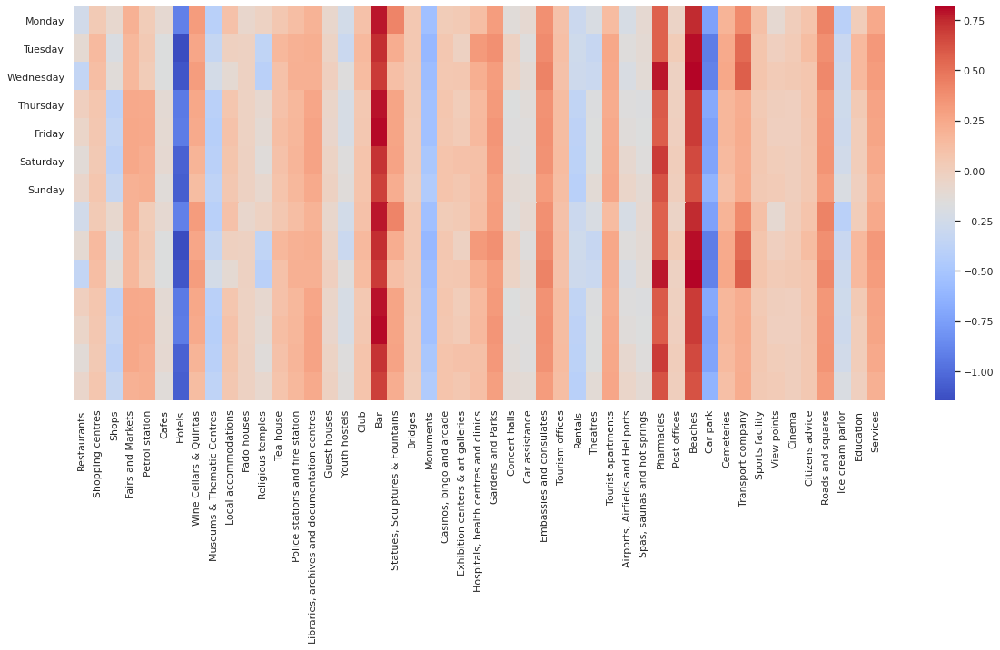

In [ ]:
#We visualize the result in a heatmap 
import numpy as np; np.random.seed(0)
import seaborn as sns; sns.set_theme()
plt.figure(figsize=(20, 8))
y_axis_labels = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'] 
ax = sns.heatmap(regressionHeatmap_week.iloc[:,1:], yticklabels=y_axis_labels, cmap='coolwarm')



## **Heatmap by month**

In [ ]:
#We load the database if required
traffic_flow = pd.read_csv('/content/drive/MyDrive/normalized_completeDB.csv')
traffic_flow

In [ ]:
#Divide the hours into 6 buckets
traffic_flow.loc[traffic_flow['hour'].isin([0,1,2,3]), 'hour_group'] = '[0-3]'
traffic_flow.loc[traffic_flow['hour'].isin([4,5,6,7]), 'hour_group'] = '[4-7]'
traffic_flow.loc[traffic_flow['hour'].isin([8,9,10,11]), 'hour_group'] = '[8-11]'
traffic_flow.loc[traffic_flow['hour'].isin([12,13,14,15]), 'hour_group'] = '[12-15]'
traffic_flow.loc[traffic_flow['hour'].isin([16,17,18,19]), 'hour_group'] = '[16-19]'
traffic_flow.loc[traffic_flow['hour'].isin([20,21,22,23]), 'hour_group'] = '[20-23]'

In [ ]:
#Grouping the DB by "entity_id", "month", "weekday", "hour_group"
traffic_flow_month = traffic_flow.groupby(by=["entity_id", "month", "weekday", "hour_group"]).intensity_norm.agg(['sum', 'mean', 'std'])
traffic_flow_month

sum  ...       std
entity_id                                          month weekday hour_group              ...          
CT10Z2                                             1     0       [0-3]        17.091738  ...  0.065101
                                                                 [12-15]      52.256575  ...  0.057791
                                                                 [16-19]      52.263842  ...  0.062094
                                                                 [20-23]      47.374849  ...  0.062506
                                                                 [4-7]        25.597579  ...  0.071652
...                                                                                 ...  ...       ...
urn:ngsi-ld:TrafficFlowObserved:porto:traffic:V... 12    6       [12-15]     130.129533  ...  0.312829
                                                                 [16-19]     118.499089  ...  0.326793
                                                                 [20-23]      30.321628  ...  0.304447
                                                                 [4-7]        15.338476  ...  0.273447
                                                                 [8-11]       60.778541  ...  0.287381

[55248 rows x 3 columns]

In [ ]:
#Pivoting the table, taking entity_id as index and month as the key column
traffic_flow_pivot_month = traffic_flow_month.pivot_table(index = 'entity_id', columns='month', values = 'mean').reset_index()
traffic_flow_pivot_month

month,entity_id,1,2,3,4,5,6,7,8,9,10,11,12
0,CT10Z2,0.132187,0.129253,0.103826,0.139227,0.126380,0.122838,0.132074,0.139762,0.136786,0.131073,0.126636,0.121456
1,CT10Z3,0.211862,0.214478,0.243645,0.227596,0.225604,0.240494,0.229851,0.215507,0.223811,0.226854,0.215332,0.202399
2,CT10Z4,0.255498,0.260973,0.205303,0.166164,0.202973,0.206718,0.179376,0.179543,0.184227,0.176546,0.245169,0.278242
3,CT10Z5,0.221622,0.226952,0.210494,0.199889,0.220581,0.216141,0.231057,0.185727,0.241855,0.239522,0.224321,0.228304
4,CT10Z8,0.289549,0.269077,0.248157,0.234016,0.228860,0.246651,0.235881,0.216622,0.236392,0.235887,0.218766,0.269940
...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.111397,0.111054,0.111162,0.046838,0.070364,NaN,0.111163,0.100205,0.112396,0.115560,0.115963,0.113996
117,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.071765,0.072729,0.079026,0.030773,0.046671,NaN,0.073597,0.068730,0.073032,0.074308,0.072821,0.073448
118,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.089961,0.089926,0.097634,0.040844,0.060800,NaN,0.084669,0.077839,0.094034,0.091728,0.090204,0.091910
119,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.128527,0.130336,0.133265,0.056610,0.083119,NaN,0.140831,0.122470,0.131975,0.134563,0.131502,0.130528


In [ ]:
#Loading the csv if required
pois = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/JGL_normalized_absoluteVals')
pois = pois.rename(columns={'Unnamed: 0': 'entity_id'})
pois

,entity_id,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
1,CT10Z3,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
2,CT10Z4,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
3,CT10Z5,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
4,CT10Z8,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118,CT9Z7,0.270805,0.584565,0.182120,0.511930,0.923064,0.583517,0.270602,0.0,0.537322,0.366069,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.683552,0.000000,0.308621,0.000000,0.000000,0.0,0.000000,0.000000,0.366129,0.000000,0.910484,0.000000,0.0,0.276483,0.000000,0.296112,0.0,0.000000,0.465784,0.434224,0.0,0.302552,0.000000,0.424898,0.889119,0.000000,0.891262,0.533278,0.000000,0.000000,0.000000,0.00000
119,CT9Z8,0.480803,0.766335,0.278304,0.000000,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.672140,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.437362,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
120,CT9Z9,0.405498,0

In [ ]:
#Merging the dataframes into one and saving
traffic_pois_month = pd.merge(traffic_flow_pivot_month, pois, on= 'entity_id', how='left')
traffic_pois_month.to_csv('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/traffic_pois_month.csv')
traffic_pois_month

,entity_id,1,2,3,4,5,6,7,8,9,10,11,12,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.132187,0.129253,0.103826,0.139227,0.126380,0.122838,0.132074,0.139762,0.136786,0.131073,0.126636,0.121456,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
1,CT10Z3,0.211862,0.214478,0.243645,0.227596,0.225604,0.240494,0.229851,0.215507,0.223811,0.226854,0.215332,0.202399,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
2,CT10Z4,0.255498,0.260973,0.205303,0.166164,0.202973,0.206718,0.179376,0.179543,0.184227,0.176546,0.245169,0.278242,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
3,CT10Z5,0.221622,0.226952,0.210494,0.199889,0.220581,0.216141,0.231057,0.185727,0.241855,0.239522,0.224321,0.228304,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
4,CT10Z8,0.289549,0.269077,0.248157,0.234016,0.228860,0.246651,0.235881,0.216622,0.236392,0.235887,0.218766,0.269940,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.111397,0.111054,0.111162,0.046838,0.070364,NaN,0.111163,0.100205,0.112396,0.115560,0.115963,0.113996,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,

In [ ]:
#Define the columns of the new dataframe
#Creating a new dataframe
columns = traffic_pois_month.columns[13:].values
columns =['Month'] + columns.tolist()
columns
regressionHeatmap_month = pd.DataFrame(columns=columns)
columns


['Month',
 'Restaurants',
 'Shopping centres',
 'Shops',
 'Fairs and Markets',
 'Petrol station',
 'Cafes',
 'Hotels',
 'Wine Cellars & Quintas',
 'Museums & Thematic Centres',
 'Local accommodations',
 'Fado houses',
 'Religious temples',
 'Tea house',
 'Police stations and fire station',
 'Libraries, archives and documentation centres',
 'Guest houses',
 'Youth hostels',
 'Club',
 'Bar',
 'Statues, Sculptures & Fountains',
 'Bridges',
 'Monuments',
 'Casinos, bingo and arcade',
 'Exhibition centers & art galleries',
 'Hospitals, health centres and clinics',
 'Gardens and Parks',
 'Concert halls',
 'Car assistance',
 'Embassies and consulates',
 'Tourism offices',
 'Rentals',
 'Theatres',
 'Tourist apartments',
 'Airports, Airfields and Heliports',
 'Spas, saunas and hot springs',
 'Pharmacies',
 'Post offices',
 'Beaches',
 'Car park',
 'Cemeteries',
 'Transport company',
 'Sports facility',
 'View points',
 'Cinema',
 'Citizens advice',
 'Roads and squares',
 'Ice cream parlor',
 'E

In [ ]:
#We make NaN imputation 
#from sklearn.impute import SimpleImputer
#imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
#imp_mean.fit(traffic_pois.iloc[:,2:])
#Delete Full NaN rows
traffic_pois_month = traffic_pois_month[:115]

In [ ]:
#Fill column NaNs
traffic_pois_month.fillna(traffic_pois_month.mean(), inplace=True)
traffic_pois_month

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:4536: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



,entity_id,1,2,3,4,5,6,7,8,9,10,11,12,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.132187,0.129253,0.103826,0.139227,0.126380,0.122838,0.132074,0.139762,0.136786,0.131073,0.126636,0.121456,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.000000,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.916830
1,CT10Z3,0.211862,0.214478,0.243645,0.227596,0.225604,0.240494,0.229851,0.215507,0.223811,0.226854,0.215332,0.202399,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.000000,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.965490
2,CT10Z4,0.255498,0.260973,0.205303,0.166164,0.202973,0.206718,0.179376,0.179543,0.184227,0.176546,0.245169,0.278242,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.000000,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.000000
3,CT10Z5,0.221622,0.226952,0.210494,0.199889,0.220581,0.216141,0.231057,0.185727,0.241855,0.239522,0.224321,0.228304,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.000000,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.000000
4,CT10Z8,0.289549,0.269077,0.248157,0.234016,0.228860,0.246651,0.235881,0.216622,0.236392,0.235887,0.218766,0.269940,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.000000,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110,CT9Z3,0.205366,0.228384,0.231623,0.242539,0.230352,0.206865,0.072616,0.126557,0.086387,0.109375,0.175326,0.161325,0.844708,0.895855,0.925926,0.935298,0.498334,0.960512,0.936095,0.0,0.723217,0.892135,0.0,0.765749

In [ ]:
#We leverage the following method por automatically leveraing regression in all the bins
import sklearn
from sklearn.linear_model import LinearRegression
for i in range(len(traffic_pois_month.iloc[:, 1:13].columns)):
  print(traffic_pois_month.iloc[:, 1:13].columns[i])
  reg = LinearRegression(fit_intercept=False).fit(traffic_pois_month[traffic_pois_month.columns[13:]] ,traffic_pois_month[traffic_pois_month.iloc[:, 1:13].columns[i]])
  regression = pd.Series([traffic_pois_month.iloc[:, 1:13].columns[i]] + reg.coef_.tolist(), index=columns)
  print(regression)
  regressionHeatmap_month = regressionHeatmap_month.append(regression, ignore_index=True)
  print('OK')

regressionHeatmap_month

1
Month                                            1.000000
Restaurants                                     -0.118795
Shopping centres                                 0.052710
Shops                                           -0.317930
Fairs and Markets                                0.269529
Petrol station                                   0.206049
Cafes                                           -0.098153
Hotels                                          -0.954549
Wine Cellars & Quintas                           0.237178
Museums & Thematic Centres                      -0.447471
Local accommodations                             0.069785
Fado houses                                     -0.013997
Religious temples                               -0.209718
Tea house                                        0.097751
Police stations and fire station                 0.143297
Libraries, archives and documentation centres    0.179790
Guest houses                                    -0.071832
Youth hostel

In [ ]:
regressionHeatmap_month

,Month,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,1.0,-0.118795,0.052710,-0.317930,0.269529,0.206049,-0.098153,-0.954549,0.237178,-0.447471,0.069785,-0.013997,-0.209718,0.097751,0.143297,0.179790,-0.071832,-0.139816,0.089454,0.650663,0.272836,0.006204,-0.347755,0.098275,0.229469,0.061695,0.332793,-0.110226,-0.111370,0.315274,0.104605,-0.287221,-0.177647,0.208112,-0.143839,-0.115112,0.558572,0.022037,0.590353,-0.722068,0.108611,0.289880,0.053296,0.016526,-0.022878,0.054823,0.372630,-0.256714,0.029859,0.241172
1,2.0,-0.255316,0.024155,-0.229263,0.276471,0.235865,-0.108342,-0.774391,0.258399,-0.393594,0.100276,-0.062495,-0.122815,0.024251,0.145468,0.156964,-0.057764,-0.165018,0.062627,0.719300,0.315368,0.003405,-0.302961,0.072206,0.249893,-0.023305,0.258762,-0.098393,-0.078508,0.292736,0.088992,-0.292196,-0.142350,0.206232,-0.171309,-0.089963,0.424600,-0.062839,0.586842,-0.556358,0.091952,0.263213,0.054984,-0.060634,-0.032666,0.054999,0.322192,-0.255273,0.003032,0.223203
2,3.0,-0.379560,0.041496,-0.302834,0.238579,0.186879,-0.099924,-0.651599,0.249687,-0.221066,-0.028338,-0.092677,0.133760,-0.038345,0.117007,0.180711,-0.070335,-0.220792,0.082830,0.934541,0.322571,0.041349,-0.365429,0.009758,0.056153,0.045199,0.216162,-0.148444,-0.083098,0.291614,0.101143,-0.222292,-0.111100,0.149581,-0.170236,-0.157487,0.716928,-0.132200,0.623131,-0.652934,0.128021,0.082494,0.065133,-0.039352,0.001579,0.021750,0.321274,-0.297705,0.017788,0.231218
3,4.0,-0.440970,0.022665,-0.235789,0.249267,0.207282,-0.062811,-0.853197,0.273122,-0.205015,-0.022204,-0.124425,0.088019,0.021357,0.151844,0.251925,-0.014415,-0.229365,0.116208,0.820533,0.498036,0.060374,-0.407966,0.032485,-0.044761,0.047246,0.210265,-0.164003,-0.151634,0.347162,0.100848,-0.208530,-0.117618,0.132628,-0.167582,-0.152604,0.872647,-0.144050,0.577833,-0.716194,0.192955,0.040515,0.033590,-0.046959,0.001076,0.037222,0.288734,-0.308331,0.051136,0.221366
4,5.0,-0.478047,-0.018236,-0.037504,0.292344,0.266266,-0.094612,-0.982478,0.275354,-0.301454,0.053033,-0.098455,-0.251116,0.096369,0.213553,0.205262,0.002175,-0.143955,0.105780,0.465475,0.539574,0.046463,-0.348348,0.091876,0.136500,-0.038579,0.325098,-0.104985,-0.188288,0.387258,0.099065,-0.257639,-0.156757,0.187186,-0.150944,-0.103264,0.701173,-0.054697,0.486465,-0.612489,0.177681,0.098372,0.036221,-0.077994,-0.031011,0.027034,0.295843,-0.220137,0.064058,0.228491
5,6.0,-0.514519,0.095364,-0.183552,0.242722,0.283946,-0.150494,-0.766967,0.229873,-0.298283,0.097137,-0.041984,-0.084035,0.146648,0.204062,0.182018,0.004568,-0.224698,0.008545,0.689043,0.302871,0.030152,-0.390453,0.074533,0.047436,-0.010643,0.347858,-0.102315,-0.144133,0.344083,0.075542,-0.376552,-0.101299,0.313006,-0.124964,-0.097354,0.669837,-0.085252,0.676989,-0.646020,0.149182,0.135422,0.042797,-0.093041,-0.009644,0.028355,0.280858,-0.112531,-0.017614,0.228839
6,7.0,-0.403955,0.088528,-0.226094,0.231137,0.401214,-0.133667,-0.653535,0.281103,-0.190377,0.093733,-0.047161,0.026592,0.087647,0.199575,0.169452,0.086274,-0.281246,-0.058237,0.919930,0.126759,0.056074,-0.388523,0.051327,0.024820,-0.032242,0.328877,-0.110224,-0.063241,0.285595,0.026225,-0.346044,-0.024064,0.223219,-0.153284,-0.101290,0.334134,-0.11331

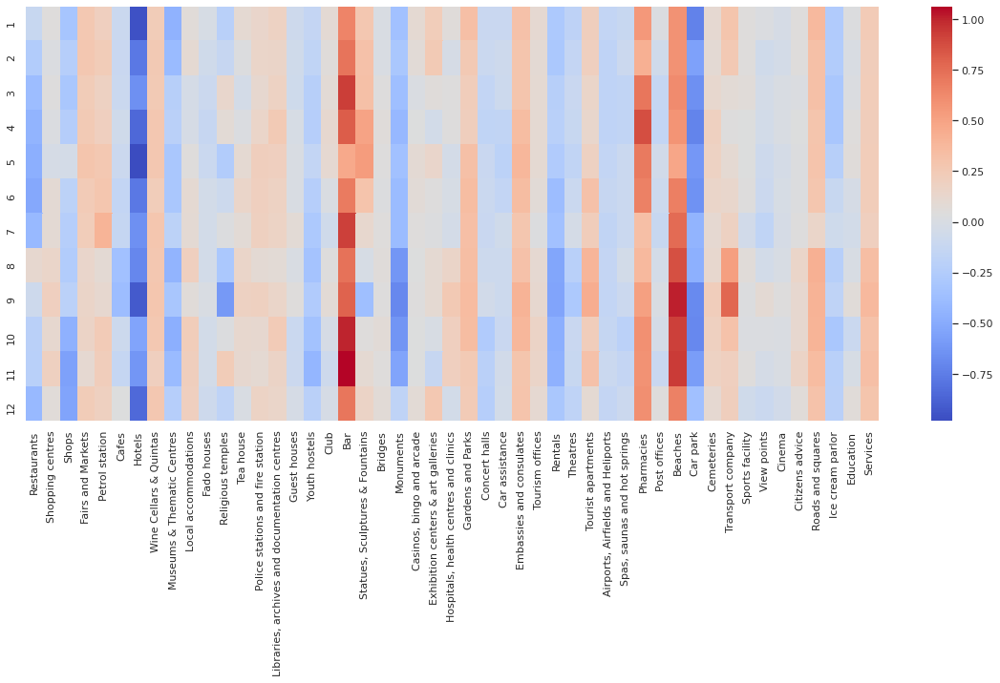

In [ ]:
#We display the information as a heatmap

import numpy as np; np.random.seed(0)
import seaborn as sns; sns.set_theme()
plt.figure(figsize=(20, 8))
y_axis_labels = [1,2,3,4,5,6,7,8,9,10,11,12] 
ax = sns.heatmap(regressionHeatmap_month.iloc[:,1:], yticklabels=y_axis_labels, cmap='coolwarm')



When assessing the traffic intensities compared with months, we can observe the influence of vacation-related categories, such as the beach, bars, restaurants, and hotels. 



We can observe the seasonality of hotels, concentrating the impact around summer and winter holidays. Additionally, it is interesting to note that hotels are negatively related to traffic intensities. This phenomenom can occur due to two reasons:


	
Causality, people don´t usually use vehicles to arrive at hotels at the city center
	Consequence, hotels are usually located in areas with low traffic volumes




Bars, located at the beach, and the beach itself, drive heavy amounts of traffic. This dynamic should be managed via a specific strategy.

Also, pharmacies drive more constant traffic but with lower oscillations.



## **Heatmap by hours**

In [ ]:
#Load the database if required
traffic_flow = pd.read_csv('/content/drive/MyDrive/normalized_completeDB.csv')
traffic_flow

In [ ]:
#We split the hours column into 6 buckets

traffic_flow.loc[traffic_flow['hour'].isin([0,1,2,3]), 'hour_group'] = '[0-3]'
traffic_flow.loc[traffic_flow['hour'].isin([4,5,6,7]), 'hour_group'] = '[4-7]'
traffic_flow.loc[traffic_flow['hour'].isin([8,9,10,11]), 'hour_group'] = '[8-11]'
traffic_flow.loc[traffic_flow['hour'].isin([12,13,14,15]), 'hour_group'] = '[12-15]'
traffic_flow.loc[traffic_flow['hour'].isin([16,17,18,19]), 'hour_group'] = '[16-19]'
traffic_flow.loc[traffic_flow['hour'].isin([20,21,22,23]), 'hour_group'] = '[20-23]'

In [ ]:
#Grouping by "entity_id", "month", "weekday", "hour_group"
traffic_flow_month = traffic_flow.groupby(by=["entity_id", "month", "weekday", "hour_group"]).intensity_norm.agg(['sum', 'mean', 'std'])
traffic_flow_month

sum  ...       std
entity_id                                          month weekday hour_group              ...          
CT10Z2                                             1     0       [0-3]        17.091738  ...  0.065101
                                                                 [12-15]      52.256575  ...  0.057791
                                                                 [16-19]      52.263842  ...  0.062094
                                                                 [20-23]      47.374849  ...  0.062506
                                                                 [4-7]        25.597579  ...  0.071652
...                                                                                 ...  ...       ...
urn:ngsi-ld:TrafficFlowObserved:porto:traffic:V... 12    6       [12-15]     130.129533  ...  0.312829
                                                                 [16-19]     118.499089  ...  0.326793
                                                                 [20-23]      30.321628  ...  0.304447
                                                                 [4-7]        15.338476  ...  0.273447
                                                                 [8-11]       60.778541  ...  0.287381

[55248 rows x 3 columns]

In [ ]:
#Pivoting, indexed at entity_id and leveraging 'hour_group' column
traffic_flow_pivot_hours = traffic_flow_month.pivot_table(index = 'entity_id', columns='hour_group', values = 'mean').reset_index()
traffic_flow_pivot_hours

hour_group,entity_id,[0-3],[12-15],[16-19],[20-23],[4-7],[8-11]
0,CT10Z2,0.060709,0.170972,0.176893,0.128433,0.066458,0.167284
1,CT10Z3,0.083657,0.292237,0.280984,0.172415,0.159468,0.349956
2,CT10Z4,0.063001,0.322347,0.357911,0.190338,0.064063,0.272706
3,CT10Z5,0.039922,0.333532,0.271224,0.160768,0.169183,0.348603
4,CT10Z8,0.134215,0.313973,0.303716,0.238959,0.165477,0.308558
...,...,...,...,...,...,...,...
116,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.027849,0.143751,0.157359,0.083584,0.059875,0.136439
117,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.016931,0.094347,0.099171,0.056501,0.043128,0.090301
118,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.024341,0.119765,0.117952,0.065335,0.053934,0.112852
119,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.028376,0.179807,0.179782,0.074635,0.087758,0.168959


In [ ]:
#Load the POI DB if required
pois = pd.read_csv('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/JGL_normalized_absoluteVals')
pois = pois.rename(columns={'Unnamed: 0': 'entity_id'})
pois

,entity_id,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
1,CT10Z3,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
2,CT10Z4,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
3,CT10Z5,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
4,CT10Z8,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
118,CT9Z7,0.270805,0.584565,0.182120,0.511930,0.923064,0.583517,0.270602,0.0,0.537322,0.366069,0.0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.683552,0.000000,0.308621,0.000000,0.000000,0.0,0.000000,0.000000,0.366129,0.000000,0.910484,0.000000,0.0,0.276483,0.000000,0.296112,0.0,0.000000,0.465784,0.434224,0.0,0.302552,0.000000,0.424898,0.889119,0.000000,0.891262,0.533278,0.000000,0.000000,0.000000,0.00000
119,CT9Z8,0.480803,0.766335,0.278304,0.000000,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.672140,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.437362,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
120,CT9Z9,0.405498,0

In [ ]:
#Merging both datasets
traffic_pois_hours = pd.merge(traffic_flow_pivot_hours, pois, on= 'entity_id', how='left')
traffic_pois_hours.to_csv('/content/drive/MyDrive/WDL/Stage_2/points_of_interest/traffic_pois_hour.csv')
traffic_pois_hours

,entity_id,[0-3],[12-15],[16-19],[20-23],[4-7],[8-11],Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.060709,0.170972,0.176893,0.128433,0.066458,0.167284,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
1,CT10Z3,0.083657,0.292237,0.280984,0.172415,0.159468,0.349956,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
2,CT10Z4,0.063001,0.322347,0.357911,0.190338,0.064063,0.272706,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
3,CT10Z5,0.039922,0.333532,0.271224,0.160768,0.169183,0.348603,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
4,CT10Z8,0.134215,0.313973,0.303716,0.238959,0.165477,0.308558,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.027849,0.143751,0.157359,0.083584,0.059875,0.136439,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
117,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.016931,0.094347,0.099171,0.056501,0.043128,0.090301,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [ ]:
#Define the columns of the new dataframe
#Creating a new dataframe
columns = traffic_pois_hours.columns[7:].values
columns =['Hours'] + columns.tolist()
columns
regressionHeatmap_hours = pd.DataFrame(columns=columns)
columns

traffic_pois_hours


,entity_id,[0-3],[12-15],[16-19],[20-23],[4-7],[8-11],Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.060709,0.170972,0.176893,0.128433,0.066458,0.167284,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.0,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.91683
1,CT10Z3,0.083657,0.292237,0.280984,0.172415,0.159468,0.349956,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.0,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.96549
2,CT10Z4,0.063001,0.322347,0.357911,0.190338,0.064063,0.272706,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.0,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.00000
3,CT10Z5,0.039922,0.333532,0.271224,0.160768,0.169183,0.348603,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.0,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.00000
4,CT10Z8,0.134215,0.313973,0.303716,0.238959,0.165477,0.308558,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.0,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.00000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
116,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.027849,0.143751,0.157359,0.083584,0.059875,0.136439,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
117,urn:ngsi-ld:TrafficFlowObserved:porto:traffic:...,0.016931,0.094347,0.099171,0.056501,0.043128,0.090301,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [ ]:
#We make NaN imputation 
#from sklearn.impute import SimpleImputer
#imp_mean = SimpleImputer(missing_values=np.nan, strategy='mean')
#imp_mean.fit(traffic_pois.iloc[:,2:])
#Delete Full NaN rows
traffic_pois_hours = traffic_pois_hours[:115]

In [ ]:
#Fill column NaNs
traffic_pois_hours.fillna(traffic_pois_hours.mean(), inplace=True)
traffic_pois_hours

/usr/local/lib/python3.7/dist-packages/pandas/core/series.py:4536: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
traffic_pois_hours

,entity_id,[0-3],[12-15],[16-19],[20-23],[4-7],[8-11],Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,CT10Z2,0.060709,0.170972,0.176893,0.128433,0.066458,0.167284,0.778445,0.766335,0.705977,0.861507,0.762586,0.844950,0.771440,0.0,0.586788,0.748366,0.0,0.739651,0.000000,0.672140,0.769016,0.703657,0.656976,0.867976,0.537815,0.601079,0.970929,0.628245,0.0,0.605990,0.479864,0.711500,0.706070,0.614462,0.385236,0.000000,0.684238,0.838930,0.634432,0.0,0.807345,0.800900,0.816187,0.0,0.560074,0.793673,0.757712,0.639456,0.659743,0.000000,0.878660,0.714842,0.879059,0.691736,0.916830
1,CT10Z3,0.083657,0.292237,0.280984,0.172415,0.159468,0.349956,0.808316,0.766335,0.840403,0.935298,0.590487,0.926997,0.927621,0.0,0.627923,0.892135,0.0,0.681846,0.758277,0.922714,0.626962,0.786109,0.841976,0.964007,0.880201,0.778673,0.000000,0.607356,0.0,0.694140,0.726525,0.605280,0.865751,0.817046,0.542511,0.000000,0.727601,0.914110,0.634432,0.0,0.559149,0.903293,1.000000,0.0,0.785457,0.533679,0.592026,0.492031,0.577623,1.000000,0.878660,0.838519,0.955914,1.000000,0.965490
2,CT10Z4,0.063001,0.322347,0.357911,0.190338,0.064063,0.272706,0.529195,0.895855,0.410818,0.511930,0.590487,0.434732,0.519275,0.0,0.586788,0.285878,0.0,0.408178,0.608302,0.000000,0.706984,0.348058,0.395012,0.000000,0.374424,0.383136,0.000000,0.404026,1.0,0.450186,0.154296,0.366129,0.497075,0.501914,1.000000,0.000000,0.462478,0.000000,0.471329,0.0,0.693361,0.407953,0.628135,0.0,0.519390,0.533679,0.328757,0.492031,0.000000,0.891262,0.533278,0.482280,0.000000,0.521571,0.000000
3,CT10Z5,0.039922,0.333532,0.271224,0.160768,0.169183,0.348603,0.467304,0.895855,0.386872,0.511930,0.400390,0.434732,0.422948,0.0,0.694889,0.285878,0.0,0.528518,0.608302,0.000000,0.820380,0.000000,0.000000,0.000000,0.295928,0.433561,0.936666,0.496565,0.0,0.792013,0.154296,0.605280,0.706070,0.501914,0.761639,0.000000,0.382899,0.546072,0.565550,0.0,0.386245,0.276599,0.434224,0.0,0.560074,0.793673,0.328757,0.313945,0.724261,0.891262,0.000000,0.573986,0.000000,0.757020,0.000000
4,CT10Z8,0.134215,0.313973,0.303716,0.238959,0.165477,0.308558,0.480803,0.766335,0.278304,0.511930,0.590487,0.000000,0.450026,0.0,0.537322,0.000000,0.0,0.408178,0.416497,0.000000,0.508011,0.348058,0.000000,0.000000,0.374424,0.308621,0.000000,0.404026,1.0,0.450186,0.154296,0.221234,0.497075,0.377290,0.849113,0.000000,0.382899,0.000000,0.000000,0.0,0.559149,0.465784,0.816187,0.0,0.369588,0.533679,0.328757,0.639456,0.000000,0.000000,0.000000,0.482280,0.000000,0.000000,0.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
110,CT9Z3,0.130190,0.228443,0.242563,0.171972,0.072446,0.196181,0.844708,0.895855,0.925926,0.935298,0.498334,0.960512,0.936095,0.0,0.723217,0.892135,0.0,0.765749,0.886246,0.922714,0.706984,0.822487,0.972126,0.964007,0.890000,0.858881,0.000000,0.726614,0.0,0.931717,0.799509,0.711500,0.865751,0.817046,0.385236,0.936584,0.768083,0.914110,0.737261,0.0,0.559149,0.923049,0.628135,0.0,0.887654,0.793673,0.592026,0.492031,0.577623,1.000000,1.000000,0.918605,0.955914,0.958718,0.965490
111,CT9Z4,0.1

In [ ]:
#We create the for loop:
import sklearn
from sklearn.linear_model import LinearRegression
for i in range(len(traffic_pois_hours.iloc[:, 1:7].columns)):
  print(traffic_pois_hours.iloc[:, 1:7].columns[i])
  reg = LinearRegression(fit_intercept=False).fit(traffic_pois_hours[traffic_pois_hours.columns[7:]] ,traffic_pois_hours[traffic_pois_hours.iloc[:, 1:7].columns[i]])
  print(reg.coef_.tolist())
  regression = pd.Series([traffic_pois_hours.iloc[:, 1:7].columns[i]] + reg.coef_.tolist(), index=columns)
  print(regression)
  regressionHeatmap_hours = regressionHeatmap_hours.append(regression, ignore_index=True)
  print('OK')

regressionHeatmap_hours
  

[0-3]
[0.33367116857161416, 0.14233310865047769, -0.21462538467855624, -0.01883634981267582, 0.001266700871212079, -0.21365924298415173, -1.062340280958869, 0.0563380578541956, -0.3703496729504756, -0.03150110693752327, -0.02564004578407477, -0.10735133668593168, 0.04609755871502227, 0.07189500756135646, 0.09691715202827342, -0.010347279086295732, -0.1080165800773782, 0.14974392666288985, 0.34939588562779655, 0.3394607783453528, 0.03143461654311741, -0.38641891265017514, 0.09369309921252042, 0.012318104041921268, 0.19364799424222823, 0.2588614317653606, 0.00575946703732532, -0.03657494465400042, 0.2082330590492298, 0.10391309622659861, -0.19700441972768698, -0.12325966996699833, 0.19225951553506238, -0.02246738212716881, -0.06088929397061545, 0.5379527946030109, 0.02720188553143821, 0.47419142127928293, -0.6015789626644511, -0.0029663869453968542, 0.20774243796414857, 0.02581168843948347, 0.09440278075754278, 0.027269030114538885, 0.09920516912172433, 0.34004771425193525, -0.1760182146

,Hours,Restaurants,Shopping centres,Shops,Fairs and Markets,Petrol station,Cafes,Hotels,Wine Cellars & Quintas,Museums & Thematic Centres,Local accommodations,Fado houses,Religious temples,Tea house,Police stations and fire station,"Libraries, archives and documentation centres",Guest houses,Youth hostels,Club,Bar,"Statues, Sculptures & Fountains",Bridges,Monuments,"Casinos, bingo and arcade",Exhibition centers & art galleries,"Hospitals, health centres and clinics",Gardens and Parks,Concert halls,Car assistance,Embassies and consulates,Tourism offices,Rentals,Theatres,Tourist apartments,"Airports, Airfields and Heliports","Spas, saunas and hot springs",Pharmacies,Post offices,Beaches,Car park,Cemeteries,Transport company,Sports facility,View points,Cinema,Citizens advice,Roads and squares,Ice cream parlor,Education,Services
0,[0-3],0.333671,0.142333,-0.214625,-0.018836,0.001267,-0.213659,-1.062340,0.056338,-0.370350,-0.031501,-0.025640,-0.107351,0.046098,0.071895,0.096917,-0.010347,-0.108017,0.149744,0.349396,0.339461,0.031435,-0.386419,0.093693,0.012318,0.193648,0.258861,0.005759,-0.036575,0.208233,0.103913,-0.197004,-0.123260,0.192260,-0.022467,-0.060889,0.537953,0.027202,0.474191,-0.601579,-0.002966,0.207742,0.025812,0.094403,0.027269,0.099205,0.340048,-0.176018,0.057349,0.163002
1,[12-15],-1.030748,0.109251,0.081301,0.254254,0.043855,-0.210737,-1.222547,0.455446,-0.094872,-0.281744,-0.014634,-0.689156,0.113691,0.322161,0.242520,0.072296,-0.064436,0.143545,0.747032,-0.127025,0.038819,-0.589377,0.055954,0.186872,0.114516,0.287294,-0.021013,-0.141326,0.614971,0.087952,-0.313433,-0.349582,0.305343,-0.328642,-0.139604,1.186959,-0.124556,1.035836,-1.042919,0.387898,0.867463,0.138916,0.055664,0.089143,0.003405,0.451791,-0.268998,0.225399,0.402542
2,[16-19],0.083366,0.192307,-0.073756,0.303783,0.099665,-0.264965,-1.639215,0.310601,-0.399150,0.301434,-0.007558,-0.575242,0.279765,0.288869,0.247585,-0.109109,-0.422741,0.203805,0.923588,0.271997,0.038441,-0.758832,0.059183,-0.036027,0.526166,0.503478,-0.006705,-0.289217,0.491115,0.143962,-0.383669,-0.483152,0.372532,-0.171238,-0.071617,0.239703,0.121479,0.987636,-1.112051,0.358762,0.713852,0.152704,-0.128603,0.015373,0.191902,0.461180,-0.401168,0.151713,0.438254
3,[20-23],-0.125174,0.125541,-0.203931,0.160264,0.022254,-0.165558,-1.277829,0.217054,-0.385450,0.068532,-0.019121,-0.204227,0.111481,0.180224,0.206971,-0.061859,-0.175707,0.149082,0.739853,0.244066,0.038998,-0.561085,0.070472,0.104463,0.217319,0.340644,-0.070040,-0.117579,0.391640,0.119181,-0.349854,-0.268563,0.249699,-0.138548,-0.083081,0.716137,0.011666,0.798993,-0.886241,0.179613,0.530292,0.094911,0.000401,0.038132,0.104219,0.449963,-0.323538,0.048993,0.276775
4,[4-7],0.022087,0.100867,-0.355031,0.025718,0.030491,-0.076095,-0.589445,0.131353,-0.278614,-0.100242,-0.041927,-0.004880,0.048791,0.049588,0.173942,-0.051147,-0.243987,0.127887,0.599524,0.285564,0.052849,-0.445185,0.037555,-0.097084,0.246882,0.204862,-0.031297,-0.047946,0.195850,0.095515,-0.157828,-0.126988,0.094308,-0.025148,-0.100830,0.490445,-0.000133,0.481762,-0.608366,0.101829,0.205241,0.016698,0.067298,0.017591,0.113431,0.271191,-0.235534,0.094409,0.179749
5,[8-11],-0.579515,0.110407,-0.178618,0.259335,0.066604,-0.110353,-0.968272,0.382462,-0.322033,0.028635,-0.025724,-0.532149,0.226480,0.279416,0.297011,-0.015088,-0.466459,0.187774,0.938786,0.114849,0.065799,-0.703269,0.037071,0.018494,0.402481,0.417238,-0.005312,-0.223942,0.529468,0.116408,-0.338113,-0.431602,0.325819,-0.222593,-0.144346,0.669668,-0.001940,1.036112,-1.184378,0.379960,0.765652,0.087528,-0.048442,0.049915,0.145603,0.458347,-0.408104,0.162127,0.419193


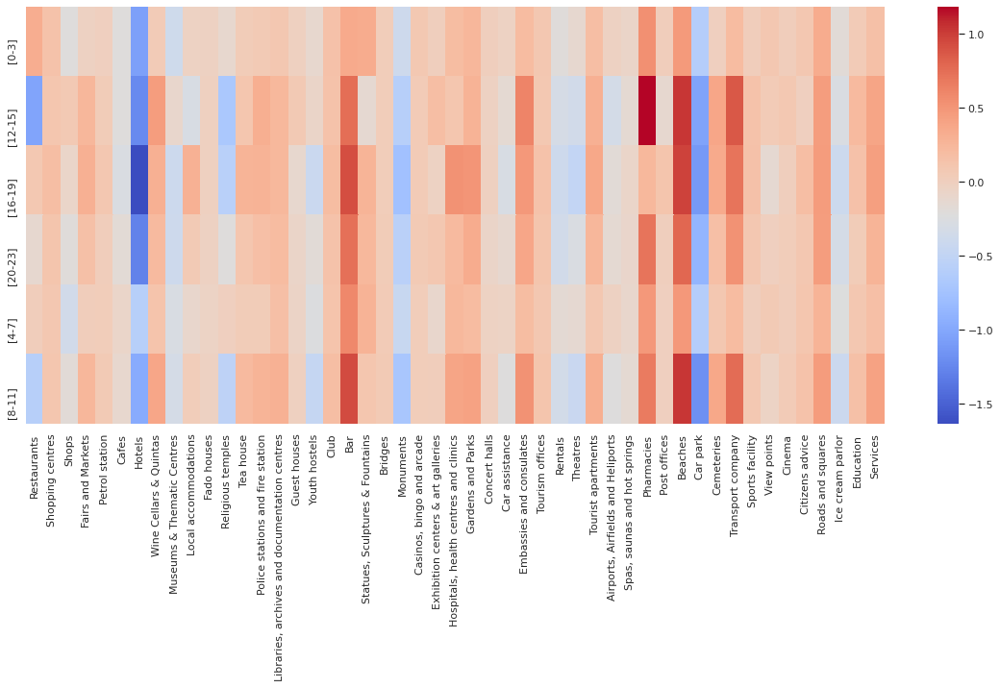

In [ ]:
#Finally, we visualize the results
import matplotlib.pyplot as plt
import numpy as np; np.random.seed(0)
import seaborn as sns; sns.set_theme()
plt.figure(figsize=(20, 8))
y_axis_labels = ['[0-3]', '[12-15]', '[16-19]', '[20-23]', '[4-7]', '[8-11]'] 
ax = sns.heatmap(regressionHeatmap_hours.iloc[:,1:], yticklabels=y_axis_labels, cmap='coolwarm')



# **Conclusions**

The objectives of this challenge were the following three: 

- Create a predictive model for traffic flow in the city of Porto for different periods of the day from sensor data;
- Explain which factors affect the traffic flow;
- Show any relationship and insights that exist between the different traffic flow in the city.

For the first objectvive we have built a seasonal arima model to predict traffic flow in the city. As the traffic is not the same for the whole city we have grouped streets that have similar flow and built a different model for each group in order to better represent and forecast the traffic. In this way we ensure that the predictions are more accurate. As for said predictions they have been calculated by hour, as we believe it better represents the increase and decrease of traffic intensity : traffic is definetely not the same in rush hour than in the midde of the afternoon. Two of our models perform a good forecast of the intensity and two others don't. Those than don't seem to predict in a good manner the changes in intensity but not the intensity level (it is lower that it should be). We believe this may be to due to the order of the sarima used, we have tried to use a function that iterates through orders and gives the one with less AIC but we have inssufficent computational capacity, even when using Oracle's free trial. In addition, another posible reason for the inaccurate results for the intensity values could be because 2 of the 4 clusters made 2 clear clusters since the variance inside each one was not too high. These clusters also were made out of most of the streets. The other 2 clusters were more spread out. This could be because the shape of the intensity over time is very different from one to the other (could be thought of as outliers in terms of shape)

As for the second and third objective, we have done an exhaustive analysis of variables that may affect traffic intensity, not only those provided in the challenge like weather conditions and POI's but we have included COVID incidence. This is better described in the section "Assesin dimensions impacting traffic-flow" but we have reached the conclusion that the main factor that affects traffic intensity in the POI's, followed by weather conditions (as can be seen in the folowing graph).

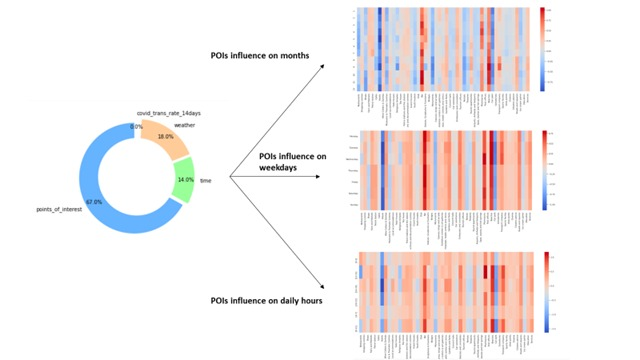


COVID doesn't seem to affect traffic but this is because the graph is for year 2021 between the months of January-April and Portugal has been on lock down since January due to COVID incidence. For this reason, changes in COVID incidence don't affect traffic flow as it has already afffected the situation in general. 

With all this information, we can predict hours when traffic intensity will be higher ad knowing the relationship with POI's , weather and COVID (all by hour) some measures could be implemented in order to reduce traffic. An example of a measure could be to increase public transportation services at hours where intensity is higher, thus reducing intensity and also reducing carbon footprint in general.



**Future Work**

The main step is to keep gathering data in order to better forecast. Also with newly acquired data we can compare how accurate our prediction was and keep improving our models or change them as reality changes. 